Menggabungkan Data Overview + Visualization + Data Preprocessing + Modeling

Version 1 : https://colab.research.google.com/drive/1y46NTvT-_4Awdotzk1Ayyx90dnp4cdW8#scrollTo=MLK15PZ6tvrq (Raw Project) <br>
Version 2 : **CURRENTLY HERE** (Exploring preprocessing + New algoritm) <br>
Version 3 : https://colab.research.google.com/drive/139vWgLk9Ll__R-qSvPPy4XOciJKoxi6l?authuser=2 (Explore with/without Feature engineering + Encoding)

# Import Data

In [134]:
!pip install kmodes
!pip install pySankey
!pip install pyspark

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 317.0/317.0 MB 2.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for pyspark: filename=pyspark-3.5.1-py2.py3-none-any.whl size=317488491 sha256=824a4e45022af36304181bde27d98d823f8b788d6d1b26986fee07910d0bc49c
  Stored in directory: /root/.cache/pip/wheels/80/1d/60/2c256ed38dddce2fdd93be545214a63e02fbd8d74fb0b7f3a6
Successfully built pyspark


In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns

from sklearn.linear_model import LinearRegression

import statsmodels.api as sm

%matplotlib inline

In [2]:
from sklearn.preprocessing import LabelEncoder , StandardScaler
from sklearn.impute import SimpleImputer
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from imblearn.over_sampling import RandomOverSampler

In [3]:
filepath = 'https://raw.githubusercontent.com/Pieter414/BCCInternProject/main/shopping_behavior_updated.csv'

data = pd.read_csv(filepath, delimiter=',')

In [4]:
data.to_csv('data.csv', index=False)

# Data Understanding

Tujuan Exploratory Data Analysis (EDA)


1. Memahami Data

2. Identifikasi Anomali

3. Identifikasi Pola dan Tren

4. Eksplorasi Hubungan

- Measure of Central Tendency: mean, median, modus
- Measure of Spread: variabilitas, varian, standar deviasi
- Measure of Distribution: skewness dan kurtosis

## Penjelasan Kolom

**About Dataset**

> Context:
The Consumer Behavior and Shopping Habits Dataset provides comprehensive insights into consumers' preferences, tendencies, and patterns during their shopping experiences. This dataset encompasses a diverse range of variables, including demographic information, purchase history, product preferences, shopping frequency, and online/offline shopping behavior. With this rich collection of data, analysts and researchers can delve into the intricacies of consumer decision-making processes, aiding businesses in crafting targeted marketing strategies, optimizing product offerings, and enhancing overall customer satisfaction. This dataset is essential for businesses aiming to tailor their strategies to meet customer needs and enhance their shopping experience, ultimately driving sales and loyalty.

**Dataset Glossary (Column-wise)**

> `Customer ID`: A unique identifier assigned to each individual customer, facilitating tracking and analysis of their shopping behavior over time.

> `Age`: The age of the customer, providing demographic information for segmentation and targeted marketing strategies.

> `Gender`: The gender identification of the customer, a key demographic variable influencing product preferences and purchasing patterns.

> `Item Purchased`: The specific product or item selected by the customer during the transaction.

> `Category`: The broad classification or group to which the purchased item belongs (e.g., clothing, electronics, groceries).

> `Purchase Amount (USD)`: The monetary value of the transaction, denoted in United States Dollars (USD), indicates the cost of the purchased item(s).

> `Location`: The geographical location where the purchase was made, offering insights into regional preferences and market trends.

> `Size`: The size specification (if applicable) of the purchased item, relevant for apparel, footwear, and certain consumer goods.

> `Color`: The color variant or choice associated with the purchased item, influencing customer preferences and product availability.

> `Season`: The seasonal relevance of the purchased item (e.g., spring, summer, fall, winter), impacting inventory management and marketing strategies.

> `Review Rating`: A numerical or qualitative assessment provided by the customer regarding their satisfaction with the purchased item.

> `Subscription Status`: Indicates whether the customer has opted for a subscription service, offering insights into their level of loyalty and potential for recurring revenue.

> `Shipping Type`: Specifies the method used to deliver the purchased item (e.g., standard shipping, express delivery), influencing delivery times and costs.

> `Discount Applied`: Indicates if any promotional discounts were applied to the purchase, shedding light on price sensitivity and promotion effectiveness.

> `Promo Code Used`: Notes whether a promotional code or coupon was utilized during the transaction, aiding in the evaluation of marketing campaign success.

> `Previous Purchases`: Provides information on the number or frequency of prior purchases made by the customer, contributing to customer segmentation and retention strategies.

> `Payment Method`: Specifies the mode of payment employed by the customer (e.g., credit card, cash), offering insights into preferred payment options.

> `Frequency of Purchases`: Indicates how often the customer engages in purchasing activities, a critical metric for assessing customer loyalty and lifetime value.

## Data overview

In [5]:
data.head(10)

,Customer ID,Age,Gender,Item Purchased,Category,Purchase Amount (USD),Location,Size,Color,Season,Review Rating,Subscription Status,Shipping Type,Discount Applied,Promo Code Used,Previous Purchases,Payment Method,Frequency of Purchases
0,1,55,Male,Blouse,Clothing,53,Kentucky,L,Gray,Winter,3.1,Yes,Express,Yes,Yes,14,Venmo,Fortnightly
1,2,19,Male,Sweater,Clothing,64,Maine,L,Maroon,Winter,3.1,Yes,Express,Yes,Yes,2,Cash,Fortnightly
2,3,50,Male,Jeans,Clothing,73,Massachusetts,S,Maroon,Spring,3.1,Yes,Free Shipping,Yes,Yes,23,Credit Card,Weekly
3,4,21,Male,Sandals,Footwear,90,Rhode Island,M,Maroon,Spring,3.5,Yes,Next Day Air,Yes,Yes,49,PayPal,Weekly
4,5,45,Male,Blouse,Clothing,49,Oregon,M,Turquoise,Spring,2.7,Yes,Free Shipping,Yes,Yes,31,PayPal,Annually
5,6,46,Male,Sneakers,Footwear,20,Wyoming,M,White,Summer,2.9,Yes,Standard,Yes,Yes,14,Venmo,Weekly
6,7,63,Male,Shirt,Clothing,85,Montana,M,Gray,Fall,3.2,Yes,Free Shipping,Yes,Yes,49,Cash,Quarterly
7,8,27,Male,Shorts,Clothing,34,Louisiana,L,Charcoal,Winter,3.2,Yes,Free Shipping,Yes,Yes,19,Credit Card,Weekly
8,9,26,Male,Coat,Outerwear,97,West Virginia,L,Silver,Summer,2.6,Yes,Express,Yes,Yes,8,Venmo,Annually
9,10,57,Male,Handbag,Accessories,31,Missouri,M,Pink,Spring,4.8,Yes,2-Day Shipping,Yes,Yes,4,Cash,Quarterly


In [6]:
data.tail(10)

,Customer ID,Age,Gender,Item Purchased,Category,Purchase Amount (USD),Location,Size,Color,Season,Review Rating,Subscription Status,Shipping Type,Discount Applied,Promo Code Used,Previous Purchases,Payment Method,Frequency of Purchases
3890,3891,35,Female,Shirt,Clothing,81,Nebraska,XL,Green,Winter,2.6,No,Standard,No,No,33,Debit Card,Annually
3891,3892,36,Female,Dress,Clothing,30,Colorado,L,Peach,Winter,4.7,No,Free Shipping,No,No,6,Bank Transfer,Quarterly
3892,3893,35,Female,Jewelry,Accessories,86,Michigan,L,Indigo,Summer,3.5,No,Standard,No,No,5,PayPal,Fortnightly
3893,3894,21,Female,Hat,Accessories,64,Massachusetts,L,White,Fall,3.3,No,Store Pickup,No,No,29,Bank Transfer,Bi-Weekly
3894,3895,66,Female,Skirt,Clothing,78,Connecticut,L,White,Spring,3.9,No,2-Day Shipping,No,No,44,Credit Card,Every 3 Months
3895,3896,40,Female,Hoodie,Clothing,28,Virginia,L,Turquoise,Summer,4.2,No,2-Day Shipping,No,No,32,Venmo,Weekly
3896,3897,52,Female,Backpack,Accessories,49,Iowa,L,White,Spring,4.5,No,Store Pickup,No,No,41,Bank Transfer,Bi-Weekly
3897,3898,46,Female,Belt,Accessories,33,New Jersey,L,Green,Spring,2.9,No,Standard,No,No,24,Venmo,Quarterly
3898,3899,44,Female,Shoes,Footwear,77,Minnesota,S,Brown,Summer,3.8,No,Express,No,No,24,Venmo,Weekly
3899,3900,52,Female,Handbag,Accessories,81,California,M,Beige,Spring,3.1,No,Store Pickup,No,No,33,Venmo,Quarterly


In [7]:
data.shape

(3900, 18)

In [8]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3900 entries, 0 to 3899
Data columns (total 18 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Customer ID             3900 non-null   int64  
 1   Age                     3900 non-null   int64  
 2   Gender                  3900 non-null   object 
 3   Item Purchased          3900 non-null   object 
 4   Category                3900 non-null   object 
 5   Purchase Amount (USD)   3900 non-null   int64  
 6   Location                3900 non-null   object 
 7   Size                    3900 non-null   object 
 8   Color                   3900 non-null   object 
 9   Season                  3900 non-null   object 
 10  Review Rating           3900 non-null   float64
 11  Subscription Status     3900 non-null   object 
 12  Shipping Type           3900 non-null   object 
 13  Discount Applied        3900 non-null   object 
 14  Promo Code Used         3900 non-null   

In [9]:
data.describe()

,Customer ID,Age,Purchase Amount (USD),Review Rating,Previous Purchases
count,3900.000000,3900.000000,3900.000000,3900.000000,3900.000000
mean,1950.500000,44.068462,59.764359,3.749949,25.351538
std,1125.977353,15.207589,23.685392,0.716223,14.447125
min,1.000000,18.000000,20.000000,2.500000,1.000000
25%,975.750000,31.000000,39.000000,3.100000,13.000000
50%,1950.500000,44.000000,60.000000,3.700000,25.000000
75%,2925.250000,57.000000,81.000000,4.400000,38.000000
max,3900.000000,70.000000,100.000000,5.000000,50.000000


In [10]:
data.describe(include="all")

,Customer ID,Age,Gender,Item Purchased,Category,Purchase Amount (USD),Location,Size,Color,Season,Review Rating,Subscription Status,Shipping Type,Discount Applied,Promo Code Used,Previous Purchases,Payment Method,Frequency of Purchases
count,3900.000000,3900.000000,3900,3900,3900,3900.000000,3900,3900,3900,3900,3900.000000,3900,3900,3900,3900,3900.000000,3900,3900
unique,NaN,NaN,2,25,4,NaN,50,4,25,4,NaN,2,6,2,2,NaN,6,7
top,NaN,NaN,Male,Blouse,Clothing,NaN,Montana,M,Olive,Spring,NaN,No,Free Shipping,No,No,NaN,PayPal,Every 3 Months
freq,NaN,NaN,2652,171,1737,NaN,96,1755,177,999,NaN,2847,675,2223,2223,NaN,677,584
mean,1950.500000,44.068462,NaN,NaN,NaN,59.764359,NaN,NaN,NaN,NaN,3.749949,NaN,NaN,NaN,NaN,25.351538,NaN,NaN
std,1125.977353,15.207589,NaN,NaN,NaN,23.685392,NaN,NaN,NaN,NaN,0.716223,NaN,NaN,NaN,NaN,14.447125,NaN,NaN
min,1.000000,18.000000,NaN,NaN,NaN,20.000000,NaN,NaN,NaN,NaN,2.500000,NaN,NaN,NaN,NaN,1.000000,NaN,NaN
25%,975.750000,31.000000,NaN,NaN,NaN,39.000000,NaN,NaN,NaN,NaN,3.100000,NaN,NaN,NaN,NaN,13.000000,NaN,NaN
50%,1950.500000,44.000000,NaN,NaN,NaN,60.000000,NaN,NaN,NaN,NaN,3.700000,NaN,NaN,NaN,NaN,25.000000,NaN,NaN
75%,2925.250000,57.000000,NaN,NaN,NaN,81.000000,NaN,NaN,NaN,NaN,4.400000,NaN,NaN,NaN,NaN,38.000000,NaN,NaN


In [11]:
data.isna().sum()

Customer ID               0
Age                       0
Gender                    0
Item Purchased            0
Category                  0
Purchase Amount (USD)     0
Location                  0
Size                      0
Color                     0
Season                    0
Review Rating             0
Subscription Status       0
Shipping Type             0
Discount Applied          0
Promo Code Used           0
Previous Purchases        0
Payment Method            0
Frequency of Purchases    0
dtype: int64

## Analisis Value Counts (Persebaran Data)

Pertama, ambil terlebih dahulu semua kolom object

In [12]:
def show_value_count(data, label):
  value_count = data[label].value_counts()

  print(f"\nPersebaran dari kolom {label}: \n{value_count}")

In [13]:
column_types = data.dtypes
object_columns = column_types[column_types == 'object'].index.tolist()

object_columns

['Gender',
 'Item Purchased',
 'Category',
 'Location',
 'Size',
 'Color',
 'Season',
 'Subscription Status',
 'Shipping Type',
 'Discount Applied',
 'Promo Code Used',
 'Payment Method',
 'Frequency of Purchases']

In [14]:
integer_columns = column_types[column_types == 'int64'].index.tolist()
integer_columns

['Customer ID', 'Age', 'Purchase Amount (USD)', 'Previous Purchases']

In [15]:
float_columns = column_types[column_types == 'float64'].index.tolist()
float_columns

['Review Rating']

In [16]:
show_value_count(data, 'Item Purchased')


Persebaran dari kolom Item Purchased: 
Blouse        171
Jewelry       171
Pants         171
Shirt         169
Dress         166
Sweater       164
Jacket        163
Belt          161
Sunglasses    161
Coat          161
Sandals       160
Socks         159
Skirt         158
Shorts        157
Scarf         157
Hat           154
Handbag       153
Hoodie        151
Shoes         150
T-shirt       147
Sneakers      145
Boots         144
Backpack      143
Gloves        140
Jeans         124
Name: Item Purchased, dtype: int64


In [17]:
for column in object_columns:
  show_value_count(data, column)


Persebaran dari kolom Gender: 
Male      2652
Female    1248
Name: Gender, dtype: int64

Persebaran dari kolom Item Purchased: 
Blouse        171
Jewelry       171
Pants         171
Shirt         169
Dress         166
Sweater       164
Jacket        163
Belt          161
Sunglasses    161
Coat          161
Sandals       160
Socks         159
Skirt         158
Shorts        157
Scarf         157
Hat           154
Handbag       153
Hoodie        151
Shoes         150
T-shirt       147
Sneakers      145
Boots         144
Backpack      143
Gloves        140
Jeans         124
Name: Item Purchased, dtype: int64

Persebaran dari kolom Category: 
Clothing       1737
Accessories    1240
Footwear        599
Outerwear       324
Name: Category, dtype: int64

Persebaran dari kolom Location: 
Montana           96
California        95
Idaho             93
Illinois          92
Alabama           89
Minnesota         88
Nebraska          87
New York          87
Nevada            87
Maryland          86

In [18]:
for column in float_columns:
  show_value_count(data, column)


Persebaran dari kolom Review Rating: 
3.4    182
4.0    181
4.6    174
4.2    171
2.9    170
4.9    166
3.9    163
3.0    162
2.6    159
4.4    158
3.1    157
3.7    156
3.5    156
2.7    154
3.3    152
3.2    152
3.6    149
4.7    148
4.1    148
4.3    147
4.8    144
3.8    142
4.5    139
2.8    136
5.0     68
2.5     66
Name: Review Rating, dtype: int64


In [19]:
for column in integer_columns:
  show_value_count(data, column)


Persebaran dari kolom Customer ID: 
1       1
2621    1
2593    1
2594    1
2595    1
       ..
1305    1
1306    1
1307    1
1308    1
3900    1
Name: Customer ID, Length: 3900, dtype: int64

Persebaran dari kolom Age: 
69    88
57    87
41    86
25    85
49    84
50    83
54    83
27    83
62    83
32    82
19    81
58    81
42    80
43    79
28    79
31    79
37    77
46    76
29    76
68    75
59    75
63    75
56    74
36    74
55    73
52    73
64    73
35    72
51    72
65    72
40    72
45    72
47    71
66    71
30    71
23    71
38    70
53    70
18    69
21    69
26    69
34    68
48    68
24    68
39    68
70    67
22    66
61    65
60    65
33    63
20    62
67    54
44    51
Name: Age, dtype: int64

Persebaran dari kolom Purchase Amount (USD): 
94     62
32     62
36     62
51     61
90     60
       ..
100    36
87     35
49     35
69     34
61     33
Name: Purchase Amount (USD), Length: 81, dtype: int64

Persebaran dari kolom Previous Purchases: 
31    97
21    96
14  

## Missing Values

In [20]:
data.isna().sum()

Customer ID               0
Age                       0
Gender                    0
Item Purchased            0
Category                  0
Purchase Amount (USD)     0
Location                  0
Size                      0
Color                     0
Season                    0
Review Rating             0
Subscription Status       0
Shipping Type             0
Discount Applied          0
Promo Code Used           0
Previous Purchases        0
Payment Method            0
Frequency of Purchases    0
dtype: int64

Disimpulkan bahwa dataset ini tidak memiliki missing value di kolom manapun

## Duplicated values

In [21]:
data.duplicated().sum()

0

In [22]:
duplicate_without_id = (data.drop(columns=["Customer ID"]))
duplicate_without_id.duplicated().sum()

0

In [23]:
data[data.duplicated()]

,Customer ID,Age,Gender,Item Purchased,Category,Purchase Amount (USD),Location,Size,Color,Season,Review Rating,Subscription Status,Shipping Type,Discount Applied,Promo Code Used,Previous Purchases,Payment Method,Frequency of Purchases


In [24]:
duplicate_without_id[duplicate_without_id.duplicated()]

,Age,Gender,Item Purchased,Category,Purchase Amount (USD),Location,Size,Color,Season,Review Rating,Subscription Status,Shipping Type,Discount Applied,Promo Code Used,Previous Purchases,Payment Method,Frequency of Purchases


Dari diatas, ditemukan bahwa tidak ada data yang duplikat. Bahkan setelah mengecek data tanpa Customer ID, ditemukan tidak ada duplikat

# Business Question / Insight

SMART Method

- Specific
- Measurable
- Action Oriented
- Relevant
- Time Bound

Business Insights

1. Spesific :
2. Measurable :
3. Action Oriented
4. Relevant :
5. Time Bound : This project final presentation are in 23 March 2024

Business Questions:

1. Bagaimana customer habits and behavior berdasarkan wilayah regional mereka (Dalam Amerika Serikat)
2. Bagaimana sifat mereka dengan pengelompokan umur
3. Seberapa baik dalam melakukan clustering (pengelompokan) dengan Feature Selection

# Pre Visualization and Analysis

Creating numerical data, categorical data and creating new column that maybe be usefull

## Num Data

In [25]:
num_data = data.filter(integer_columns+float_columns).drop("Customer ID", axis=1)
num_data.head()

,Age,Purchase Amount (USD),Previous Purchases,Review Rating
0,55,53,14,3.1
1,19,64,2,3.1
2,50,73,23,3.1
3,21,90,49,3.5
4,45,49,31,2.7


## Region Grouping

In [26]:
regions = {
    'New England': ['Connecticut', 'Maine', 'Massachusetts', 'New Hampshire', 'Rhode Island', 'Vermont'],
    'Mideast': ['Delaware', 'District of Columbia', 'Maryland', 'New Jersey', 'New York', 'Pennsylvania'],
    'Great Lakes': ['Illinois', 'Indiana', 'Michigan', 'Ohio', 'Wisconsin'],
    'Plains': ['Iowa', 'Kansas', 'Minnesota', 'Missouri', 'Nebraska', 'North Dakota', 'South Dakota'],
    'Southeast': ['Alabama', 'Arkansas', 'Florida', 'Georgia', 'Kentucky', 'Louisiana', 'Mississippi', 'North Carolina', 'South Carolina', 'Tennessee', 'Virginia', 'West Virginia'],
    'Southwest': ['Arizona', 'New Mexico', 'Oklahoma', 'Texas'],
    'Rocky Mountain': ['Colorado', 'Idaho', 'Montana', 'Utah', 'Wyoming'],
    'Far West': ['Alaska', 'California', 'Hawaii', 'Nevada', 'Oregon', 'Washington']
}

In [27]:
# Fungsi untuk menentukan region
def get_region(state):
    for region, states in regions.items():
        if state in states:
            return region
    return 'Unknown'

In [28]:
# Menambahkan kolom region ke dataframe
data['Region'] = data['Location'].apply(get_region)

data.head()

,Customer ID,Age,Gender,Item Purchased,Category,Purchase Amount (USD),Location,Size,Color,Season,Review Rating,Subscription Status,Shipping Type,Discount Applied,Promo Code Used,Previous Purchases,Payment Method,Frequency of Purchases,Region
0,1,55,Male,Blouse,Clothing,53,Kentucky,L,Gray,Winter,3.1,Yes,Express,Yes,Yes,14,Venmo,Fortnightly,Southeast
1,2,19,Male,Sweater,Clothing,64,Maine,L,Maroon,Winter,3.1,Yes,Express,Yes,Yes,2,Cash,Fortnightly,New England
2,3,50,Male,Jeans,Clothing,73,Massachusetts,S,Maroon,Spring,3.1,Yes,Free Shipping,Yes,Yes,23,Credit Card,Weekly,New England
3,4,21,Male,Sandals,Footwear,90,Rhode Island,M,Maroon,Spring,3.5,Yes,Next Day Air,Yes,Yes,49,PayPal,Weekly,New England
4,5,45,Male,Blouse,Clothing,49,Oregon,M,Turquoise,Spring,2.7,Yes,Free Shipping,Yes,Yes,31,PayPal,Annually,Far West


In [29]:
data.to_csv('data.csv', index=False)

In [30]:
data["Region"].value_counts()

Southeast         947
Plains            541
Far West          466
New England       446
Rocky Mountain    406
Mideast           400
Great Lakes       396
Southwest         298
Name: Region, dtype: int64

In [31]:
column_types = data.dtypes
object_columns = column_types[column_types == 'object'].index.tolist()

object_columns

['Gender',
 'Item Purchased',
 'Category',
 'Location',
 'Size',
 'Color',
 'Season',
 'Subscription Status',
 'Shipping Type',
 'Discount Applied',
 'Promo Code Used',
 'Payment Method',
 'Frequency of Purchases',
 'Region']

In [32]:
category_data = data.filter(object_columns)
category_data.head()

,Gender,Item Purchased,Category,Location,Size,Color,Season,Subscription Status,Shipping Type,Discount Applied,Promo Code Used,Payment Method,Frequency of Purchases,Region
0,Male,Blouse,Clothing,Kentucky,L,Gray,Winter,Yes,Express,Yes,Yes,Venmo,Fortnightly,Southeast
1,Male,Sweater,Clothing,Maine,L,Maroon,Winter,Yes,Express,Yes,Yes,Cash,Fortnightly,New England
2,Male,Jeans,Clothing,Massachusetts,S,Maroon,Spring,Yes,Free Shipping,Yes,Yes,Credit Card,Weekly,New England
3,Male,Sandals,Footwear,Rhode Island,M,Maroon,Spring,Yes,Next Day Air,Yes,Yes,PayPal,Weekly,New England
4,Male,Blouse,Clothing,Oregon,M,Turquoise,Spring,Yes,Free Shipping,Yes,Yes,PayPal,Annually,Far West


## Age Grouping

In [33]:
# Define a function to classify age groups
def classify_age_group(age):
  if age <= 19:
      return 'Teenager'
  elif 20 <= age <= 30:
      return 'Young_Adult'
  elif 31 <= age <= 44:
      return 'Adult'
  elif 45 <= age <= 59:
      return 'Middle_Age'
  else:
      return 'Elder'

data['Age Group'] = data['Age'].apply(classify_age_group)

In [34]:
data['Age Group'].value_counts()

Middle_Age     1142
Adult          1021
Young_Adult     799
Elder           788
Teenager        150
Name: Age Group, dtype: int64

## Generation Grouping

In [35]:
# Define a function to classify age groups
def classify_birth_year_group(age):
  birth_year = 2024 - age
  if birth_year >= 2013:
      return 'Gen_Alpha'
  elif 1995 <= birth_year <= 2012:
      return 'Gen_Z'
  elif 1980 <= birth_year <= 1994:
      return 'Millenials'
  elif 1965 <= birth_year <= 1979:
      return 'Gen_X'
  else:
      return 'Baby_Boomer'

# data['Generation'] = data['Age'].apply(classify_birth_year_group)

In [36]:
# data['Generation'].value_counts()

## Column Update

In [37]:
column_types = data.dtypes
object_columns = column_types[column_types == 'object'].index.tolist()

object_columns

['Gender',
 'Item Purchased',
 'Category',
 'Location',
 'Size',
 'Color',
 'Season',
 'Subscription Status',
 'Shipping Type',
 'Discount Applied',
 'Promo Code Used',
 'Payment Method',
 'Frequency of Purchases',
 'Region',
 'Age Group']

In [38]:
integer_columns = column_types[column_types == 'int64'].index.tolist()
integer_columns

['Customer ID', 'Age', 'Purchase Amount (USD)', 'Previous Purchases']

In [39]:
float_columns = column_types[column_types == 'float64'].index.tolist()
float_columns

['Review Rating']

In [40]:
data.head()

,Customer ID,Age,Gender,Item Purchased,Category,Purchase Amount (USD),Location,Size,Color,Season,Review Rating,Subscription Status,Shipping Type,Discount Applied,Promo Code Used,Previous Purchases,Payment Method,Frequency of Purchases,Region,Age Group
0,1,55,Male,Blouse,Clothing,53,Kentucky,L,Gray,Winter,3.1,Yes,Express,Yes,Yes,14,Venmo,Fortnightly,Southeast,Middle_Age
1,2,19,Male,Sweater,Clothing,64,Maine,L,Maroon,Winter,3.1,Yes,Express,Yes,Yes,2,Cash,Fortnightly,New England,Teenager
2,3,50,Male,Jeans,Clothing,73,Massachusetts,S,Maroon,Spring,3.1,Yes,Free Shipping,Yes,Yes,23,Credit Card,Weekly,New England,Middle_Age
3,4,21,Male,Sandals,Footwear,90,Rhode Island,M,Maroon,Spring,3.5,Yes,Next Day Air,Yes,Yes,49,PayPal,Weekly,New England,Young_Adult
4,5,45,Male,Blouse,Clothing,49,Oregon,M,Turquoise,Spring,2.7,Yes,Free Shipping,Yes,Yes,31,PayPal,Annually,Far West,Middle_Age


# EDA (Explorative Data Analysis)

## Mengecek kolom numerik akan outlier, median, kuartil dan lainnya (Box plot)

In [ ]:
def boxplot_of_purchase(obj_column, int_column="Purchase Amount (USD)", title=""):
  plt.figure(figsize=(12, 8))
  sns.set(style="darkgrid")
  ax = sns.boxplot(y=obj_column, x=int_column, data=data, palette="Set1")
  plt.title(title, fontsize=16)
  plt.show()

<ipython-input-102-27f8dd03a35d>:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.boxplot(y=obj_column, x=int_column, data=data, palette="Set1")


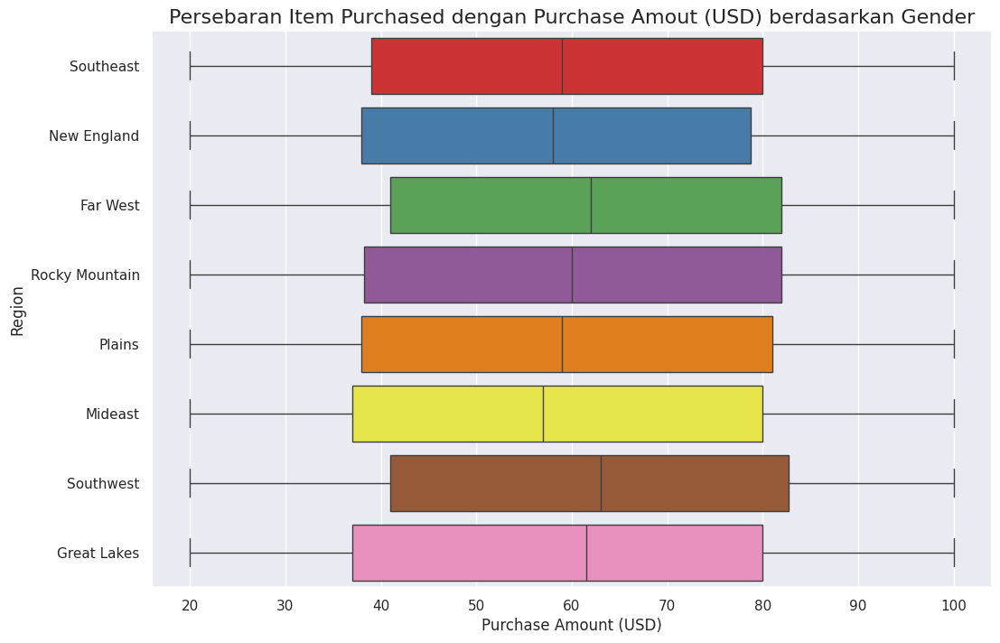

In [ ]:
for column in ["Region"]:
  boxplot_of_purchase(column, title="Persebaran Item Purchased dengan Purchase Amout (USD) berdasarkan Gender")

<ipython-input-102-27f8dd03a35d>:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.boxplot(y=obj_column, x=int_column, data=data, palette="Set1")


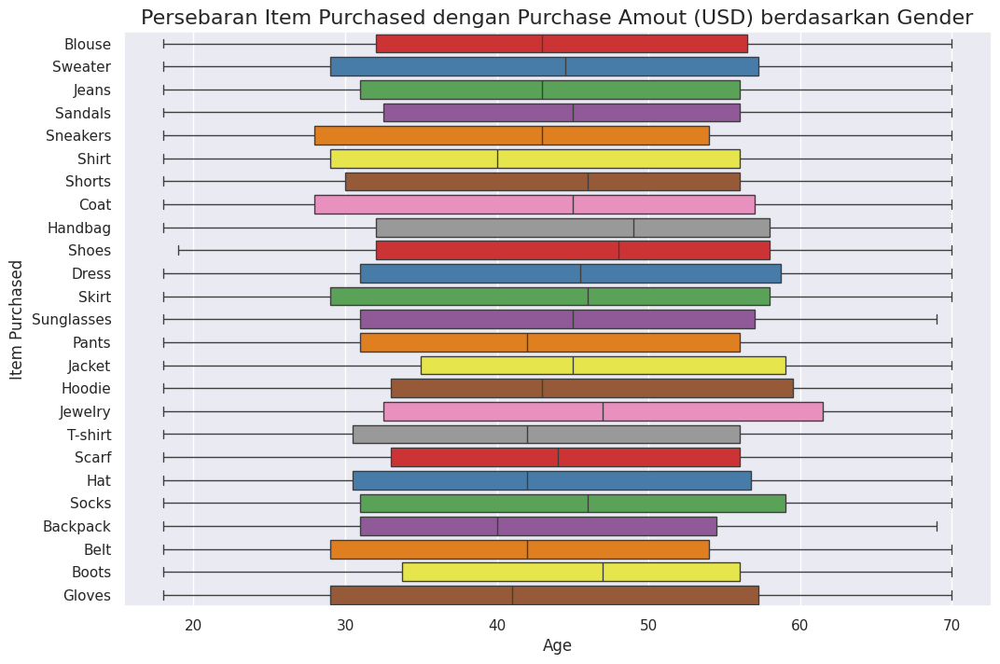

In [ ]:
for column in ["Item Purchased"]:
  boxplot_of_purchase(column, "Age", title="Persebaran Item Purchased dengan Purchase Amout (USD) berdasarkan Gender")

<ipython-input-102-27f8dd03a35d>:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.boxplot(y=obj_column, x=int_column, data=data, palette="Set1")


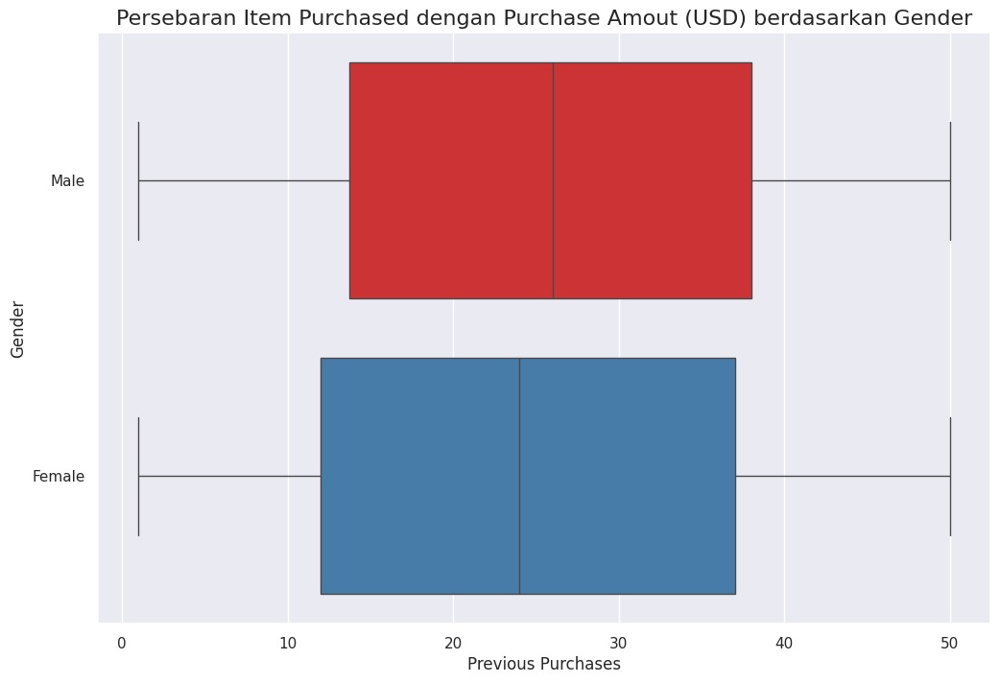

In [ ]:
for column in ["Gender"]:
  boxplot_of_purchase(column, "Previous Purchases", title="Persebaran Item Purchased dengan Purchase Amout (USD) berdasarkan Gender")

## Distribusi kolom numerik yang diklasifikasi berdasarkan Gender (Histogram)

<ipython-input-45-2421cc288340>:6: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data=data, x=column, bins=20, kde=True, palette="Palette1")


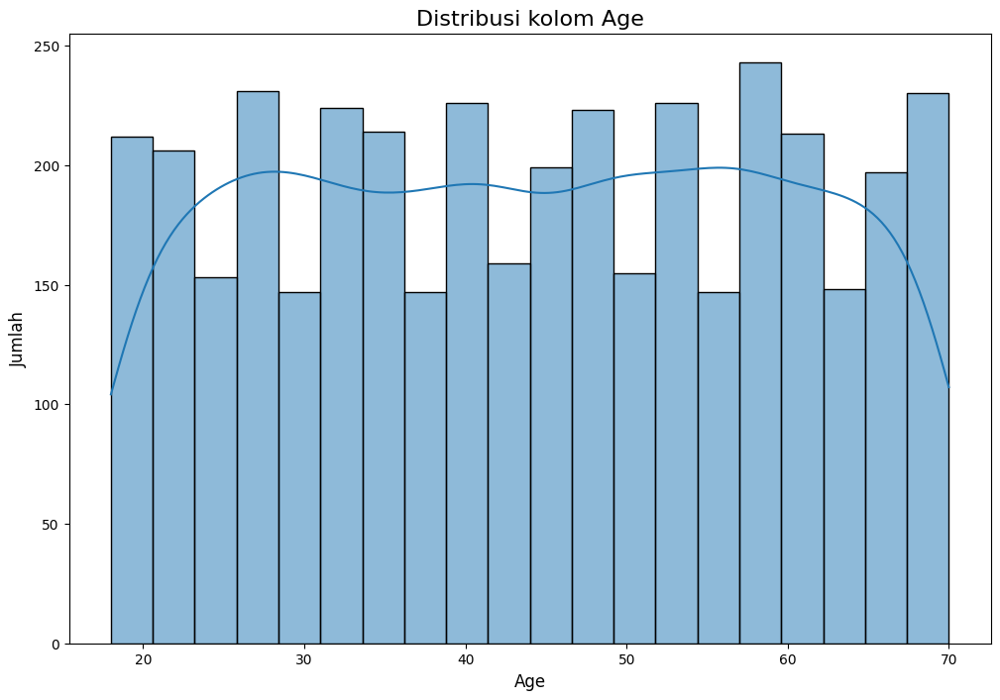

<ipython-input-45-2421cc288340>:6: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data=data, x=column, bins=20, kde=True, palette="Palette1")


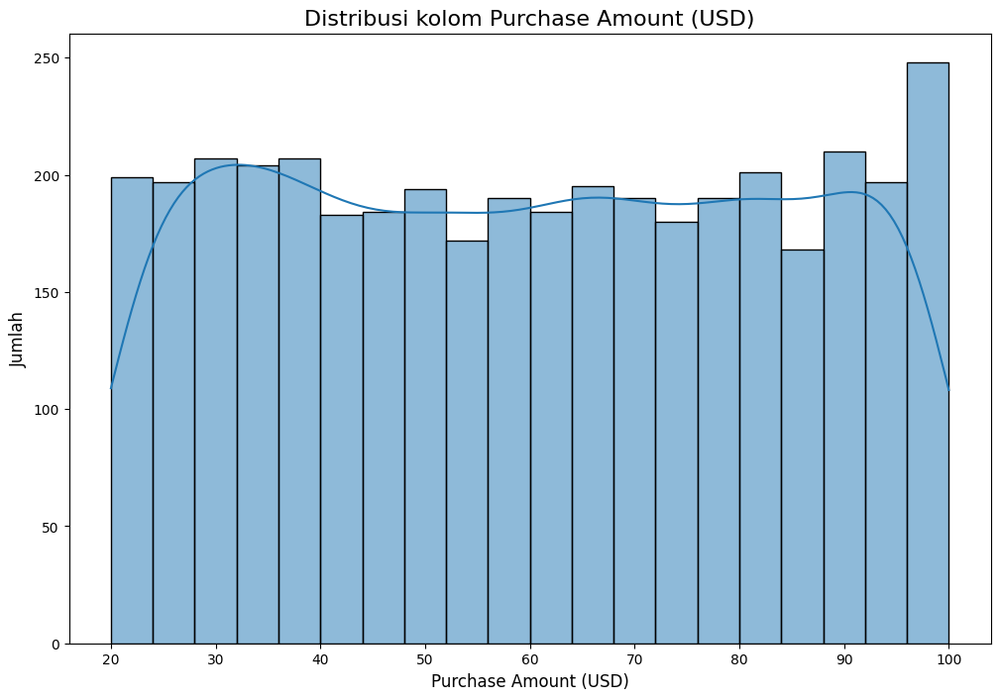

<ipython-input-45-2421cc288340>:6: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data=data, x=column, bins=20, kde=True, palette="Palette1")


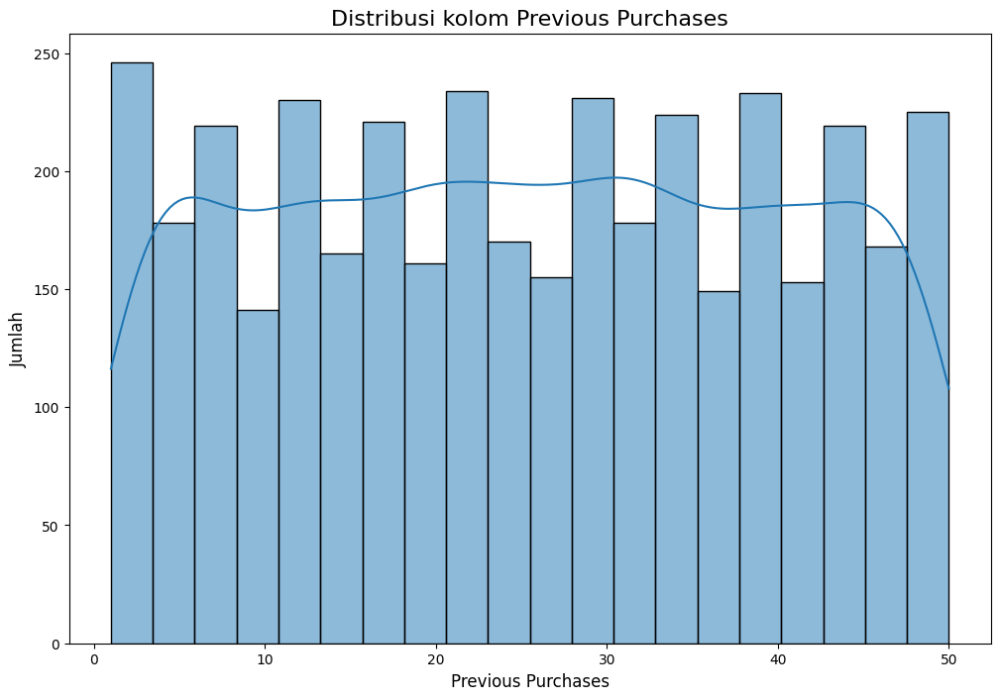

<ipython-input-45-2421cc288340>:6: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data=data, x=column, bins=20, kde=True, palette="Palette1")


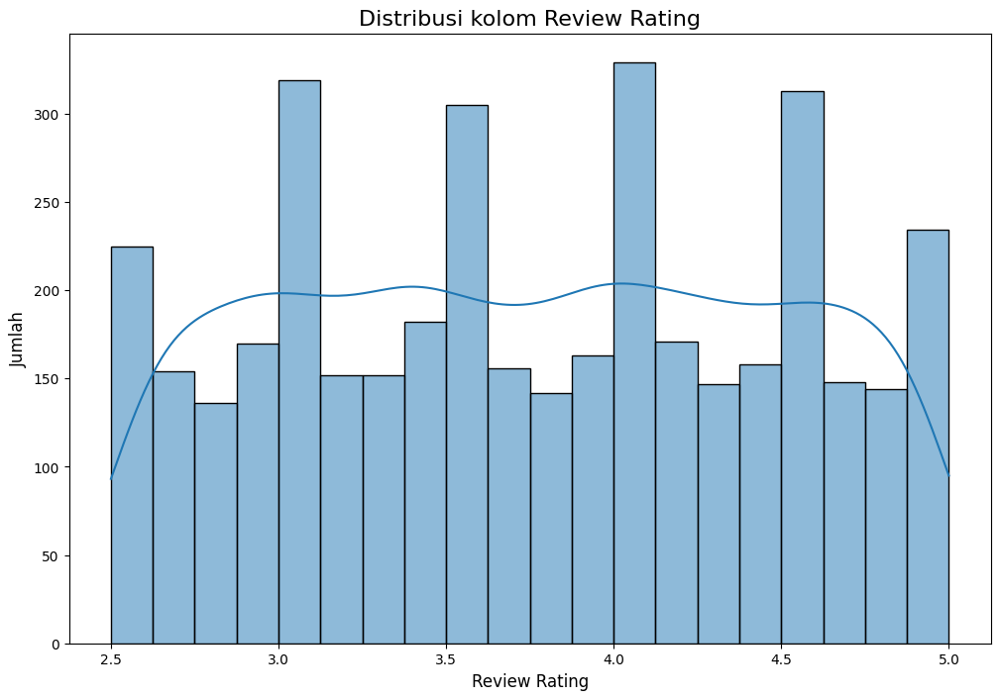

In [45]:
for column in num_data:
  if column == "Customer ID":
    continue
  plt.figure(figsize=(12, 8))
  plt.title(f"Distribusi kolom {column}", fontsize=16)
  sns.histplot(data=data, x=column, bins=20, kde=True, palette="Palette1")
  plt.xlabel(column, fontsize=12)
  plt.ylabel("Jumlah", fontsize=12)
  plt.show()

array([[<Axes: title={'center': 'Customer ID'}>,
        <Axes: title={'center': 'Age'}>],
       [<Axes: title={'center': 'Purchase Amount (USD)'}>,
        <Axes: title={'center': 'Previous Purchases'}>],
       [<Axes: title={'center': 'Review Rating'}>, <Axes: >]],
      dtype=object)

<Figure size 1200x800 with 0 Axes>

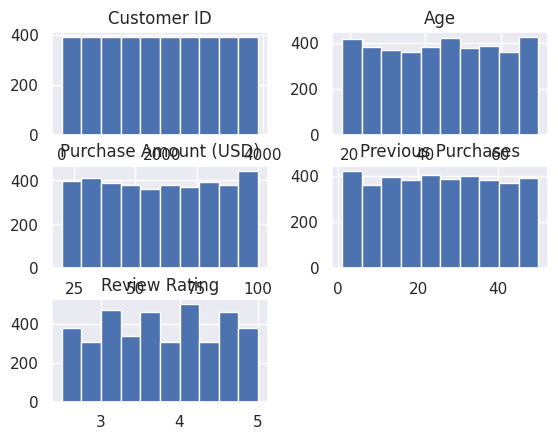

In [ ]:
plt.figure(figsize=(12, 8))
num_data.hist()

## Bagaimana korelasi antar kolom numerik (dan kolom boolean) satu sama lain (Heatmap)

<ipython-input-108-0962401c555b>:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(data.corr(), annot=True);


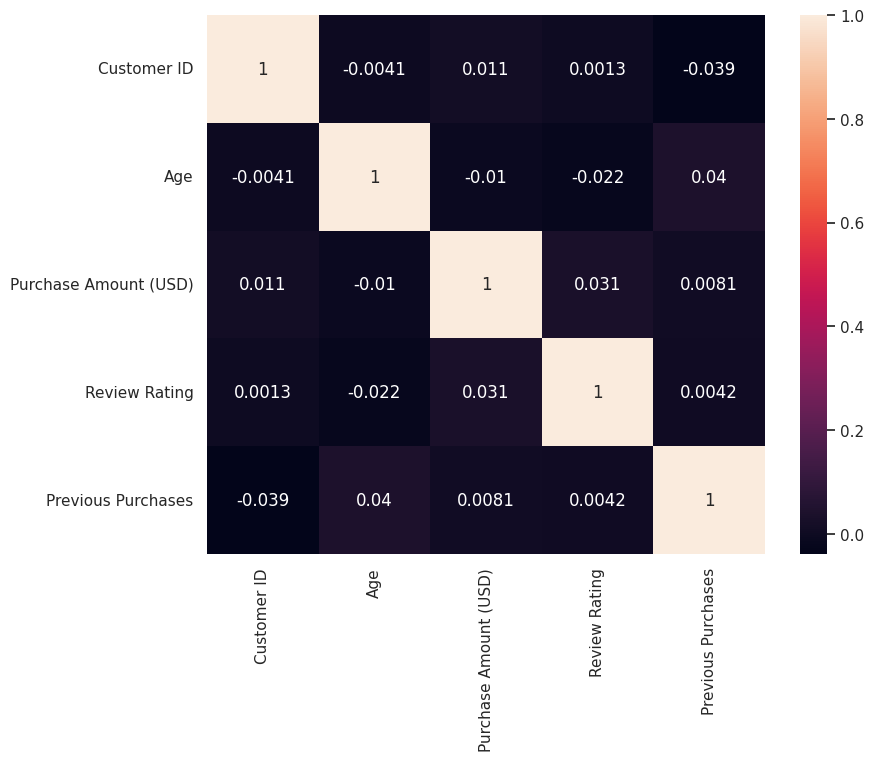

In [ ]:
plt.figure(figsize=(9,7))
sns.heatmap(data.corr(), annot=True);
plt.show()

In [ ]:
new_data = data.copy()

In [ ]:
gender_mapping = {"Male":1, "Female":0}
new_data["Gender"] = new_data["Gender"].map(gender_mapping)

In [ ]:
yes_mapping = {"Yes":1, "No":0}
new_data["Promo Code Used"] = new_data["Promo Code Used"].map(yes_mapping)
new_data["Discount Applied"] = new_data["Discount Applied"].map(yes_mapping)
new_data["Subscription Status"] = new_data["Subscription Status"].map(yes_mapping)

<ipython-input-112-1f739fb468ba>:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(new_data.corr(), annot=True);


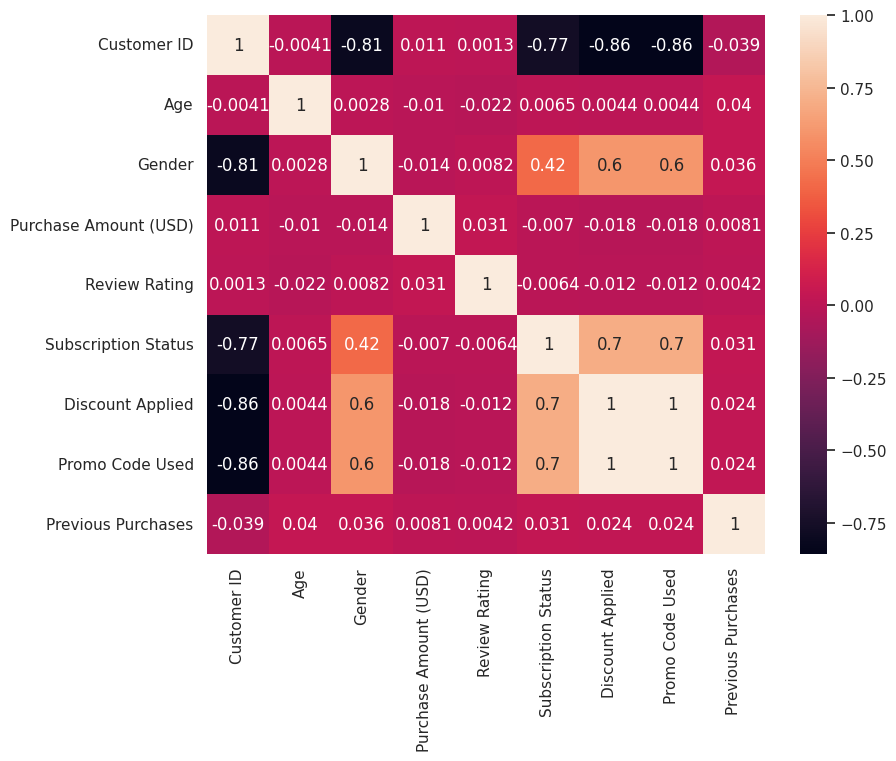

In [ ]:
plt.figure(figsize=(9,7))
sns.heatmap(new_data.corr(), annot=True);
plt.show()

## Bagaimana persebaran customer behavior dan habits (Count Plot)

<ipython-input-113-80280315fdcb>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(y=column, data=data, order=sorted_data[column], palette="Set1")


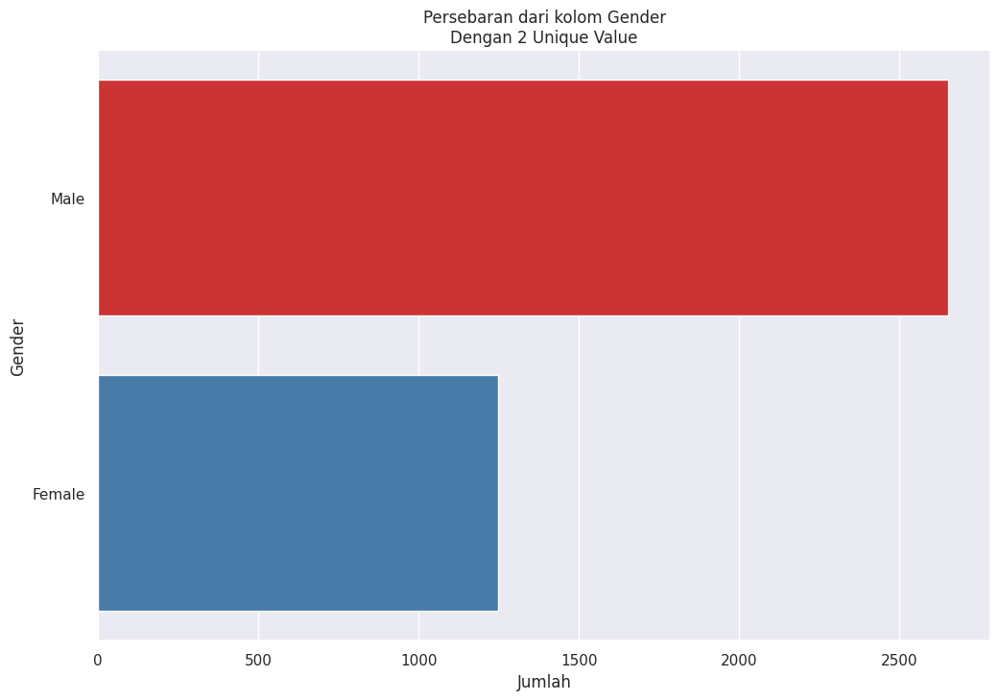

<ipython-input-113-80280315fdcb>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(y=column, data=data, order=sorted_data[column], palette="Set1")


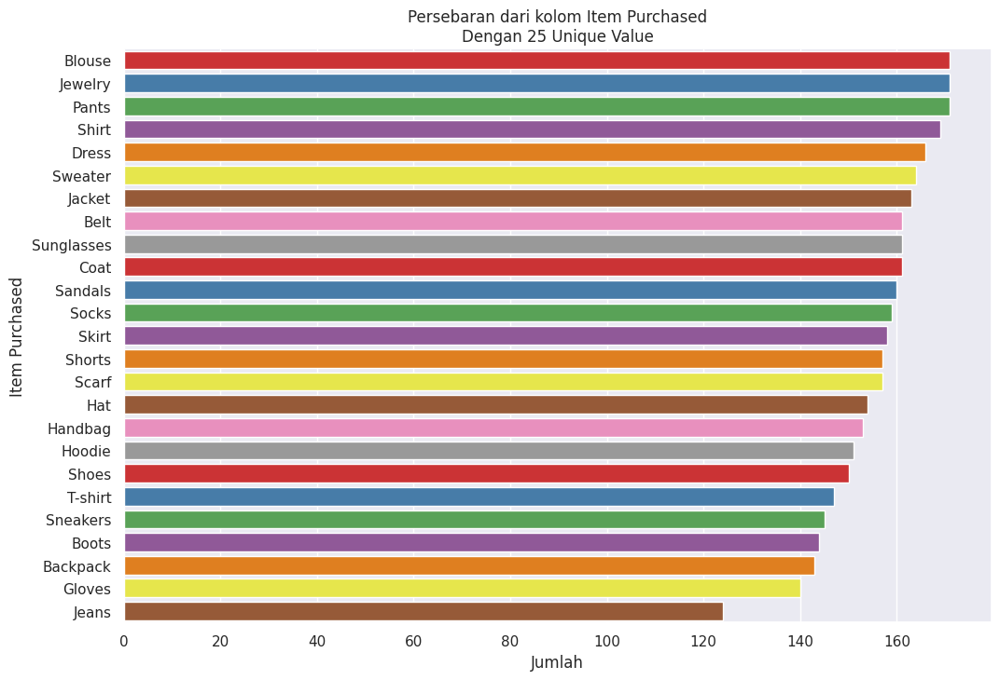

<ipython-input-113-80280315fdcb>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(y=column, data=data, order=sorted_data[column], palette="Set1")


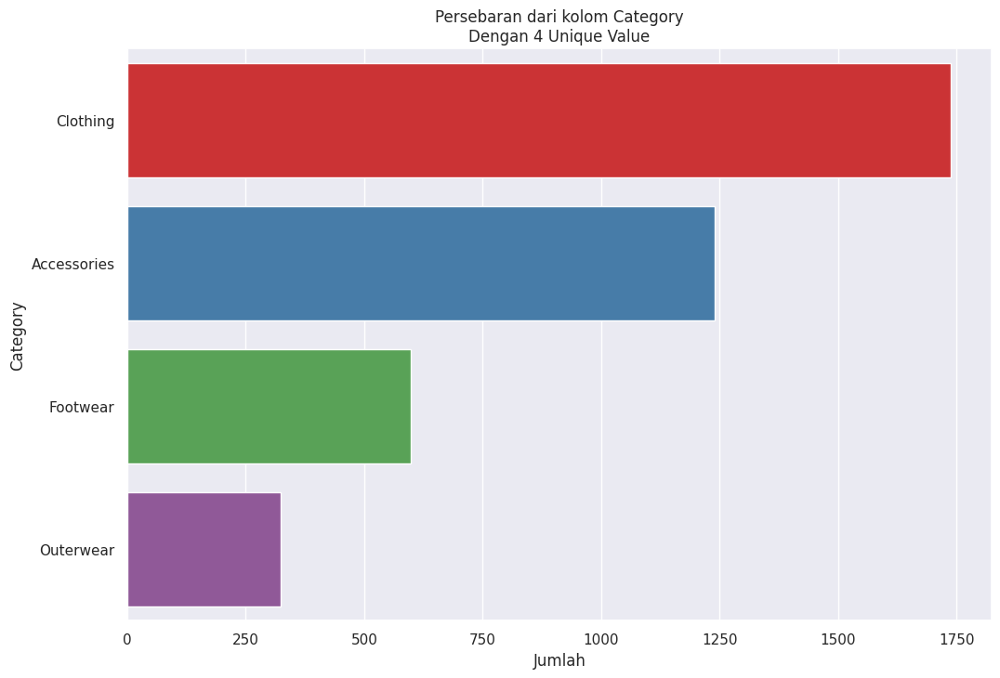

<ipython-input-113-80280315fdcb>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(y=column, data=data, order=sorted_data[column], palette="Set1")


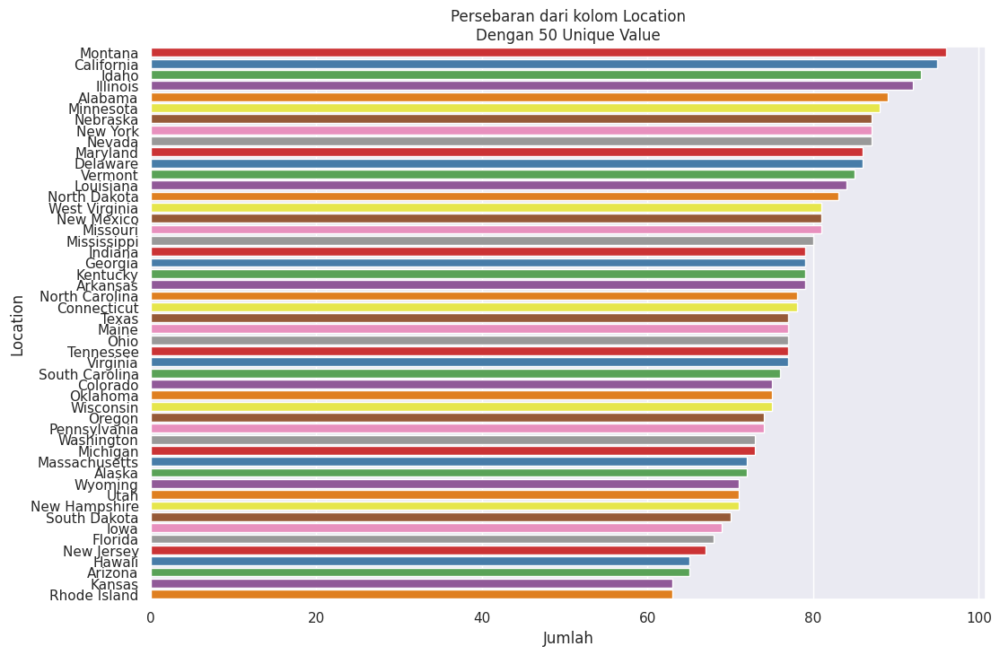

<ipython-input-113-80280315fdcb>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(y=column, data=data, order=sorted_data[column], palette="Set1")


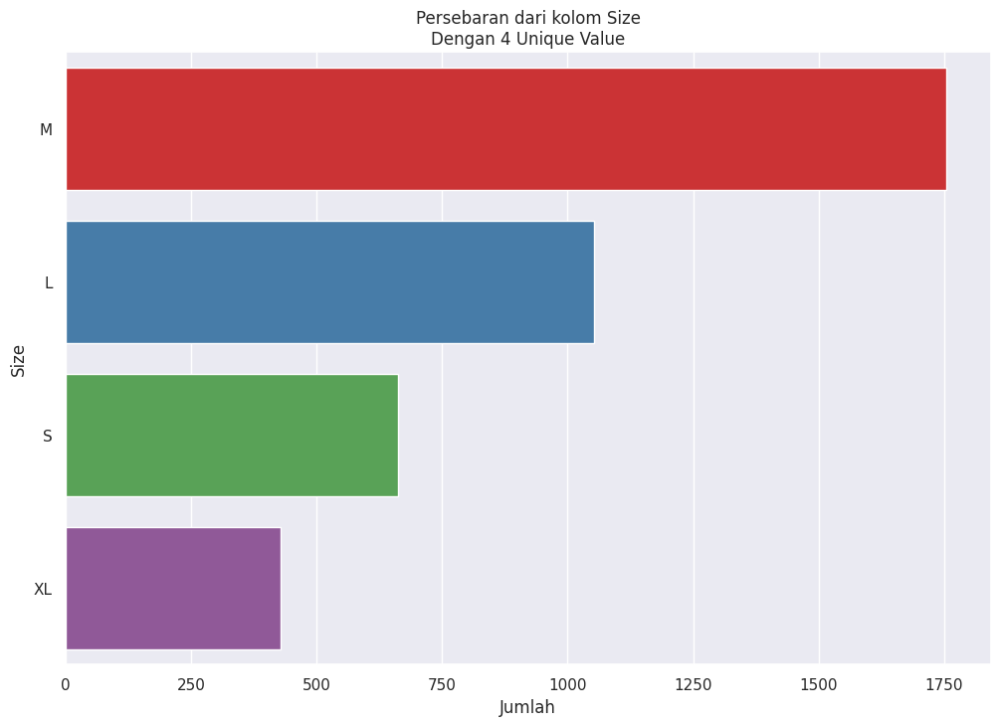

<ipython-input-113-80280315fdcb>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(y=column, data=data, order=sorted_data[column], palette="Set1")


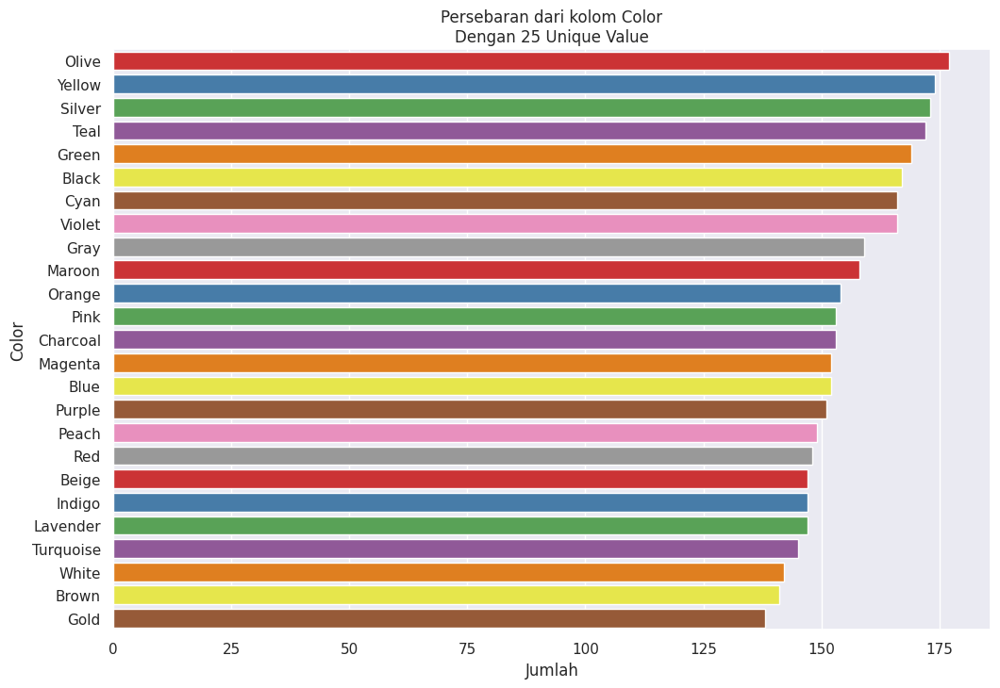

<ipython-input-113-80280315fdcb>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(y=column, data=data, order=sorted_data[column], palette="Set1")


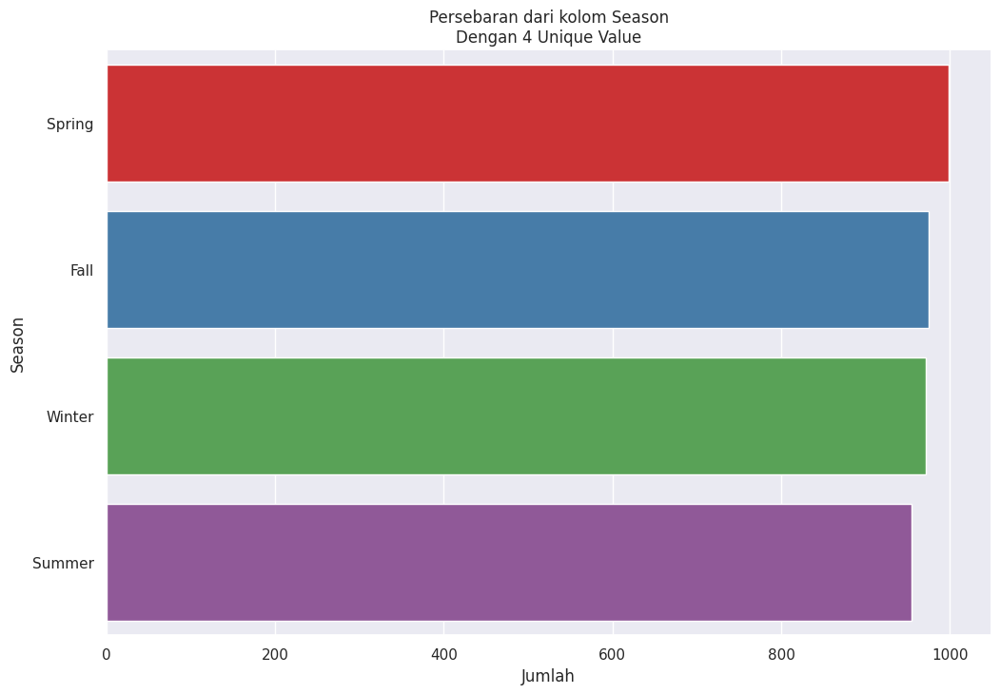

<ipython-input-113-80280315fdcb>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(y=column, data=data, order=sorted_data[column], palette="Set1")


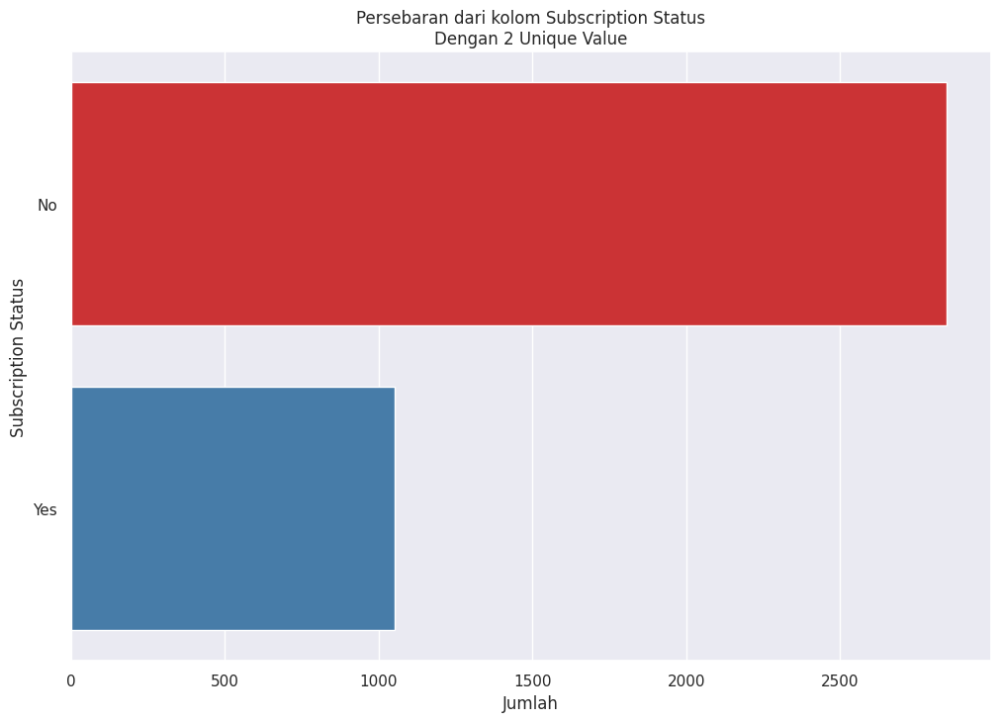

<ipython-input-113-80280315fdcb>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(y=column, data=data, order=sorted_data[column], palette="Set1")


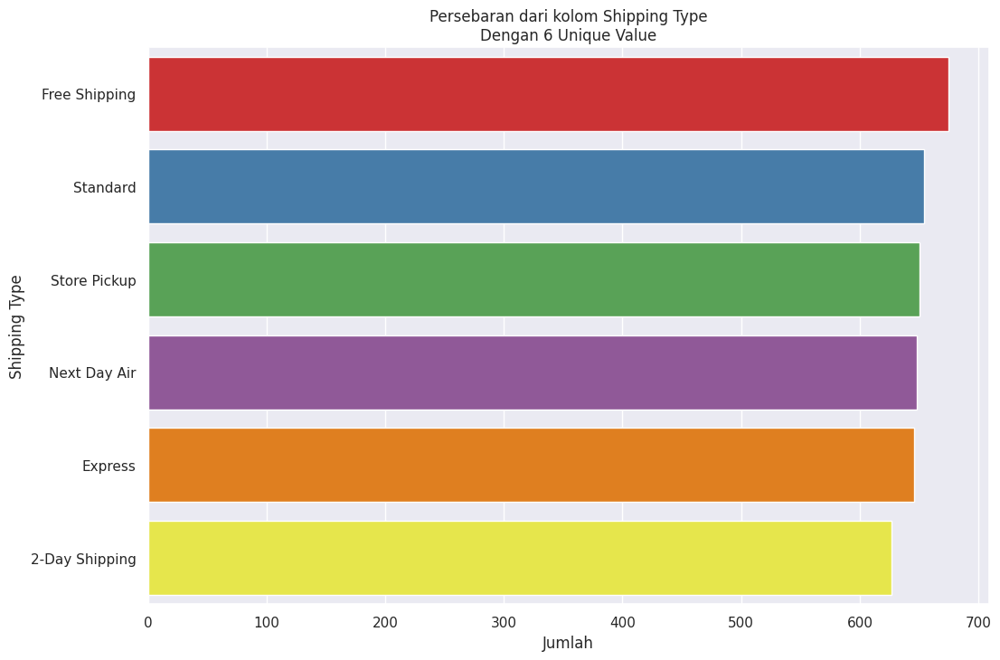

<ipython-input-113-80280315fdcb>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(y=column, data=data, order=sorted_data[column], palette="Set1")


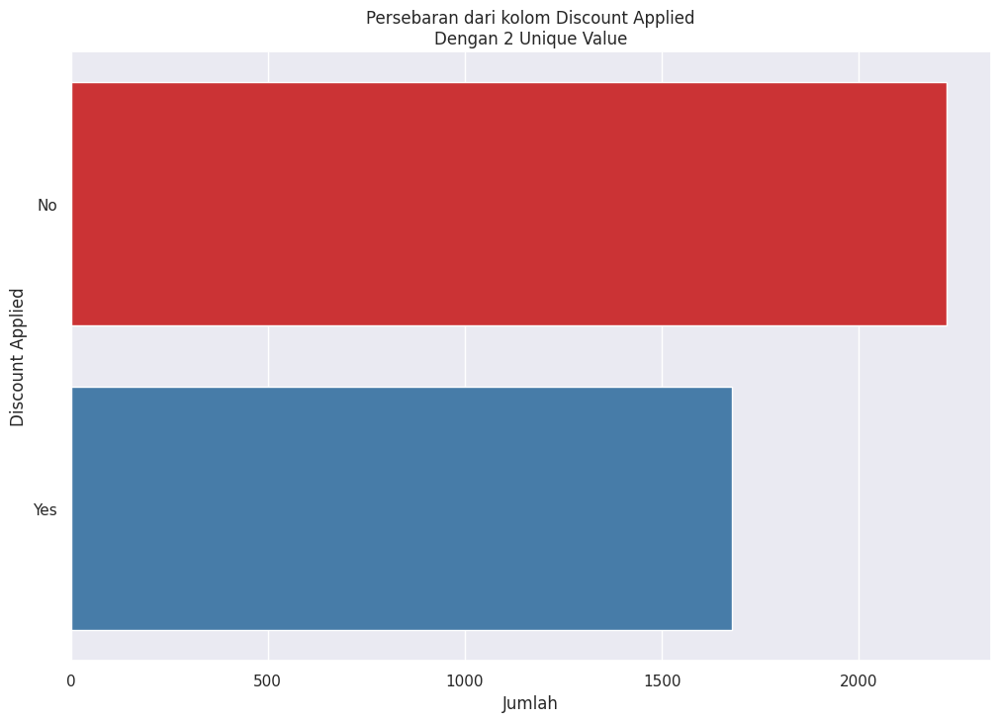

<ipython-input-113-80280315fdcb>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(y=column, data=data, order=sorted_data[column], palette="Set1")


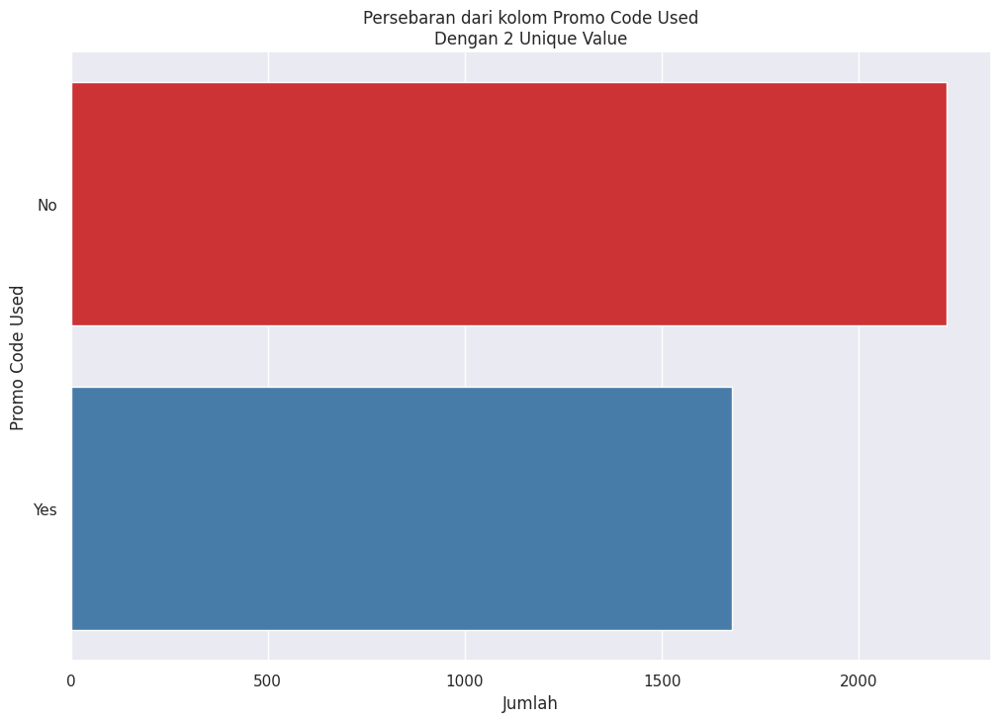

<ipython-input-113-80280315fdcb>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(y=column, data=data, order=sorted_data[column], palette="Set1")


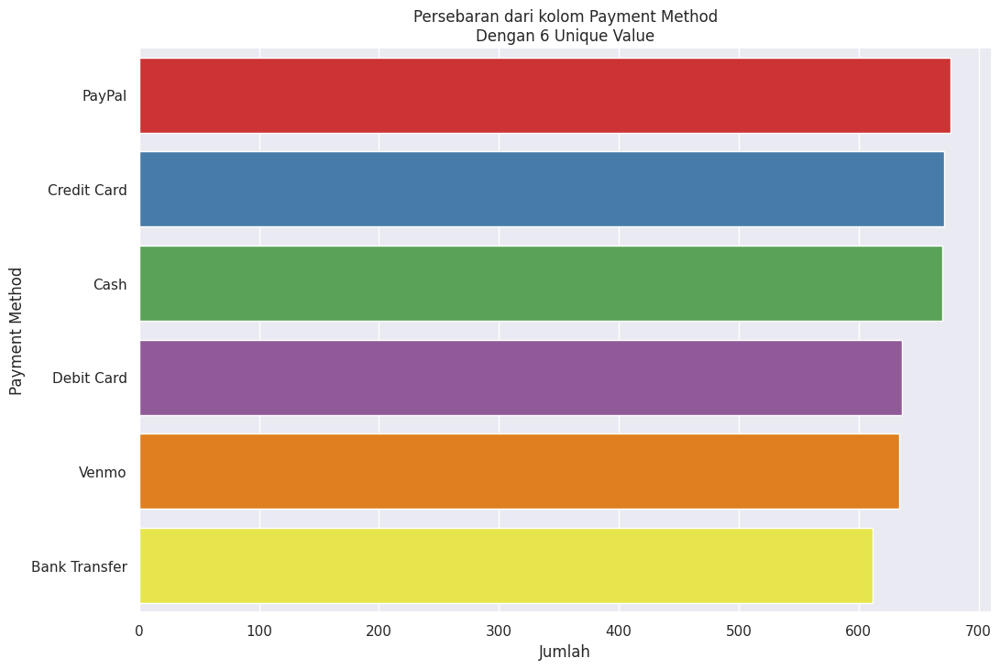

<ipython-input-113-80280315fdcb>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(y=column, data=data, order=sorted_data[column], palette="Set1")


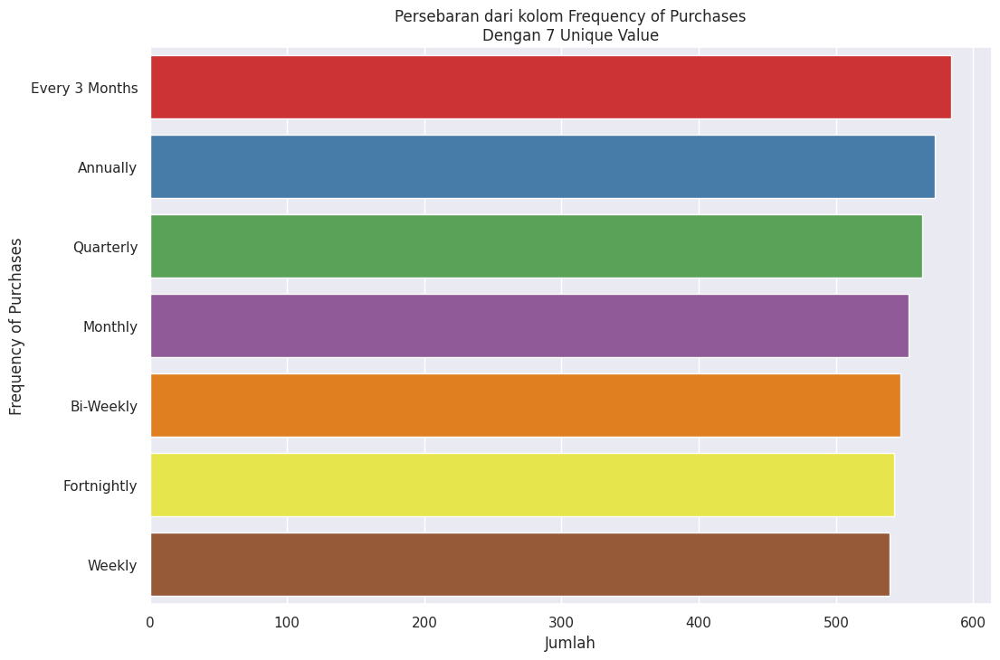

<ipython-input-113-80280315fdcb>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(y=column, data=data, order=sorted_data[column], palette="Set1")


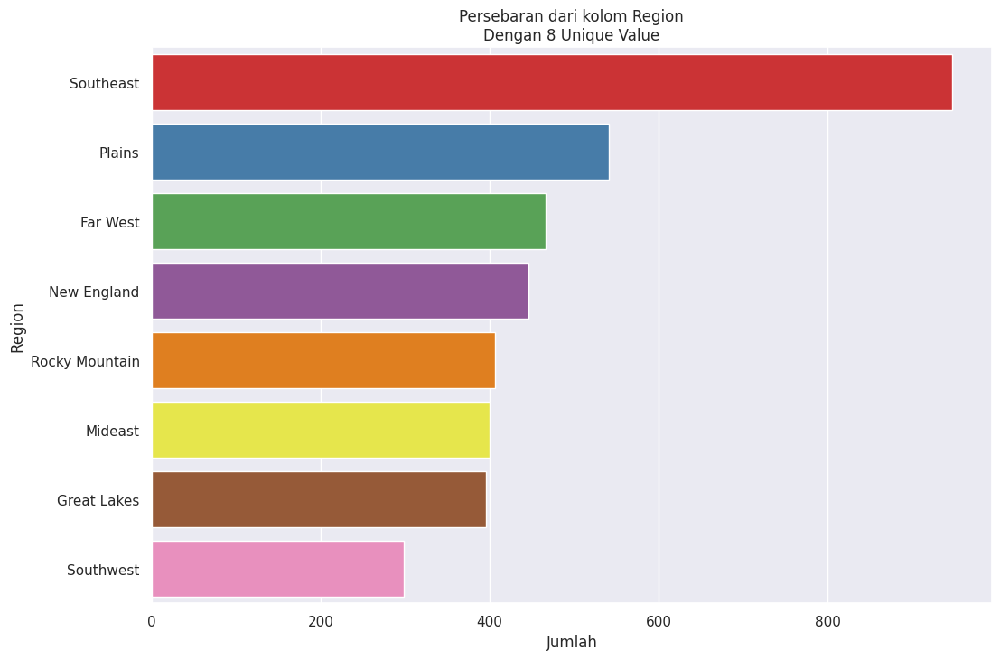

<ipython-input-113-80280315fdcb>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(y=column, data=data, order=sorted_data[column], palette="Set1")


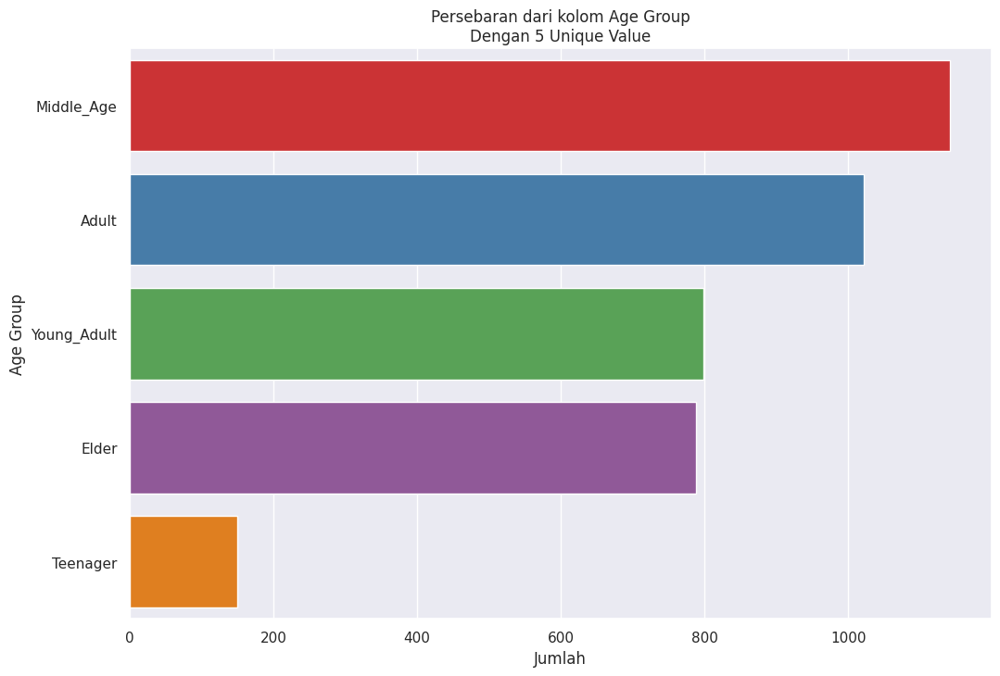

<ipython-input-113-80280315fdcb>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(y=column, data=data, order=sorted_data[column], palette="Set1")


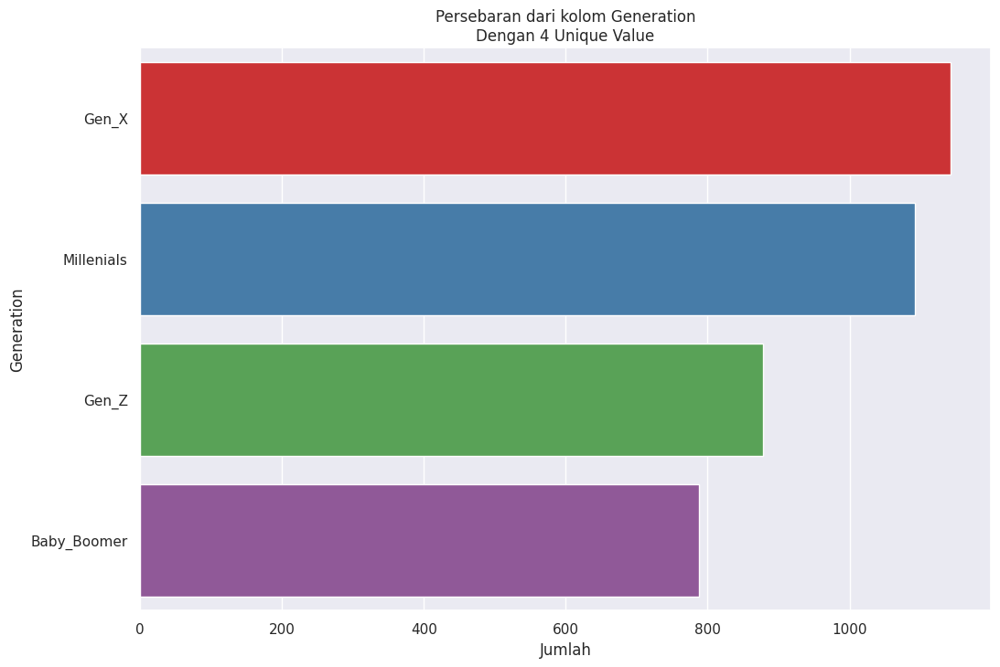

In [ ]:
for column in object_columns:
    plt.figure(figsize=(12, 8))

    # Sorting the data for the current column
    sorted_data = data[column].value_counts().reset_index().rename(columns={'index': column, column: 'count'})
    sorted_data = sorted_data.sort_values(by='count', ascending=False)

    ax = sns.countplot(y=column, data=data, order=sorted_data[column], palette="Set1")

    plt.title(f'Persebaran dari kolom {column}\nDengan {len(data[column].unique())} Unique Value')
    plt.xlabel('Jumlah')
    plt.ylabel(column)

    plt.show()

<ipython-input-114-a62a16dca3a4>:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(y=column, data=data, order=sorted_data[column], palette="Set1")


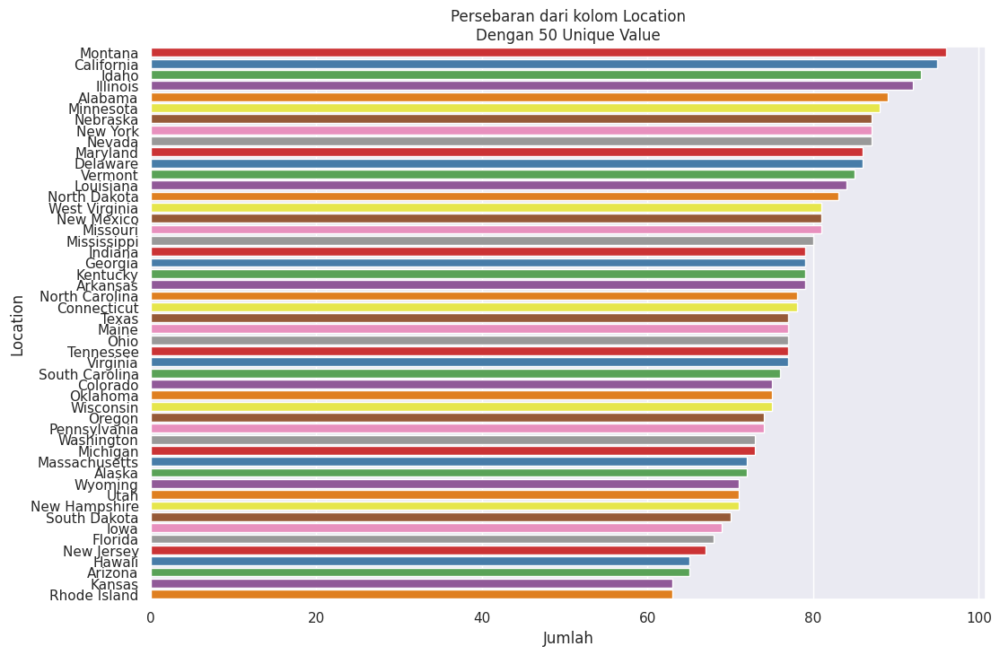

In [ ]:
column = "Location"

plt.figure(figsize=(12, 8))

# Sorting the data for the current column
sorted_data = data[column].value_counts().reset_index().rename(columns={'index': column, column: 'count'})
sorted_data = sorted_data.sort_values(by='count', ascending=False)

ax = sns.countplot(y=column, data=data, order=sorted_data[column], palette="Set1")

plt.title(f'Persebaran dari kolom {column}\nDengan {len(data[column].unique())} Unique Value')
plt.xlabel('Jumlah')
plt.ylabel(column)

plt.show()

## Mari melihat persebaran dari kolom numerikal (Scatter Plot)

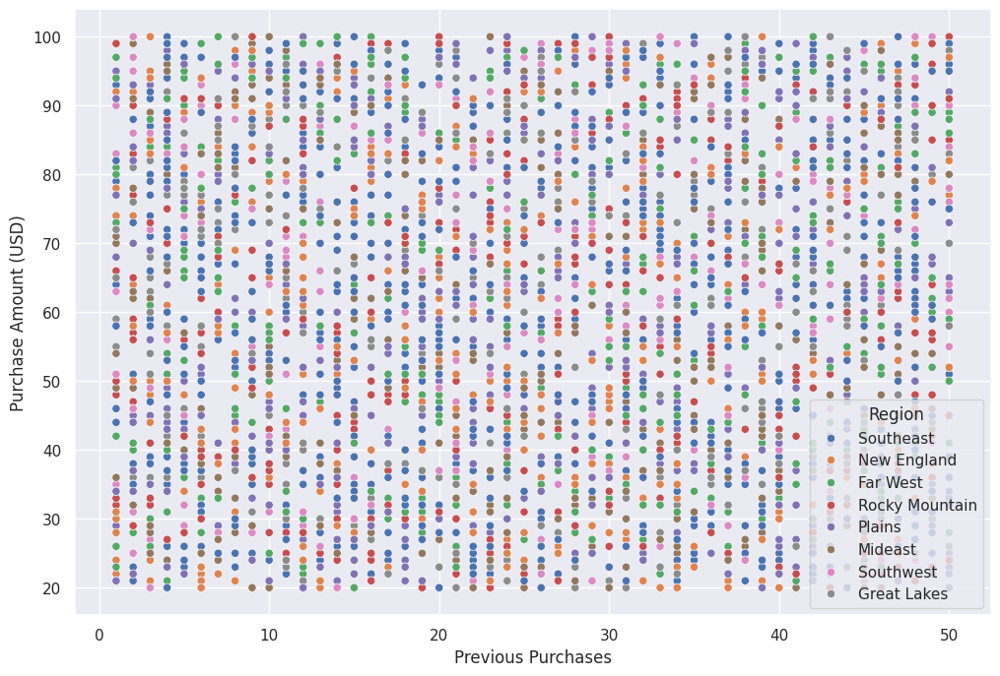

In [ ]:
plt.figure(figsize=(12,8))
sns.scatterplot(data=data, x='Previous Purchases', y='Purchase Amount (USD)', hue="Region")
plt.show()

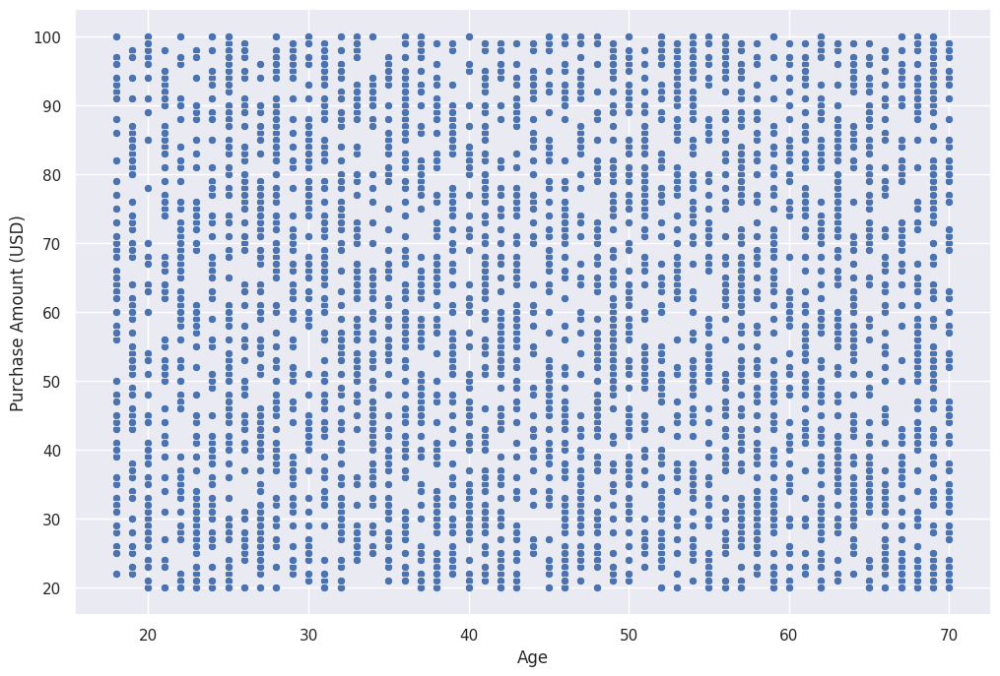

In [ ]:
plt.figure(figsize=(12,8))
sns.scatterplot(data=data, x='Age', y='Purchase Amount (USD)')
plt.show()

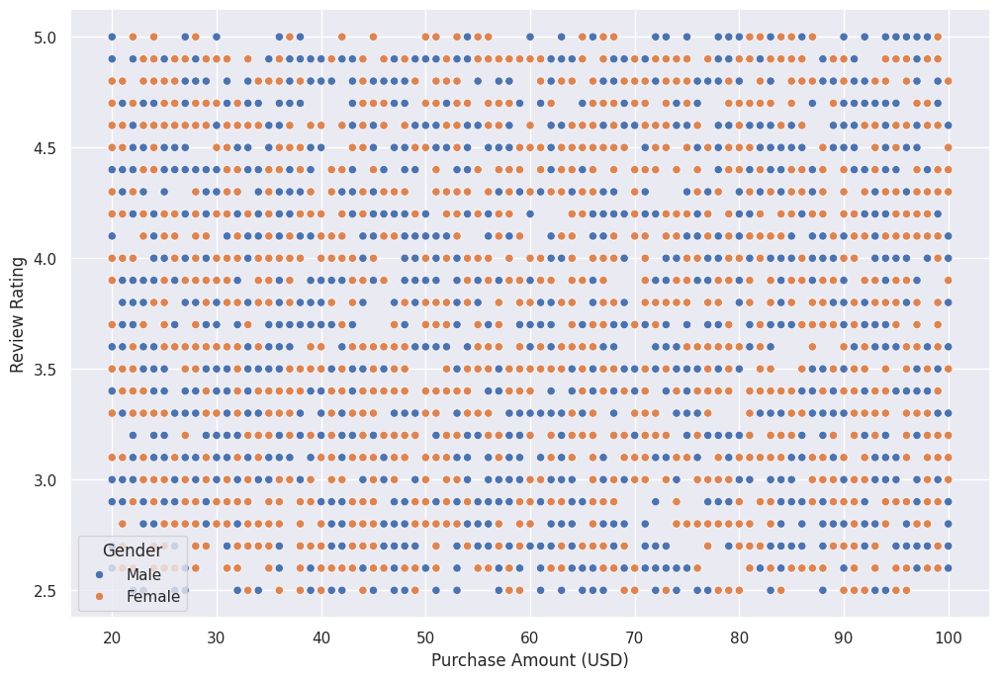

In [ ]:
plt.figure(figsize=(12,8))
sns.scatterplot(data=data, y='Review Rating', x='Purchase Amount (USD)', hue="Gender")
plt.show()

## Mari melihat dari densitas kolom numerikal berdasarkan berbagai hue(Density Plot)

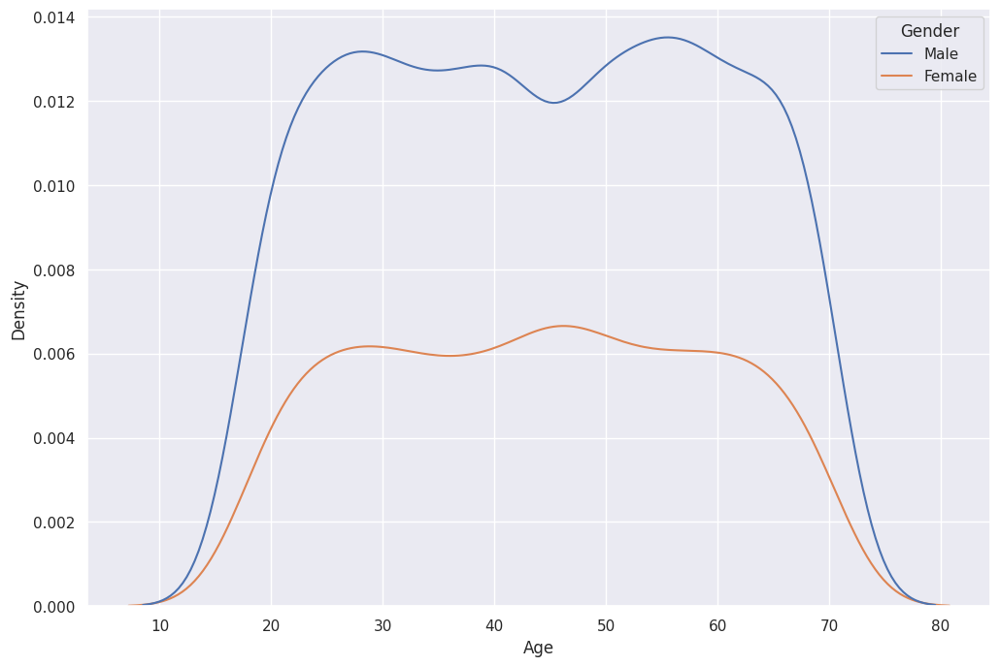

In [ ]:
plt.figure(figsize=(12, 8))
sns.kdeplot(data=data, x ='Age', hue='Gender')
plt.show()

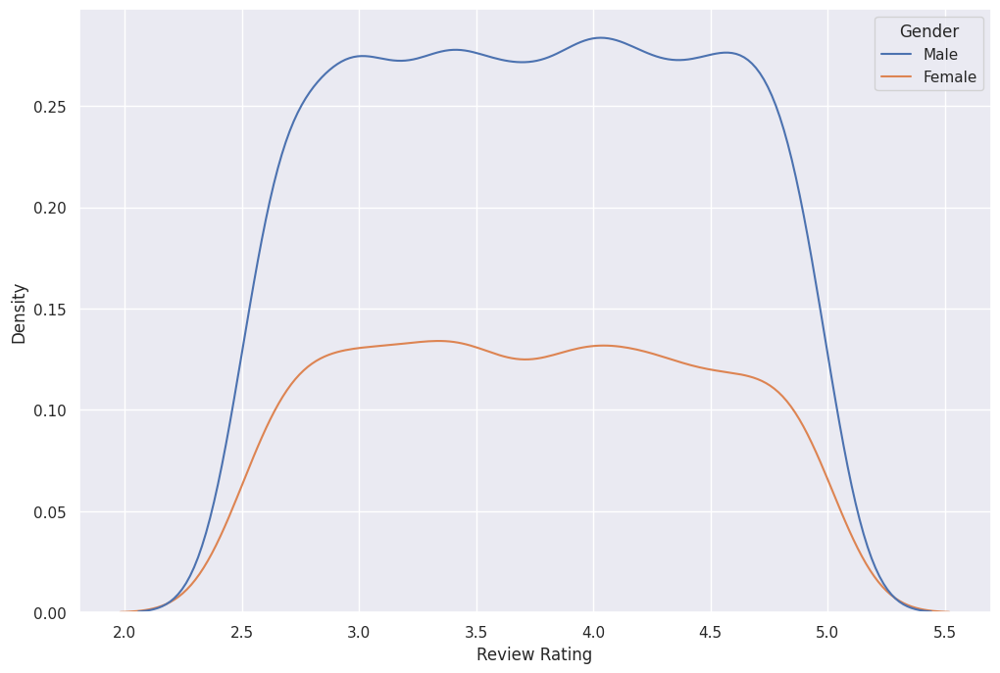

In [ ]:
plt.figure(figsize=(12, 8))
sns.kdeplot(data=data, x ='Review Rating', hue='Gender')
plt.show()

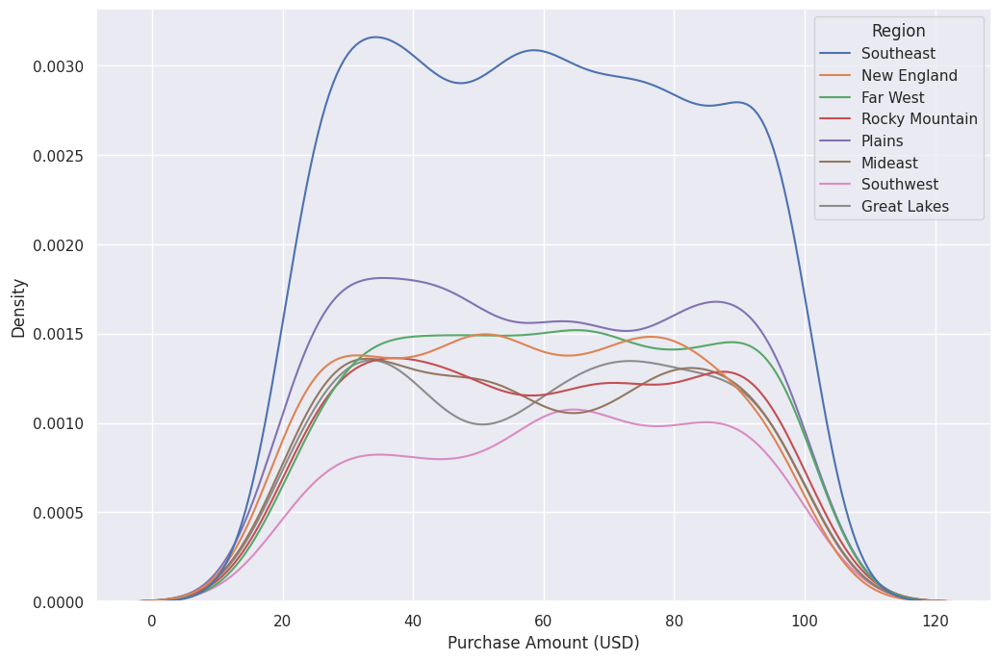

In [ ]:
plt.figure(figsize=(12, 8))
sns.kdeplot(data=data, x ='Purchase Amount (USD)', hue='Region')
plt.show()

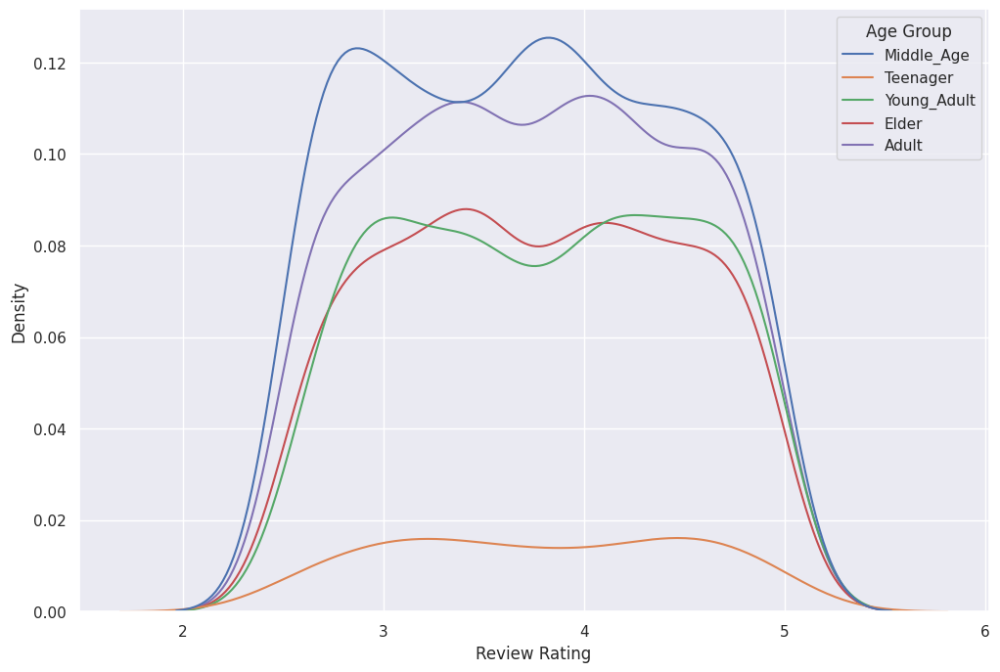

In [ ]:
plt.figure(figsize=(12, 8))
sns.kdeplot(data=data, x ='Review Rating', hue='Age Group')
plt.show()

## Melihat Violin Plot

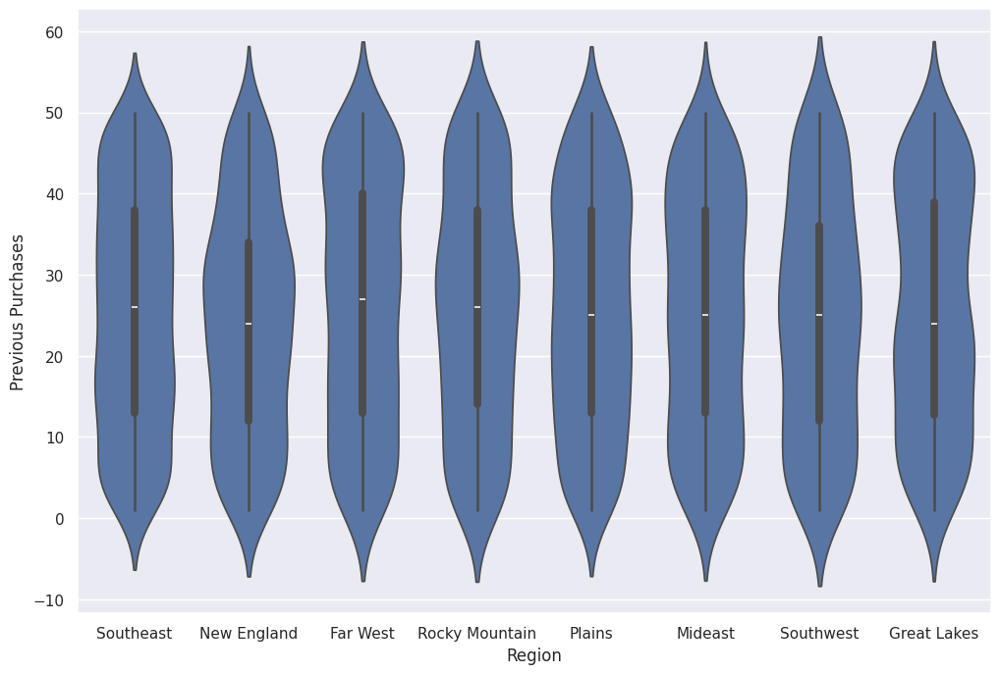

In [ ]:
plt.figure(figsize=(12,8))
sns.violinplot(data=data, y='Previous Purchases', x="Region")
plt.show()

<Figure size 2500x2500 with 0 Axes>

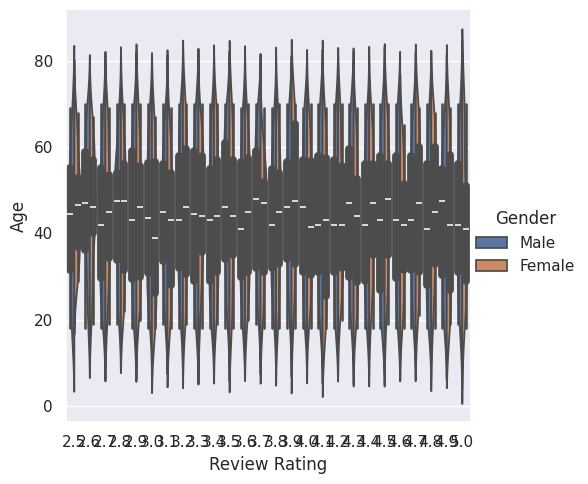

In [ ]:
plt.figure(figsize=(25, 25))
sns.catplot(x="Review Rating", y="Age", hue="Gender", kind="violin", split=True, data=data)

## Melihat bagaimana hubungan kolom dengan kolom lainnya (Pair Plot)

<Figure size 2000x800 with 0 Axes>

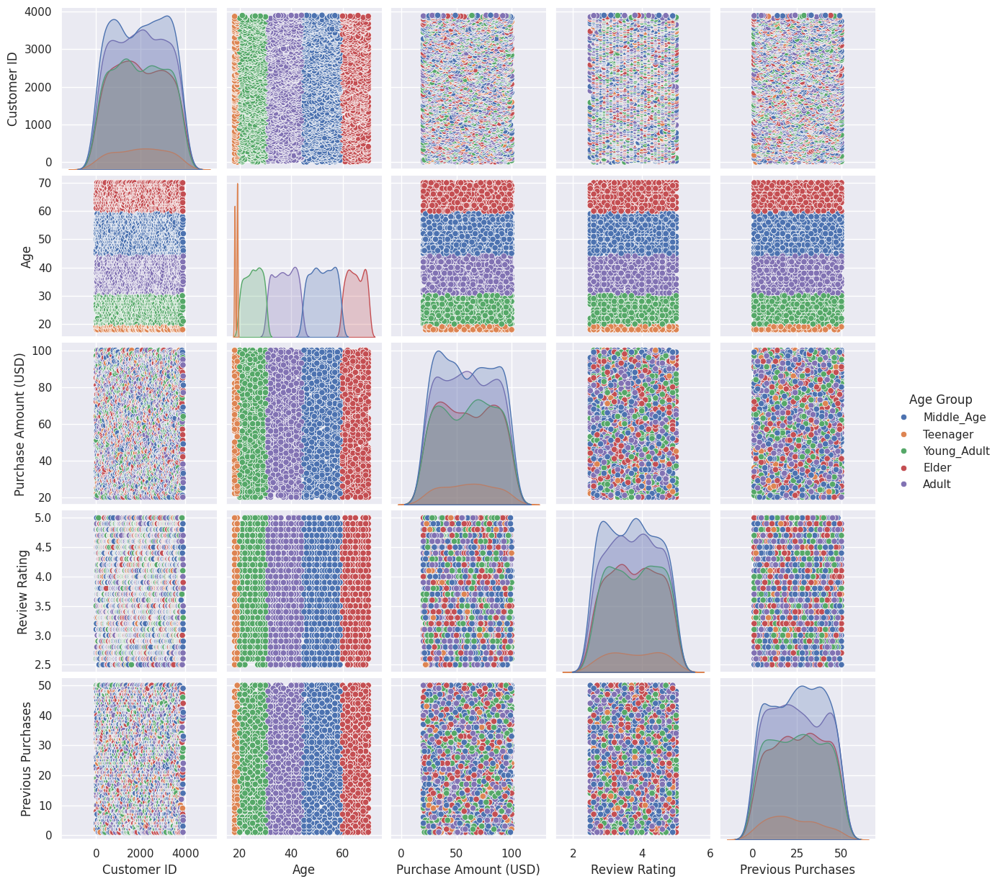

<Figure size 2000x800 with 0 Axes>

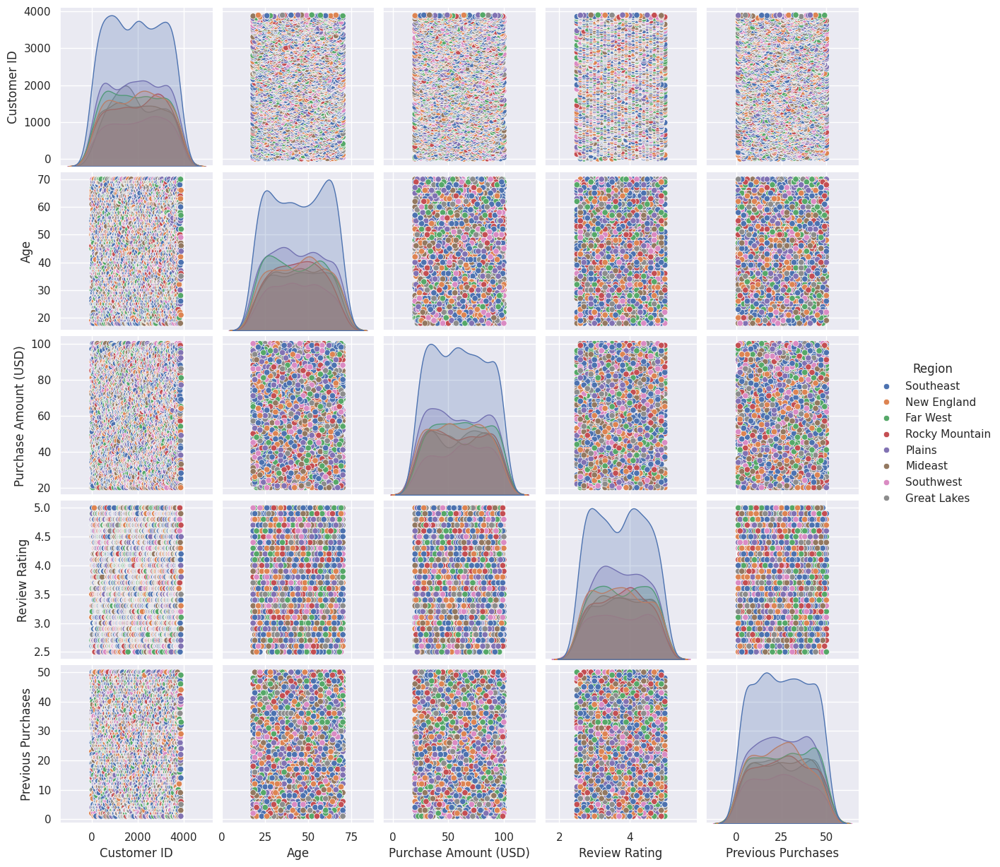

In [ ]:
for column in ["Age Group", "Region"]:
  plt.figure(figsize=(20,8))
  sns.pairplot(data, hue=column, diag_kind="kde")
  plt.show()

## Persebaran Value Counts menggunakan Pie Chart

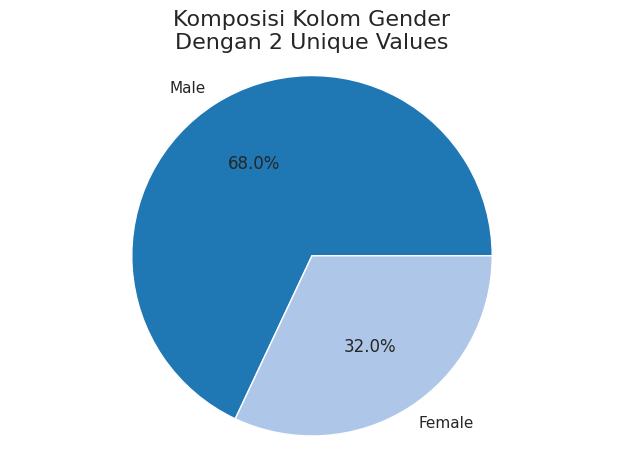

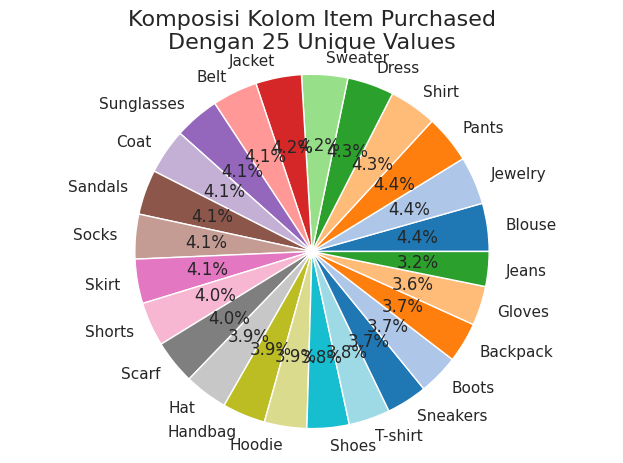

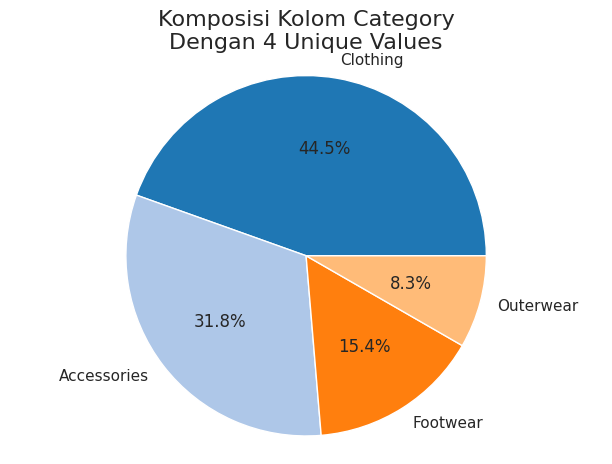

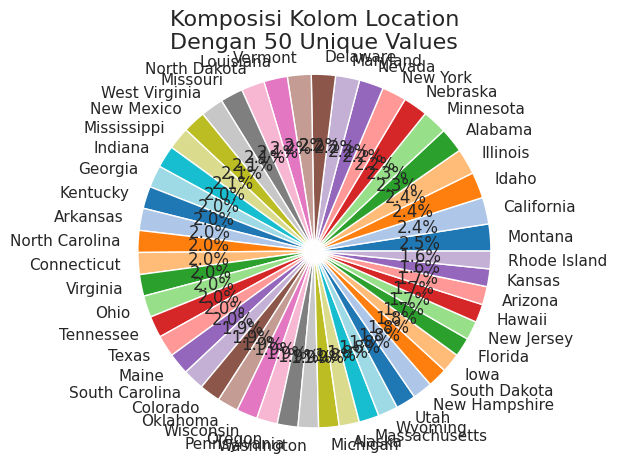

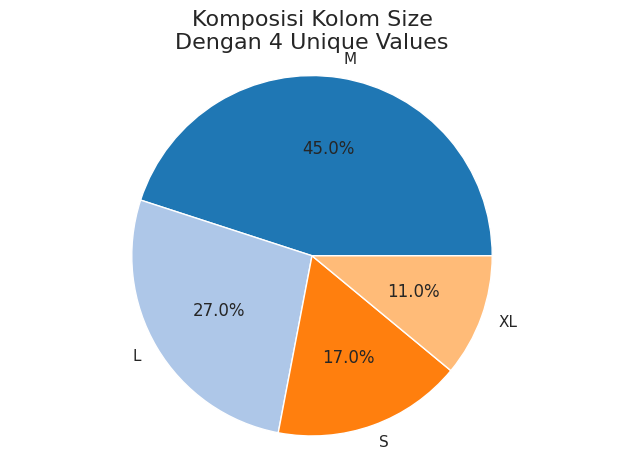

...

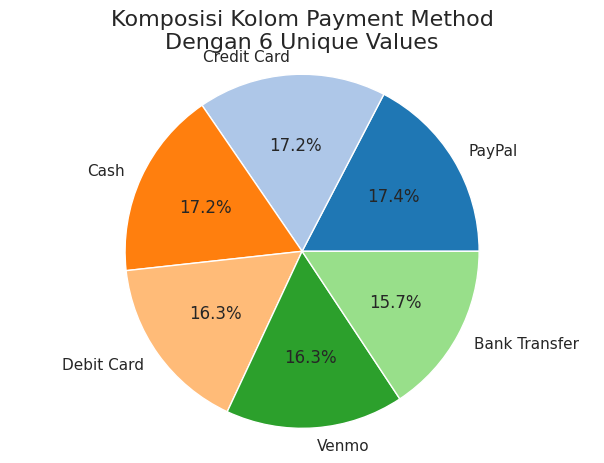

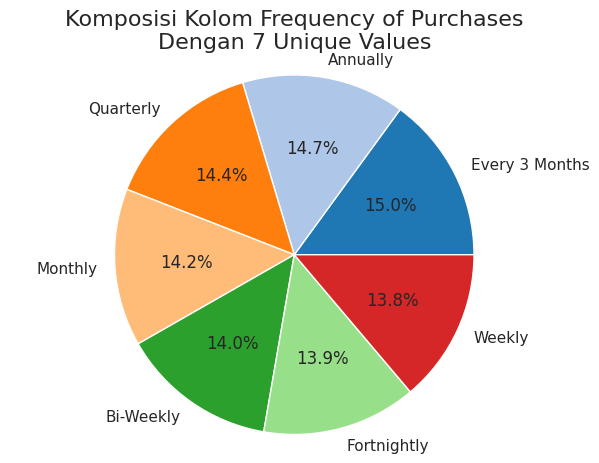

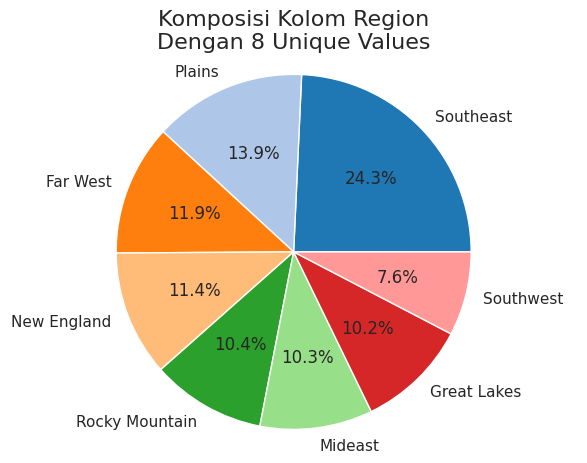

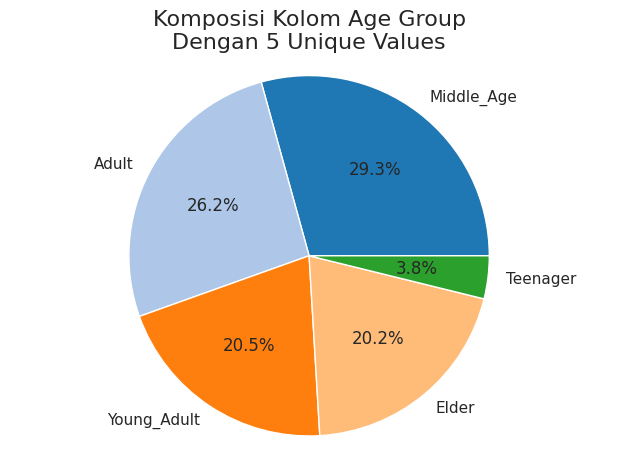

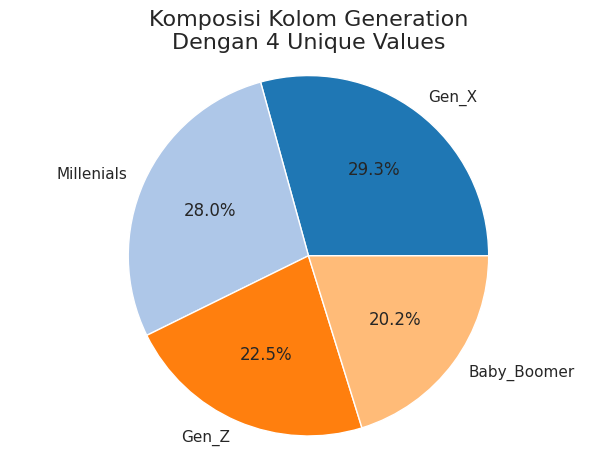

In [ ]:
for column in object_columns:
  pie_data = data[column]
  # Hitung jumlah nilai unik
  unique_values = len(pie_data.unique())

  # Hitung frekuensi setiap nilai
  value_counts = pie_data.value_counts()

  # Persiapkan warna
  colors = plt.cm.tab20.colors[:unique_values]

  # Buat plot pie dengan bagian tengah bolong
  plt.pie(value_counts, labels=value_counts.index, colors=colors, autopct='%1.1f%%')

  # Tambahkan tulisan
  plt.title(f'Komposisi Kolom {column}\nDengan {unique_values} Unique Values', fontsize=16)
  plt.axis('equal')  # Supaya plot menjadi lingkaran
  plt.tight_layout()

  # Tampilkan plot
  plt.show()

## Melihat Hubungan antara Kolom Penting (Sankey Diagram)

In [ ]:
import pandas as pd

# Import the sankey function from the sankey module within pySankey
from pySankey.sankey import sankey

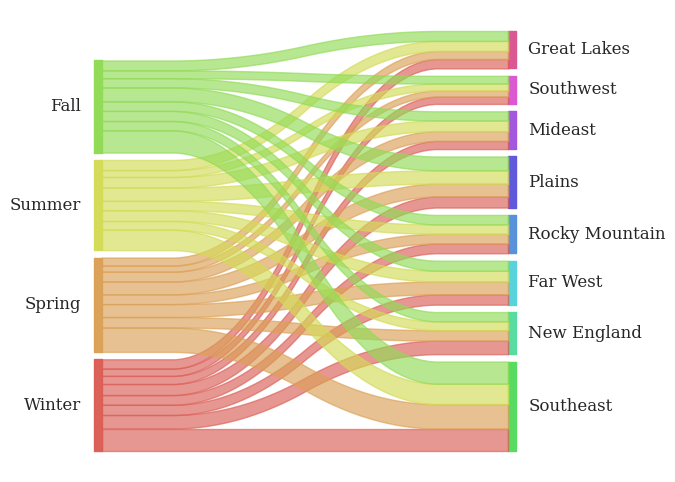

In [ ]:
sankey(data["Season"], data["Region"], aspect=20, fontsize=12)

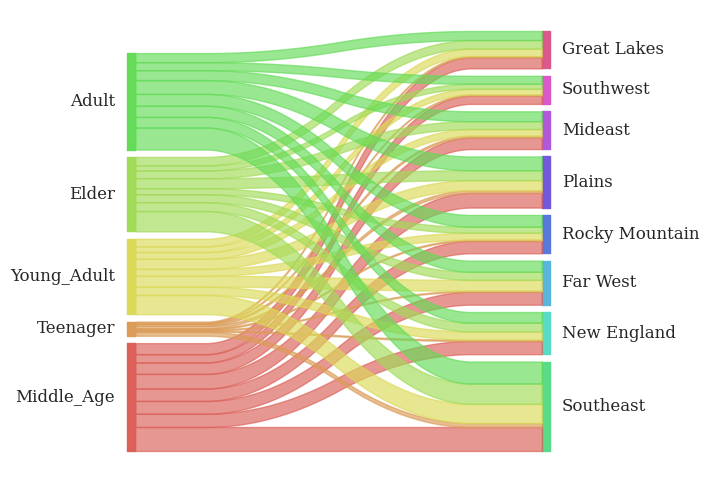

In [ ]:
sankey(data["Age Group"], data["Region"], aspect=20, fontsize=12)

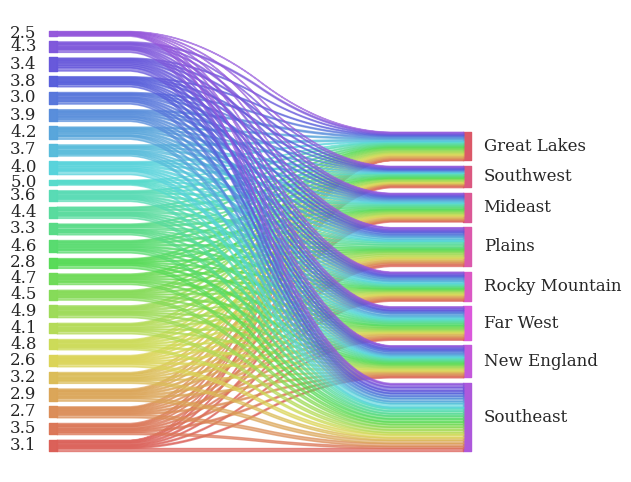

In [ ]:
sankey(data["Review Rating"], data["Region"], aspect=20, fontsize=12)

# Preprocessing (Non Feature Engineering Data, Non Encoding Data, Processed Data)

In [41]:
process_data = data.copy()
process_data.head()

,Customer ID,Age,Gender,Item Purchased,Category,Purchase Amount (USD),Location,Size,Color,Season,Review Rating,Subscription Status,Shipping Type,Discount Applied,Promo Code Used,Previous Purchases,Payment Method,Frequency of Purchases,Region,Age Group
0,1,55,Male,Blouse,Clothing,53,Kentucky,L,Gray,Winter,3.1,Yes,Express,Yes,Yes,14,Venmo,Fortnightly,Southeast,Middle_Age
1,2,19,Male,Sweater,Clothing,64,Maine,L,Maroon,Winter,3.1,Yes,Express,Yes,Yes,2,Cash,Fortnightly,New England,Teenager
2,3,50,Male,Jeans,Clothing,73,Massachusetts,S,Maroon,Spring,3.1,Yes,Free Shipping,Yes,Yes,23,Credit Card,Weekly,New England,Middle_Age
3,4,21,Male,Sandals,Footwear,90,Rhode Island,M,Maroon,Spring,3.5,Yes,Next Day Air,Yes,Yes,49,PayPal,Weekly,New England,Young_Adult
4,5,45,Male,Blouse,Clothing,49,Oregon,M,Turquoise,Spring,2.7,Yes,Free Shipping,Yes,Yes,31,PayPal,Annually,Far West,Middle_Age


In [42]:
process_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3900 entries, 0 to 3899
Data columns (total 20 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Customer ID             3900 non-null   int64  
 1   Age                     3900 non-null   int64  
 2   Gender                  3900 non-null   object 
 3   Item Purchased          3900 non-null   object 
 4   Category                3900 non-null   object 
 5   Purchase Amount (USD)   3900 non-null   int64  
 6   Location                3900 non-null   object 
 7   Size                    3900 non-null   object 
 8   Color                   3900 non-null   object 
 9   Season                  3900 non-null   object 
 10  Review Rating           3900 non-null   float64
 11  Subscription Status     3900 non-null   object 
 12  Shipping Type           3900 non-null   object 
 13  Discount Applied        3900 non-null   object 
 14  Promo Code Used         3900 non-null   

Bagi jadi tiga,
nan_process_data,
nan_encoding_data,
processed_data,

## Drop Useless Column

In [43]:
def drop_column(data, all_columns):
  clean_data = data.drop(columns=all_columns)
  return clean_data

In [44]:
nan_process_data = drop_column(data.copy(), ["Customer ID"])
nan_process_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3900 entries, 0 to 3899
Data columns (total 19 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Age                     3900 non-null   int64  
 1   Gender                  3900 non-null   object 
 2   Item Purchased          3900 non-null   object 
 3   Category                3900 non-null   object 
 4   Purchase Amount (USD)   3900 non-null   int64  
 5   Location                3900 non-null   object 
 6   Size                    3900 non-null   object 
 7   Color                   3900 non-null   object 
 8   Season                  3900 non-null   object 
 9   Review Rating           3900 non-null   float64
 10  Subscription Status     3900 non-null   object 
 11  Shipping Type           3900 non-null   object 
 12  Discount Applied        3900 non-null   object 
 13  Promo Code Used         3900 non-null   object 
 14  Previous Purchases      3900 non-null   

In [45]:
nan_encoding_data = processed_data = drop_column(data.copy(), ["Customer ID", "Item Purchased", "Color", "Location"])
processed_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3900 entries, 0 to 3899
Data columns (total 16 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Age                     3900 non-null   int64  
 1   Gender                  3900 non-null   object 
 2   Category                3900 non-null   object 
 3   Purchase Amount (USD)   3900 non-null   int64  
 4   Size                    3900 non-null   object 
 5   Season                  3900 non-null   object 
 6   Review Rating           3900 non-null   float64
 7   Subscription Status     3900 non-null   object 
 8   Shipping Type           3900 non-null   object 
 9   Discount Applied        3900 non-null   object 
 10  Promo Code Used         3900 non-null   object 
 11  Previous Purchases      3900 non-null   int64  
 12  Payment Method          3900 non-null   object 
 13  Frequency of Purchases  3900 non-null   object 
 14  Region                  3900 non-null   

## Splitting Categorical Value into Indicator Value

In [46]:
# Method for preprocessing
def prep(df):

  # Convert kategorikal ke variabel indikator
  df_dummies_freq = pd.get_dummies(df['Frequency of Purchases'])
  df_dummies_reg = pd.get_dummies(df['Region'])
  df_dummies_age = pd.get_dummies(df['Age Group'])

  # Menggabungkan DataFrame asli dengan DataFrame hasil get_dummies
  df = pd.concat([df, df_dummies_freq, df_dummies_reg, df_dummies_age], axis=1)

  # Hapus kolom yang sudah di convert
  df.drop(columns=['Frequency of Purchases', 'Region', 'Age Group'], axis=1, inplace=True)

  return df

In [182]:
# processed_data = prep(processed_data)
sep = processed_data.iloc[:, 13:]
sep.head()

,Annually,Bi-Weekly,Every 3 Months,Fortnightly,Monthly,Quarterly,Weekly,Far West,Great Lakes,Mideast,New England,Plains,Rocky Mountain,Southeast,Southwest,Adult,Elder,Middle_Age,Teenager,Young_Adult
0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0
1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0
2,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0
3,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,1
4,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0


In [184]:
sep.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3900 entries, 0 to 3899
Data columns (total 20 columns):
 #   Column          Non-Null Count  Dtype
---  ------          --------------  -----
 0   Annually        3900 non-null   uint8
 1   Bi-Weekly       3900 non-null   uint8
 2   Every 3 Months  3900 non-null   uint8
 3   Fortnightly     3900 non-null   uint8
 4   Monthly         3900 non-null   uint8
 5   Quarterly       3900 non-null   uint8
 6   Weekly          3900 non-null   uint8
 7   Far West        3900 non-null   uint8
 8   Great Lakes     3900 non-null   uint8
 9   Mideast         3900 non-null   uint8
 10  New England     3900 non-null   uint8
 11  Plains          3900 non-null   uint8
 12  Rocky Mountain  3900 non-null   uint8
 13  Southeast       3900 non-null   uint8
 14  Southwest       3900 non-null   uint8
 15  Adult           3900 non-null   uint8
 16  Elder           3900 non-null   uint8
 17  Middle_Age      3900 non-null   uint8
 18  Teenager        3900 non-nul

In [48]:
processed_data.shape

(3900, 33)

In [49]:
nan_column_type = nan_process_data.dtypes

In [50]:
nan_object_columns = nan_column_type[nan_column_type == 'object'].index.tolist()
nan_object_columns

['Gender',
 'Item Purchased',
 'Category',
 'Location',
 'Size',
 'Color',
 'Season',
 'Subscription Status',
 'Shipping Type',
 'Discount Applied',
 'Promo Code Used',
 'Payment Method',
 'Frequency of Purchases',
 'Region',
 'Age Group']

In [51]:
enco_column_types = nan_encoding_data.dtypes

In [52]:
enco_object_columns = enco_column_types[enco_column_types == 'object'].index.tolist()
enco_object_columns

['Gender',
 'Category',
 'Size',
 'Season',
 'Subscription Status',
 'Shipping Type',
 'Discount Applied',
 'Promo Code Used',
 'Payment Method',
 'Frequency of Purchases',
 'Region',
 'Age Group']

In [53]:
column_types = processed_data.dtypes

In [54]:
object_columns = column_types[column_types == 'object'].index.tolist()
object_columns

['Gender',
 'Category',
 'Size',
 'Season',
 'Subscription Status',
 'Shipping Type',
 'Discount Applied',
 'Promo Code Used',
 'Payment Method']

## Splitting Categorical Value

In [55]:
# menggunakan LabelEncoding untuk nan_process_data
le = LabelEncoder()

for column in nan_object_columns:
  nan_process_data[column] = le.fit_transform(nan_process_data[column])

nan_process_data.head()

,Age,Gender,Item Purchased,Category,Purchase Amount (USD),Location,Size,Color,Season,Review Rating,Subscription Status,Shipping Type,Discount Applied,Promo Code Used,Previous Purchases,Payment Method,Frequency of Purchases,Region,Age Group
0,55,1,2,1,53,16,0,7,3,3.1,1,1,1,1,14,5,3,6,2
1,19,1,23,1,64,18,0,12,3,3.1,1,1,1,1,2,1,3,3,3
2,50,1,11,1,73,20,2,12,1,3.1,1,2,1,1,23,2,6,3,2
3,21,1,14,2,90,38,1,12,1,3.5,1,3,1,1,49,4,6,3,4
4,45,1,2,1,49,36,1,21,1,2.7,1,2,1,1,31,4,0,0,2


In [56]:
# menggunakan LabelEncoding untuk nan_encoding_dtaa
for column in enco_object_columns:
  nan_encoding_data[column] = le.fit_transform(nan_encoding_data[column])

nan_encoding_data.head()

,Age,Gender,Category,Purchase Amount (USD),Size,Season,Review Rating,Subscription Status,Shipping Type,Discount Applied,Promo Code Used,Previous Purchases,Payment Method,Frequency of Purchases,Region,Age Group
0,55,1,1,53,0,3,3.1,1,1,1,1,14,5,3,6,2
1,19,1,1,64,0,3,3.1,1,1,1,1,2,1,3,3,3
2,50,1,1,73,2,1,3.1,1,2,1,1,23,2,6,3,2
3,21,1,2,90,1,1,3.5,1,3,1,1,49,4,6,3,4
4,45,1,1,49,1,1,2.7,1,2,1,1,31,4,0,0,2


In [57]:
# menggunakan LabelEncoding untuk nominal fitur
for column in object_columns:
  processed_data[column] = le.fit_transform(processed_data[column])

processed_data.head()

,Age,Gender,Category,Purchase Amount (USD),Size,Season,Review Rating,Subscription Status,Shipping Type,Discount Applied,...,New England,Plains,Rocky Mountain,Southeast,Southwest,Adult,Elder,Middle_Age,Teenager,Young_Adult
0,55,1,1,53,0,3,3.1,1,1,1,...,0,0,0,1,0,0,0,1,0,0
1,19,1,1,64,0,3,3.1,1,1,1,...,1,0,0,0,0,0,0,0,1,0
2,50,1,1,73,2,1,3.1,1,2,1,...,1,0,0,0,0,0,0,1,0,0
3,21,1,2,90,1,1,3.5,1,3,1,...,1,0,0,0,0,0,0,0,0,1
4,45,1,1,49,1,1,2.7,1,2,1,...,0,0,0,0,0,0,0,1,0,0


## Splitting Features and Target

In [58]:
X_train_raw = nan_process_data.drop('Age', axis=1)
y_train_raw = nan_process_data['Age']

print("X_train (Raw Column) shape:", X_train_raw.shape)
print("y_train (Raw Column) shape:", y_train_raw.shape, "\n")

X_train (Raw Column) shape: (3900, 18)
y_train (Raw Column) shape: (3900,) 



In [59]:
X_train_enco = nan_encoding_data.drop('Age', axis=1)
y_train_enco = nan_encoding_data['Age']

print("X_train (Without Encoding Column) shape:", X_train_enco.shape)
print("y_train (Without Encoding Column) shape:", y_train_enco.shape, "\n")

X_train (Without Encoding Column) shape: (3900, 15)
y_train (Without Encoding Column) shape: (3900,) 



In [60]:
X_train = processed_data.drop('Age', axis=1)
y_train = processed_data['Age']

print("X_train shape:", X_train.shape)
print("y_train shape:", y_train.shape, "\n")

X_train shape: (3900, 32)
y_train shape: (3900,) 



## Data transformation

In [61]:
from sklearn.preprocessing import StandardScaler

In [62]:
scaler = StandardScaler()
X_train = pd.DataFrame(scaler.fit_transform(X_train) , columns = X_train.columns)

In [63]:
X_train.head()

,Gender,Category,Purchase Amount (USD),Size,Season,Review Rating,Subscription Status,Shipping Type,Discount Applied,Promo Code Used,...,New England,Plains,Rocky Mountain,Southeast,Southwest,Adult,Elder,Middle_Age,Teenager,Young_Adult
0,0.685994,-0.002002,-0.285629,-1.203814,1.349198,-0.907584,1.644294,-0.892178,1.151339,1.151339,...,-0.359341,-0.401323,-0.34088,1.765862,-0.287631,-0.595514,-0.503203,1.554047,-0.2,-0.507601
1,0.685994,-0.002002,0.178852,-1.203814,1.349198,-0.907584,1.644294,-0.892178,1.151339,1.151339,...,2.782875,-0.401323,-0.34088,-0.566296,-0.287631,-0.595514,-0.503203,-0.643481,5.0,-0.507601
2,0.685994,-0.002002,0.558882,0.945854,-0.441163,-0.907584,1.644294,-0.303032,1.151339,1.151339,...,2.782875,-0.401323,-0.34088,-0.566296,-0.287631,-0.595514,-0.503203,1.554047,-0.2,-0.507601
3,0.685994,1.113356,1.276716,-0.128980,-0.441163,-0.349027,1.644294,0.286113,1.151339,1.151339,...,2.782875,-0.401323,-0.34088,-0.566296,-0.287631,-0.595514,-0.503203,-0.643481,-0.2,1.970051
4,0.685994,-0.002002,-0.454531,-0.128980,-0.441163,-1.466141,1.644294,-0.303032,1.151339,1.151339,...,-0.359341,-0.401323,-0.34088,-0.566296,-0.287631,-0.595514,-0.503203,1.554047,-0.2,-0.507601


In [64]:
# Nan Encoding Data
X_train_enco = pd.DataFrame(scaler.fit_transform(X_train_enco) , columns = X_train_enco.columns)

In [65]:
X_train_enco.head()

,Gender,Category,Purchase Amount (USD),Size,Season,Review Rating,Subscription Status,Shipping Type,Discount Applied,Promo Code Used,Previous Purchases,Payment Method,Frequency of Purchases,Region,Age Group
0,0.685994,-0.002002,-0.285629,-1.203814,1.349198,-0.907584,1.644294,-0.892178,1.151339,1.151339,-0.785831,1.471636,0.012575,1.017650,0.194712
1,0.685994,-0.002002,0.178852,-1.203814,1.349198,-0.907584,1.644294,-0.892178,1.151339,1.151339,-1.616552,-0.894631,0.012575,-0.319559,0.896538
2,0.685994,-0.002002,0.558882,0.945854,-0.441163,-0.907584,1.644294,-0.303032,1.151339,1.151339,-0.162789,-0.303064,1.513849,-0.319559,0.194712
3,0.685994,1.113356,1.276716,-0.128980,-0.441163,-0.349027,1.644294,0.286113,1.151339,1.151339,1.637107,0.880069,1.513849,-0.319559,1.598364
4,0.685994,-0.002002,-0.454531,-0.128980,-0.441163,-1.466141,1.644294,-0.303032,1.151339,1.151339,0.391025,0.880069,-1.488699,-1.656767,0.194712


In [66]:
# Raw Model
X_train_raw = pd.DataFrame(scaler.fit_transform(X_train_raw) , columns = X_train_raw.columns)

In [67]:
X_train_raw.head()

,Gender,Item Purchased,Category,Purchase Amount (USD),Location,Size,Color,Season,Review Rating,Subscription Status,Shipping Type,Discount Applied,Promo Code Used,Previous Purchases,Payment Method,Frequency of Purchases,Region,Age Group
0,0.685994,-1.394144,-0.002002,-0.285629,-0.576399,-1.203814,-0.707620,1.349198,-0.907584,1.644294,-0.892178,1.151339,1.151339,-0.785831,1.471636,0.012575,1.017650,0.194712
1,0.685994,1.523236,-0.002002,0.178852,-0.436944,-1.203814,-0.015163,1.349198,-0.907584,1.644294,-0.892178,1.151339,1.151339,-1.616552,-0.894631,0.012575,-0.319559,0.896538
2,0.685994,-0.143839,-0.002002,0.558882,-0.297488,0.945854,-0.015163,-0.441163,-0.907584,1.644294,-0.303032,1.151339,1.151339,-0.162789,-0.303064,1.513849,-0.319559,0.194712
3,0.685994,0.272930,1.113356,1.276716,0.957614,-0.128980,-0.015163,-0.441163,-0.349027,1.644294,0.286113,1.151339,1.151339,1.637107,0.880069,1.513849,-0.319559,1.598364
4,0.685994,-1.394144,-0.002002,-0.454531,0.818159,-0.128980,1.231259,-0.441163,-1.466141,1.644294,-0.303032,1.151339,1.151339,0.391025,0.880069,-1.488699,-1.656767,0.194712


## Feature Selection Using Correlation

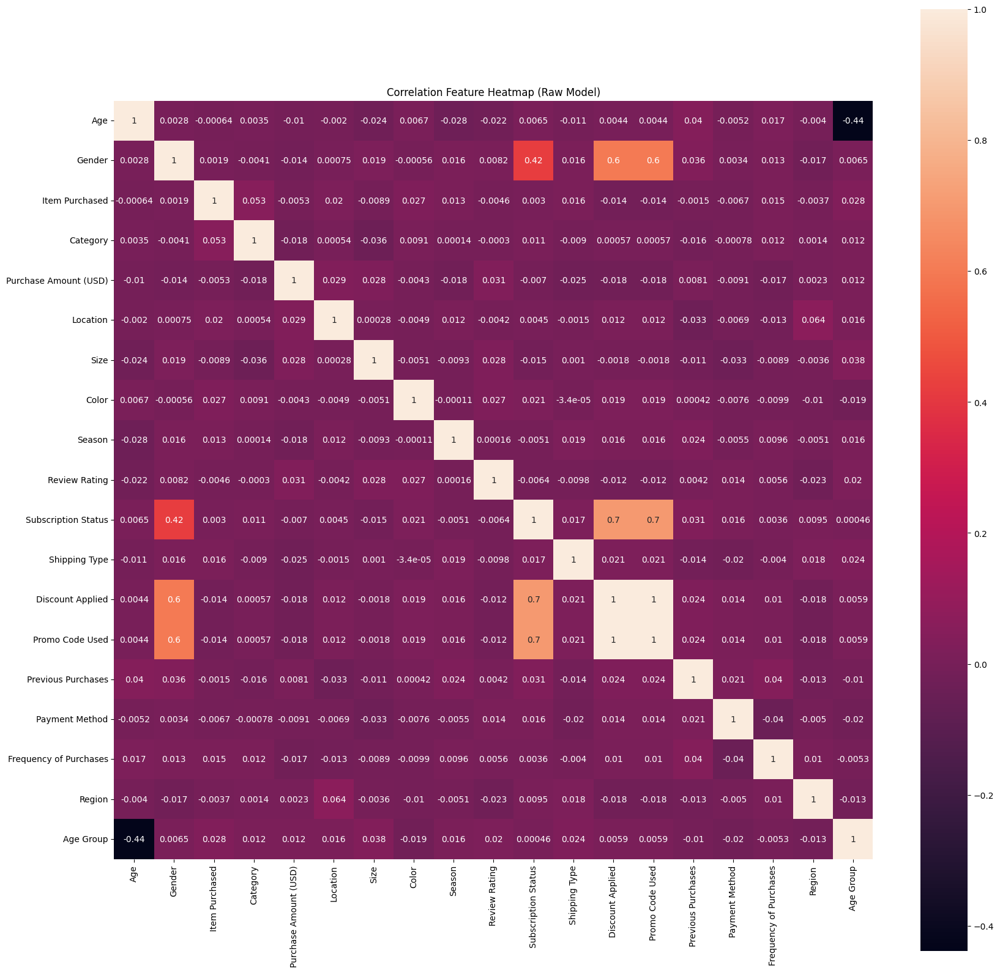

In [68]:
corrmat = nan_process_data.corr(method='pearson')
f, ax = plt.subplots(figsize=(20, 20))
sns.heatmap(corrmat, annot=True, vmax=1, square=True);
plt.title('Correlation Feature Heatmap (Raw Model)');
plt.show()

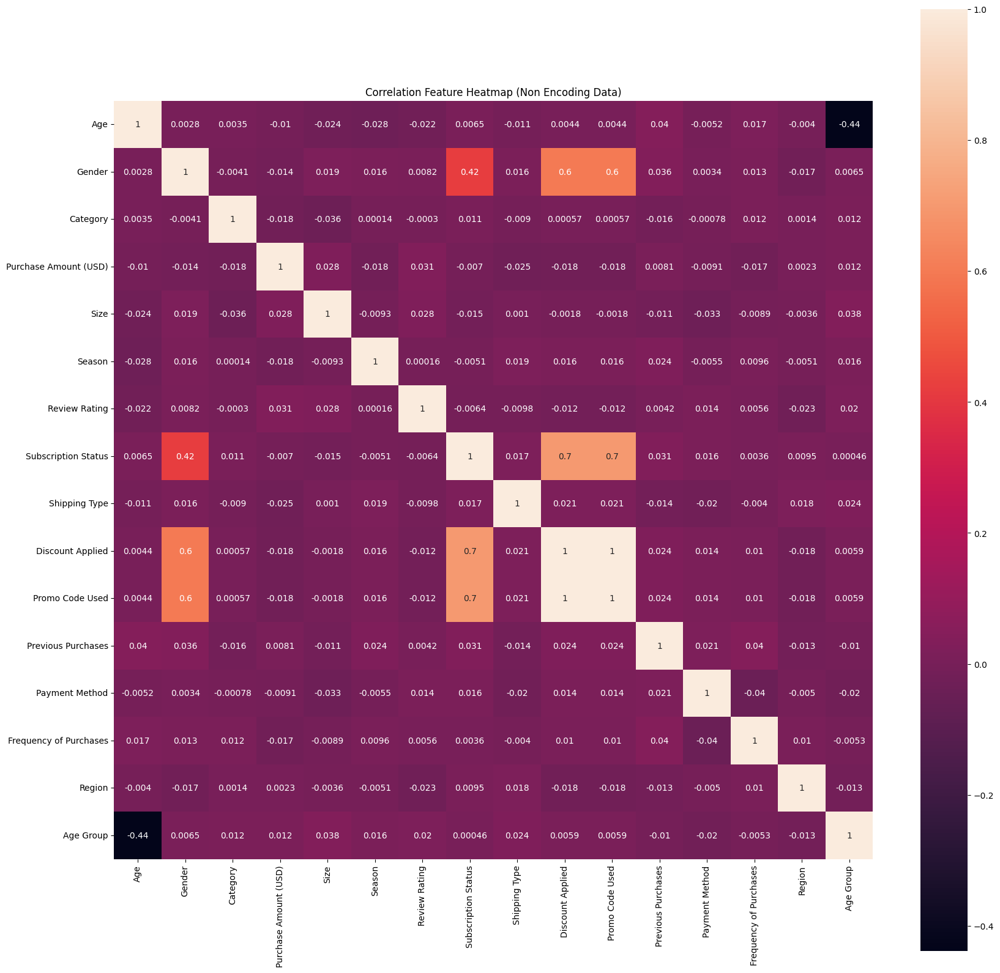

In [69]:
corrmat = nan_encoding_data.corr(method='pearson')
f, ax = plt.subplots(figsize=(20, 20))
sns.heatmap(corrmat, annot=True, vmax=1, square=True);
plt.title('Correlation Feature Heatmap (Non Encoding Data)');
plt.show()

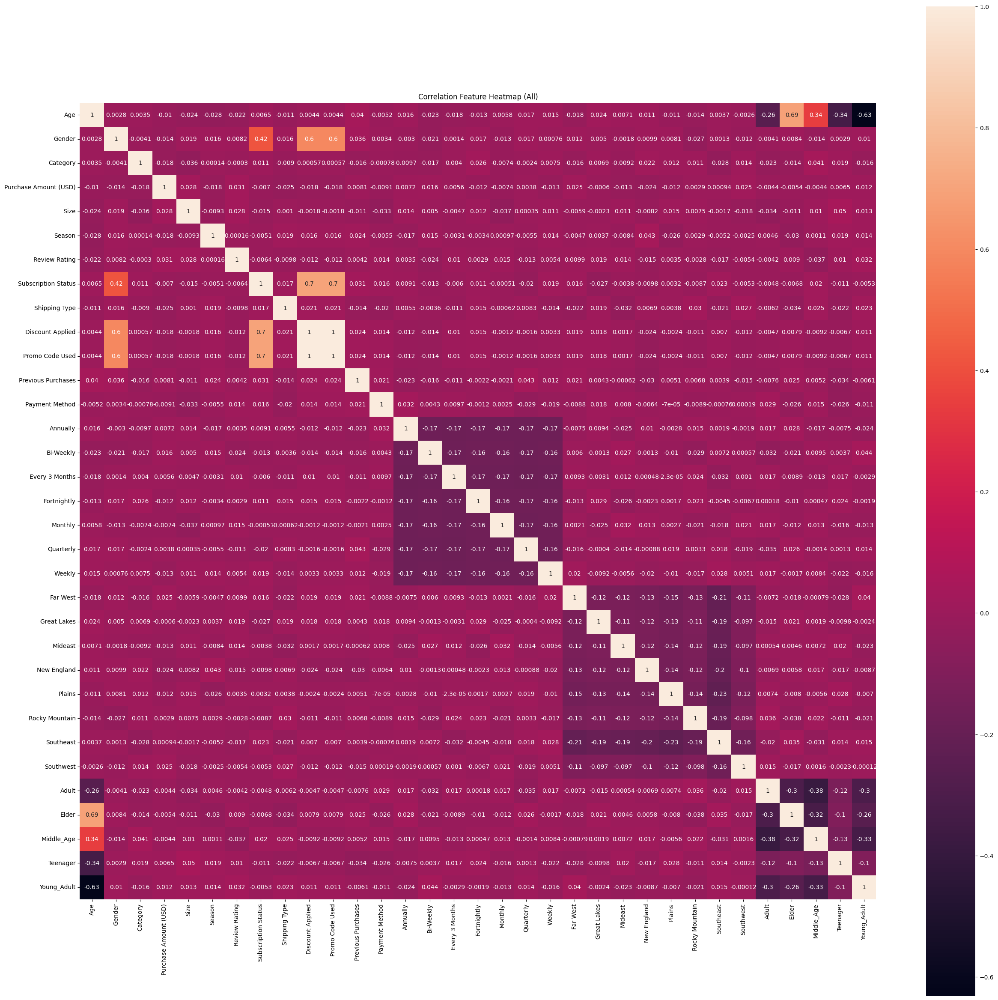

In [70]:
corrmat = processed_data.corr(method='pearson')
f, ax = plt.subplots(figsize=(30, 30))
sns.heatmap(corrmat, annot=True, vmax=1, square=True);
plt.title('Correlation Feature Heatmap (All)');
plt.show()

## Feature Selection Using Embedded Method

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

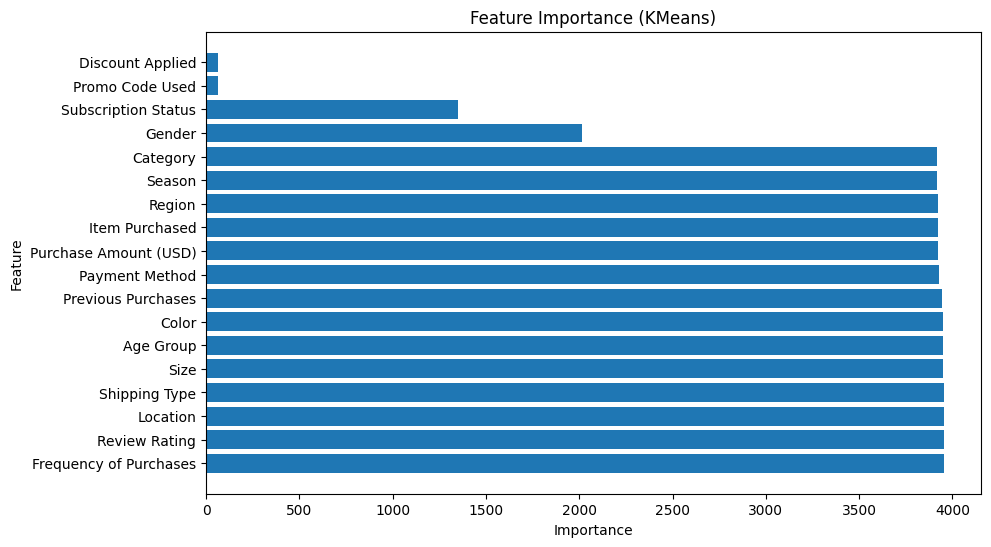

In [71]:
from sklearn.cluster import KMeans
import numpy as np

def calculate_inertia(X, k):
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(X)
    return kmeans.inertia_

def feature_importance_kmeans(X, k):
    baseline_inertia = calculate_inertia(X, k)
    importances = []
    for feature in range(X.shape[1]):
        X_subset = np.delete(X, feature, axis=1)
        inertia = calculate_inertia(X_subset, k)
        importance = baseline_inertia - inertia
        importances.append(importance)
    return importances

# Example usage:
X = X_train_raw.values
k = 5  # Number of clusters
feature_importances = feature_importance_kmeans(X, k)

# Create DataFrame for visualization
importances_df = pd.DataFrame({'Feature': X_train_raw.columns, 'Importance': feature_importances})
importances_df = importances_df.sort_values(by='Importance', ascending=False)

# Plot feature importance
plt.figure(figsize=(10, 6))
plt.barh(importances_df['Feature'], importances_df['Importance'])
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.title('Feature Importance (KMeans)')
plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

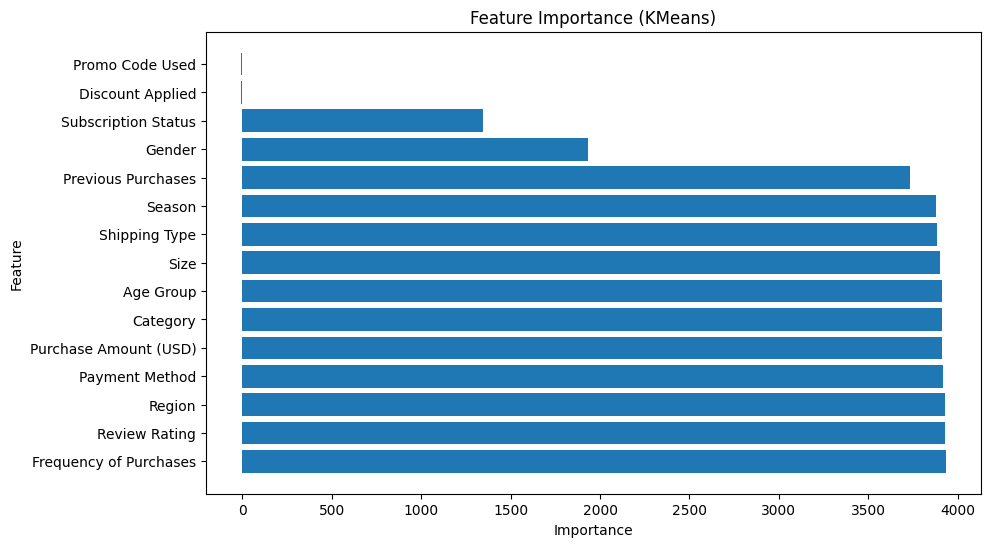

In [72]:
# Example usage:
X = X_train_enco.values  # Assuming X_train is your feature matrix
k = 5  # Number of clusters
feature_importances = feature_importance_kmeans(X, k)

# Create DataFrame for visualization
importances_df = pd.DataFrame({'Feature': X_train_enco.columns, 'Importance': feature_importances})
importances_df = importances_df.sort_values(by='Importance', ascending=False)

# Plot feature importance
plt.figure(figsize=(10, 6))
plt.barh(importances_df['Feature'], importances_df['Importance'])
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.title('Feature Importance (KMeans)')
plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

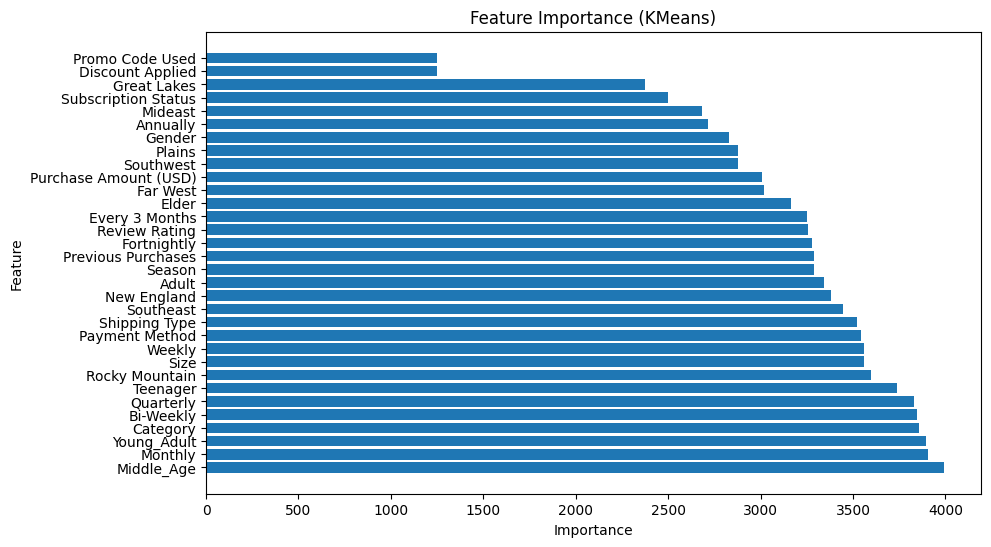

In [73]:
# Example usage:
X = X_train.values  # Assuming X_train is your feature matrix
k = 5  # Number of clusters
feature_importances = feature_importance_kmeans(X, k)

# Create DataFrame for visualization
importances_df = pd.DataFrame({'Feature': X_train.columns, 'Importance': feature_importances})
importances_df = importances_df.sort_values(by='Importance', ascending=False)

# Plot feature importance
plt.figure(figsize=(10, 6))
plt.barh(importances_df['Feature'], importances_df['Importance'])
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.title('Feature Importance (KMeans)')
plt.show()

## Feature Selection PCA Algorithm (Num Data)

Numerical Data

In [136]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import pandas as pd

# Assuming df is your DataFrame with numerical columns only
# num_nan_process = pd.DataFrame(nan_process_data["Age", "Purchase Amount (USD)"])
# Standardizing the features
X_process = StandardScaler().fit_transform(num_data)

# Performing PCA
pca = PCA(n_components=4)  # Adjust n_components based on your needs
principalComponents = pca.fit_transform(X_process)

# Creating a DataFrame with the principal components
df_pca_nan = pd.DataFrame(data=principalComponents, columns=['PC1', 'PC2', 'PC3', 'P4'])

In [137]:
df_pca_nan

,PC1,PC2,PC3,P4
0,-0.679571,-0.875270,0.614511,0.658878
1,1.410280,-1.771317,0.922706,-0.457249
2,-0.420109,-0.106255,1.059586,0.064985
3,0.587576,1.135377,0.641926,-2.164980
4,-1.097818,-0.705935,0.517618,-0.735760
...,...,...,...,...
3895,-0.218962,-0.258706,-1.510175,-0.286120
3896,-0.472555,1.044618,-1.196806,0.047971
3897,-1.045337,-1.233821,-0.037709,-0.307054
3898,0.349887,0.390339,0.508452,0.100101


In [138]:
# Getting the absolute values of the loadings
loadings_abs = abs(pca.components_)

# Sorting the loadings and getting the indices
sorted_indices = loadings_abs.argsort(axis=1)[:, ::-1]

# Getting the feature names
feature_names = num_data.columns

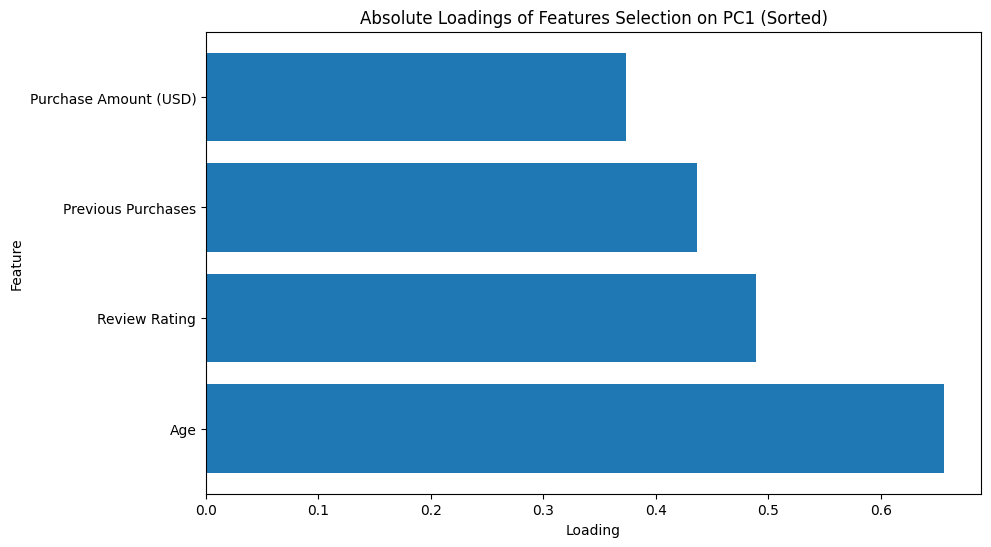

In [139]:
# Get the indices of features sorted by their loadings
sorted_indices_pc1 = np.argsort(-loadings_abs[0])

# Plotting the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(feature_names)), loadings_abs[0, sorted_indices_pc1], align='center')
plt.yticks(range(len(feature_names)), [feature_names[i] for i in sorted_indices_pc1])
plt.xlabel('Loading')
plt.ylabel('Feature')
plt.title('Absolute Loadings of Features Selection on PC1')
plt.show()

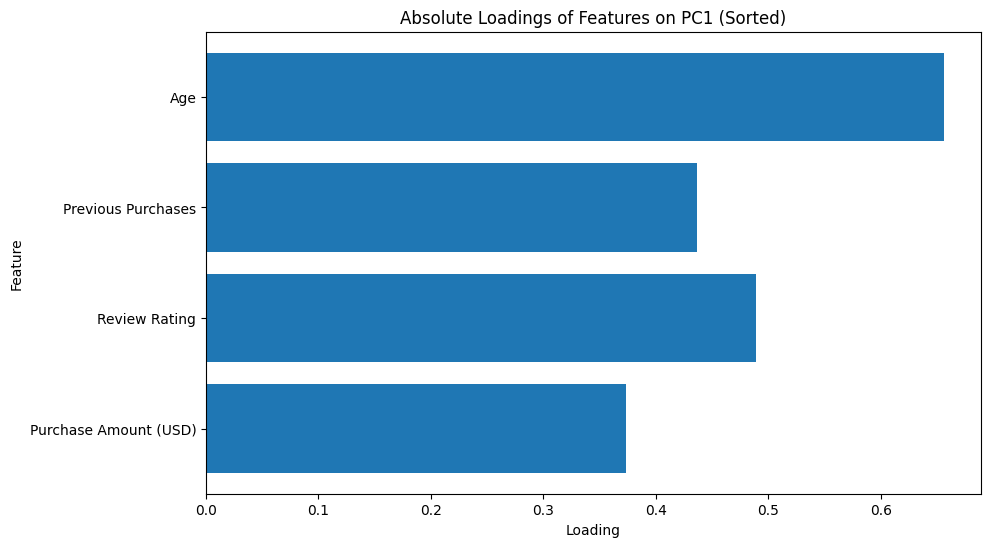

In [154]:
# Get the indices of features sorted by their loadings
sorted_indices_pc1 = np.argsort(-loadings_abs[2])

# Plotting the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(feature_names)), loadings_abs[0, sorted_indices_pc1], align='center')
plt.yticks(range(len(feature_names)), [feature_names[i] for i in sorted_indices_pc1])
plt.xlabel('Loading')
plt.ylabel('Feature')
plt.title('Absolute Loadings of Features on PC1 (Sorted)')
plt.show()

## Chi Square Feature Selection

In [80]:
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2
from sklearn.cluster import KMeans

# Misalkan X adalah matriks fitur dan y adalah target kategorikal
X = num_data
y = process_data['Age Group'].values

# Pilih jumlah fitur yang ingin dipilih
k = 4

# Hitung nilai chi-square untuk setiap fitur
chi2_selector = SelectKBest(chi2, k=k)
X_kbest = chi2_selector.fit_transform(X, y)

# Dapatkan indeks fitur yang terpilih
selected_feature_indices = chi2_selector.get_support(indices=True)

# Lakukan clustering dengan fitur yang dipilih
kmeans = KMeans(n_clusters=3)  # Misalkan jumlah cluster adalah 3
kmeans.fit(X_kbest)
labels = kmeans.labels_

# Lakukan evaluasi clustering jika diperlukan

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


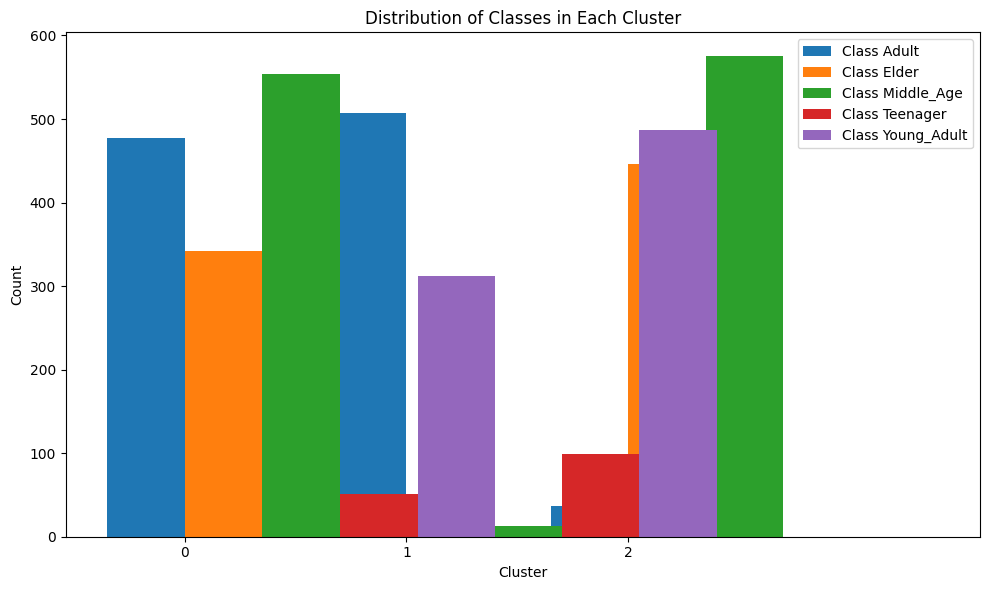

In [81]:
import numpy as np
import matplotlib.pyplot as plt

# Hitung jumlah data dalam setiap klaster
cluster_counts = np.bincount(labels)

# Hitung jumlah data dari setiap kelas di dalam setiap klaster
class_counts = np.zeros((len(np.unique(y)), len(cluster_counts)))
for i, cluster_label in enumerate(np.unique(labels)):
    for j, class_label in enumerate(np.unique(y)):
        class_counts[j, i] = np.sum((labels == cluster_label) & (y == class_label))

# Visualisasikan hasilnya menggunakan bar plot
plt.figure(figsize=(10, 6))
bar_width = 0.35
for i, class_label in enumerate(np.unique(y)):
    plt.bar(np.arange(len(cluster_counts)) + i * bar_width, class_counts[i], bar_width, label=f'Class {class_label}')

plt.xlabel('Cluster')
plt.ylabel('Count')
plt.title('Distribution of Classes in Each Cluster')
plt.xticks(np.arange(len(cluster_counts)) + bar_width / 2, np.arange(len(cluster_counts)))
plt.legend()
plt.tight_layout()
plt.show()


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


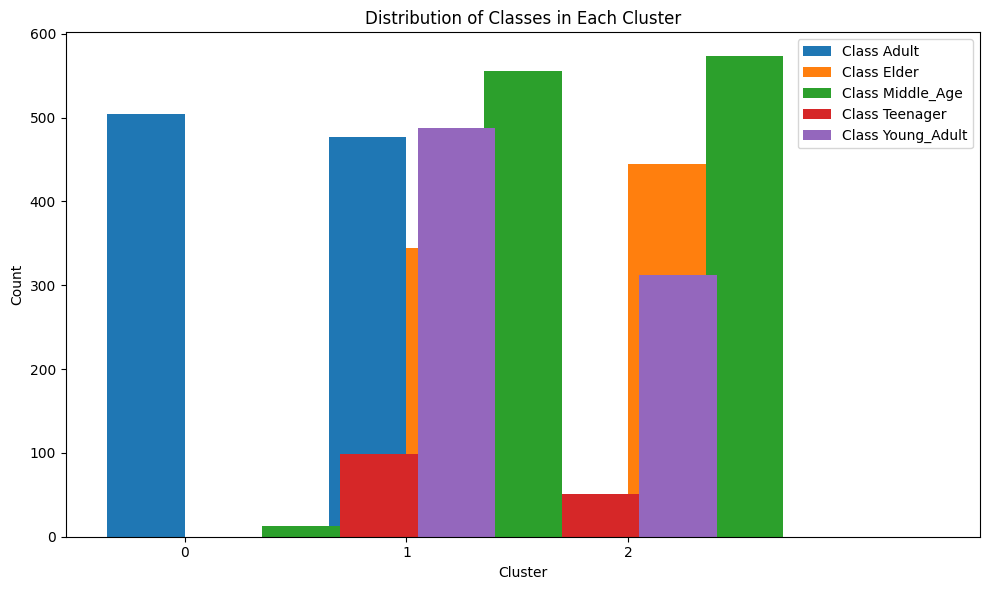

In [82]:
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2
from sklearn.cluster import KMeans
import numpy as np
import matplotlib.pyplot as plt

def chisqtestClust(X, y=None, id=None, p=None, variance='MoM'):
    # X: Matriks atau data frame yang berisi data yang akan dianalisis
    # y: Variabel target (opsional)
    # id: Variabel yang berisi identifikasi unik untuk setiap sampel
    # p: Jumlah fitur yang ingin dipilih (opsional)
    # variance: Metode untuk menghitung variasi (opsional)

    # Lakukan seleksi fitur menggunakan uji chi-square jika y diberikan
    if y is not None:
        chi2_selector = SelectKBest(chi2, k=p)
        X_selected = chi2_selector.fit_transform(X, y)
    else:
        X_selected = X

    # Lakukan clustering menggunakan KMeans
    kmeans = KMeans(n_clusters=3)  # Misalkan jumlah cluster adalah 3
    kmeans.fit(X_selected)
    labels = kmeans.labels_

    # Hitung jumlah data dalam setiap klaster
    cluster_counts = np.bincount(labels)

    # Hitung jumlah data dari setiap kelas di dalam setiap klaster jika y diberikan
    class_counts = None
    if y is not None:
        class_counts = np.zeros((len(np.unique(y)), len(cluster_counts)))
        for i, cluster_label in enumerate(np.unique(labels)):
            for j, class_label in enumerate(np.unique(y)):
                class_counts[j, i] = np.sum((labels == cluster_label) & (y == class_label))

    # Visualisasikan hasil clustering dengan bar plot jika y diberikan
    if y is not None:
        plt.figure(figsize=(10, 6))
        bar_width = 0.35
        for i, class_label in enumerate(np.unique(y)):
            plt.bar(np.arange(len(cluster_counts)) + i * bar_width, class_counts[i], bar_width, label=f'Class {class_label}')
        plt.xlabel('Cluster')
        plt.ylabel('Count')
        plt.title('Distribution of Classes in Each Cluster')
        plt.xticks(np.arange(len(cluster_counts)) + bar_width / 2, np.arange(len(cluster_counts)))
        plt.legend()
        plt.tight_layout()
        plt.show()

# Contoh penggunaan:
# Misalkan X adalah matriks fitur dan y adalah target kategorikal
# X harus berupa fitur-fitur numerik
# y adalah target kategorikal
# Anda juga dapat menyertakan id untuk identifikasi unik
# Variabel p menentukan jumlah fitur yang ingin dipilih (opsional)
chisqtestClust(X, y, id=None, p=4)


In [155]:
chi_data = processed_data.copy()

In [156]:
chi_data.nunique()

Age                      53
Gender                    2
Category                  4
Purchase Amount (USD)    81
Size                      4
Season                    4
Review Rating            26
Subscription Status       2
Shipping Type             6
Discount Applied          2
Promo Code Used           2
Previous Purchases       50
Payment Method            6
Annually                  2
Bi-Weekly                 2
Every 3 Months            2
Fortnightly               2
Monthly                   2
Quarterly                 2
Weekly                    2
Far West                  2
Great Lakes               2
Mideast                   2
New England               2
Plains                    2
Rocky Mountain            2
Southeast                 2
Southwest                 2
Adult                     2
Elder                     2
Middle_Age                2
Teenager                  2
Young_Adult               2
dtype: int64

In [157]:
all = list(chi_data.columns)
all.remove("Age")
all.remove("Purchase Amount (USD)")
all.remove("Previous Purchases")

In [158]:
chi_data.head()

,Age,Gender,Category,Purchase Amount (USD),Size,Season,Review Rating,Subscription Status,Shipping Type,Discount Applied,...,New England,Plains,Rocky Mountain,Southeast,Southwest,Adult,Elder,Middle_Age,Teenager,Young_Adult
0,55,1,1,53,0,3,3.1,1,1,1,...,0,0,0,1,0,0,0,1,0,0
1,19,1,1,64,0,3,3.1,1,1,1,...,1,0,0,0,0,0,0,0,1,0
2,50,1,1,73,2,1,3.1,1,2,1,...,1,0,0,0,0,0,0,1,0,0
3,21,1,2,90,1,1,3.5,1,3,1,...,1,0,0,0,0,0,0,0,0,1
4,45,1,1,49,1,1,2.7,1,2,1,...,0,0,0,0,0,0,0,1,0,0


In [159]:
X = chi_data[all]
y = chi_data[["Purchase Amount (USD)"]]

In [160]:
from sklearn.model_selection import train_test_split

In [161]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state = 42)

In [162]:
f_score = chi2(X_train, y_train)

In [163]:
f_score

(array([ 20.25240301,  53.85539325,  57.86095936,  71.40122056,
         10.16854701,  67.46968704,  88.64577147,  50.56984226,
         50.56984226, 123.93903186,  67.52959201,  62.83619064,
         64.03212768,  85.6436223 ,  78.73877895,  69.27734732,
         80.8433059 ,  67.21607218,  74.79018924,  86.10792578,
         69.95594073,  54.42471471,  79.99921842,  54.11895469,
         65.44084346,  47.56592243,  46.94183383,  45.40895638,
         84.95874504,  69.19584566]),
 array([1.        , 0.98909636, 0.97062554, 0.74298556, 1.        ,
        0.83993232, 0.23804427, 0.99586114, 0.99586114, 0.00119489,
        0.83863791, 0.92139657, 0.90389547, 0.31259042, 0.51891544,
        0.79827992, 0.45258764, 0.84534538, 0.643616  , 0.3003083 ,
        0.78131562, 0.98729481, 0.47899574, 0.9882904 , 0.88015183,
        0.99851851, 0.99882548, 0.9993553 , 0.33117396, 0.80027031]))

In [164]:
pvalues = pd.Series(f_score[1])
pvalues.index = X_train.columns

In [165]:
pvalues = pvalues.sort_values(ascending=True)
pvalues

Payment Method         0.001195
Shipping Type          0.238044
Mideast                0.300308
Fortnightly            0.312590
Teenager               0.331174
Weekly                 0.452588
Rocky Mountain         0.478996
Monthly                0.518915
Great Lakes            0.643616
Season                 0.742986
New England            0.781316
Quarterly              0.798280
Young_Adult            0.800270
Annually               0.838638
Subscription Status    0.839932
Far West               0.845345
Southwest              0.880152
Every 3 Months         0.903895
Bi-Weekly              0.921397
Size                   0.970626
Plains                 0.987295
Southeast              0.988290
Category               0.989096
Discount Applied       0.995861
Promo Code Used        0.995861
Adult                  0.998519
Elder                  0.998825
Middle_Age             0.999355
Gender                 1.000000
Review Rating          1.000000
dtype: float64

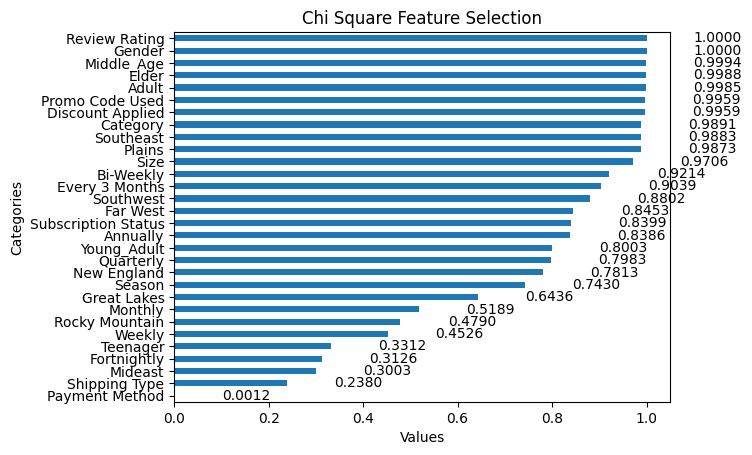

In [166]:
ax = pvalues.plot(kind='barh')

# Adding labels to each bar
for i, v in enumerate(pvalues):
    ax.text(v + 0.1, i, "{:.4f}".format(v), ha='left', va='center')

# Adding labels and title
plt.xlabel('Values')
plt.ylabel('Categories')
plt.title('Chi Square Feature Selection')

# Display the plot
plt.show()

## Preparing Model Evaluation

In [97]:
clus_score = pd.DataFrame(columns=["Model", "Silhouette Score"])

In [98]:
X_column = 'Age'
y_column = 'Purchase Amount (USD)'

# NEW PREPROCESSING

In [186]:
encoded_df = pd.read_csv("we are the worl.csv")
encoded_df

,Unnamed: 0,Customer ID,Age,Purchase Amount (USD),Review Rating,Previous Purchases,Gender_Male,Item Purchased_Belt,Item Purchased_Blouse,Item Purchased_Boots,...,Region_Rocky Mountain,Region_Southeast,Region_Southwest,Age_group_Elder,Age_group_Older_Adult,Age_group_Teenage,Age_group_Younger_Adult,Generation_Gen X,Generation_Gen Z,Generation_Millenials
0,0,1,55,53,3.1,14,1,0,1,0,...,0,1,0,0,1,0,0,1,0,0
1,1,2,19,64,3.1,2,1,0,0,0,...,0,0,0,0,0,1,0,0,1,0
2,2,3,50,73,3.1,23,1,0,0,0,...,0,0,0,0,1,0,0,1,0,0
3,3,4,21,90,3.5,49,1,0,0,0,...,0,0,0,0,0,0,1,0,1,0
4,4,5,45,49,2.7,31,1,0,1,0,...,0,0,0,0,1,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3895,3895,3896,40,28,4.2,32,0,0,0,0,...,0,1,0,0,0,0,0,0,0,1
3896,3896,3897,52,49,4.5,41,0,0,0,0,...,0,0,0,0,1,0,0,1,0,0
3897,3897,3898,46,33,2.9,24,0,1,0,0,...,0,0,0,0,1,0,0,1,0,0
3898,3898,3899,44,77,3.8,24,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1


## Feature Selection Using Correlation

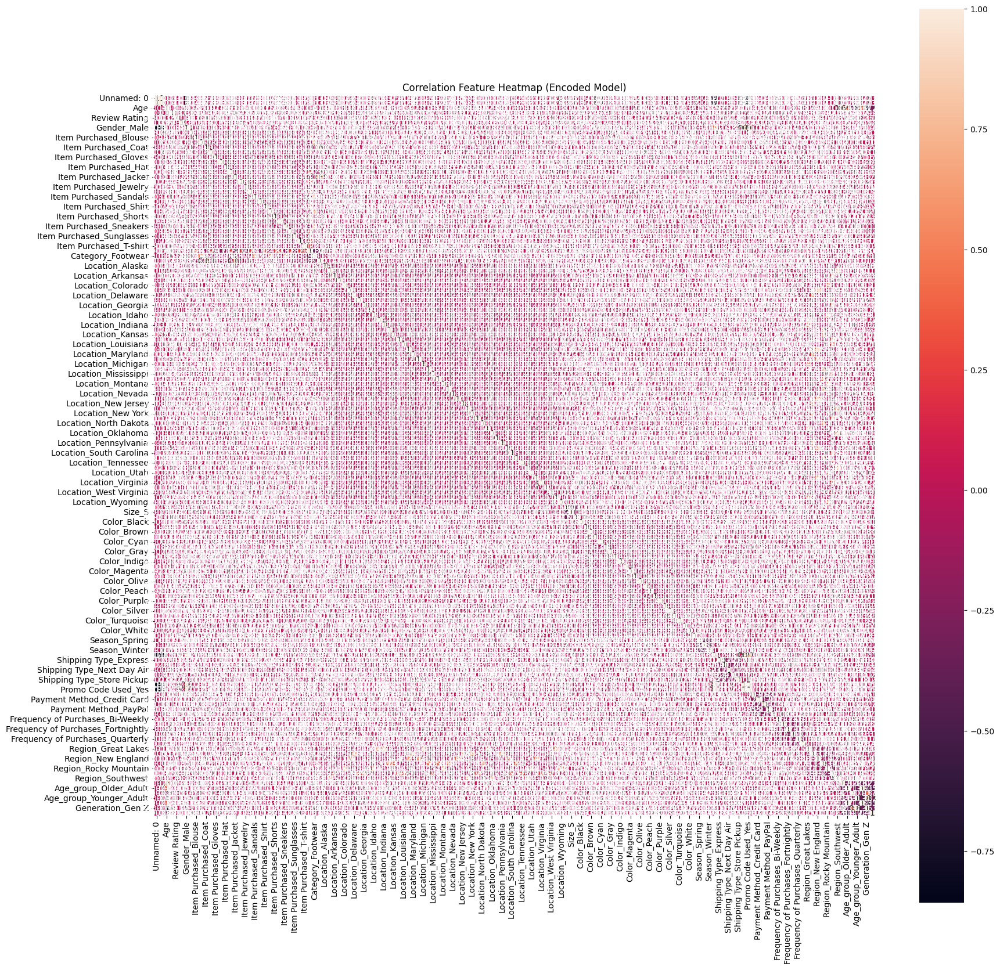

In [188]:
# corrmat = encoded_df.corr(method='pearson')
# f, ax = plt.subplots(figsize=(20, 20))
# sns.heatmap(corrmat, annot=True, vmax=1, square=True);
# plt.title('Correlation Feature Heatmap (Encoded Model)');
# plt.show()

## Feature Selection Using Embedded Method

In [192]:
X_train_enco_all = encoded_df.drop('Age', axis=1)
y_train_enco_all = encoded_df['Age']

print("X_train (Raw Column) shape:", X_train_enco_all.shape)
print("y_train (Raw Column) shape:", X_train_enco_all.shape, "\n")

X_train (Raw Column) shape: (3900, 145)
y_train (Raw Column) shape: (3900, 145) 



In [193]:
from sklearn.cluster import KMeans
import numpy as np

def calculate_inertia(X, k):
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(X)
    return kmeans.inertia_

def feature_importance_kmeans(X, k):
    baseline_inertia = calculate_inertia(X, k)
    importances = []
    for feature in range(X.shape[1]):
        X_subset = np.delete(X, feature, axis=1)
        inertia = calculate_inertia(X_subset, k)
        importance = baseline_inertia - inertia
        importances.append(importance)
    return importances

In [194]:
# Example usage:
X = X_train_enco_all.values
k = 5  # Number of clusters
feature_importances = feature_importance_kmeans(X, k)

# Create DataFrame for visualization
importances_df = pd.DataFrame({'Feature': X_train_raw.columns, 'Importance': feature_importances})
importances_df = importances_df.sort_values(by='Importance', ascending=False)

# Plot feature importance
plt.figure(figsize=(10, 6))
plt.barh(importances_df['Feature'], importances_df['Importance'])
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.title('Feature Importance (KMeans)')
plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

ValueError: All arrays must be of the same length

## Feature Selection PCA Algorithm (Num Data)

Numerical Data

In [195]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import pandas as pd

# Assuming df is your DataFrame with numerical columns only
# num_nan_process = pd.DataFrame(nan_process_data["Age", "Purchase Amount (USD)"])
# Standardizing the features
X_process = StandardScaler().fit_transform(encoded_df)

# Performing PCA
pca = PCA(n_components=4)  # Adjust n_components based on your needs
principalComponents = pca.fit_transform(X_process)

# Creating a DataFrame with the principal components
df_pca_nan = pd.DataFrame(data=principalComponents, columns=['PC1', 'PC2', 'PC3', 'P4'])

In [196]:
df_pca_nan

,PC1,PC2,PC3,P4
0,3.235809,-1.795867,-1.836829,1.327814
1,3.216006,3.008727,-1.007195,-1.998790
2,3.374475,-1.988030,-1.670683,-1.709862
3,3.176492,2.193783,2.230510,-0.884681
4,3.192754,-1.841196,-1.423842,-0.829490
...,...,...,...,...
3895,-2.833749,0.622878,-1.891795,2.290242
3896,-2.769241,-1.787442,1.293995,-0.800074
3897,-3.024403,-1.771447,0.803659,-0.585616
3898,-2.908604,-0.175800,3.269086,0.099409


In [197]:
# Getting the absolute values of the loadings
loadings_abs = abs(pca.components_)

# Sorting the loadings and getting the indices
sorted_indices = loadings_abs.argsort(axis=1)[:, ::-1]

# Getting the feature names
feature_names = num_data.columns

ValueError: shape mismatch: objects cannot be broadcast to a single shape.  Mismatch is between arg 2 with shape (146,) and arg 3 with shape (4,).

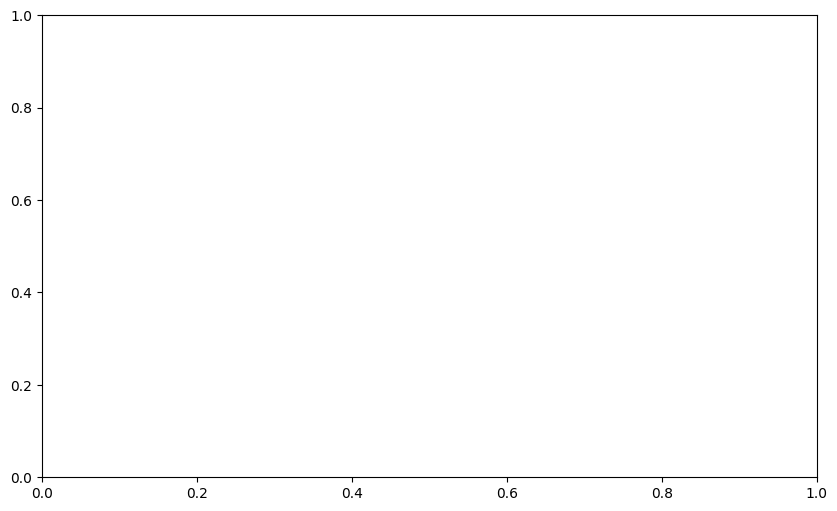

In [198]:
# Get the indices of features sorted by their loadings
sorted_indices_pc1 = np.argsort(-loadings_abs[0])

# Plotting the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(feature_names)), loadings_abs[0, sorted_indices_pc1], align='center')
plt.yticks(range(len(feature_names)), [feature_names[i] for i in sorted_indices_pc1])
plt.xlabel('Loading')
plt.ylabel('Feature')
plt.title('Absolute Loadings of Features Selection on PC1')
plt.show()

ValueError: shape mismatch: objects cannot be broadcast to a single shape.  Mismatch is between arg 2 with shape (146,) and arg 3 with shape (4,).

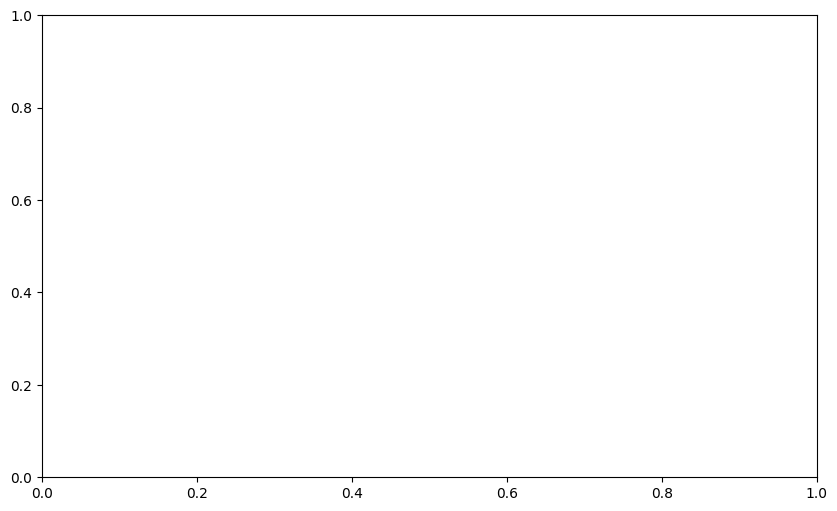

In [199]:
# Get the indices of features sorted by their loadings
sorted_indices_pc1 = np.argsort(-loadings_abs[2])

# Plotting the bar plot
plt.figure(figsize=(10, 6))
plt.barh(range(len(feature_names)), loadings_abs[0, sorted_indices_pc1], align='center')
plt.yticks(range(len(feature_names)), [feature_names[i] for i in sorted_indices_pc1])
plt.xlabel('Loading')
plt.ylabel('Feature')
plt.title('Absolute Loadings of Features on PC1 (Sorted)')
plt.show()

## Chi Square Feature Selection

In [203]:
encoded_df[["Item Purchased_Belt"]]

,Item Purchased_Belt
0,0
1,0
2,0
3,0
4,0
...,...
3895,0
3896,0
3897,1
3898,0


In [205]:
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2
from sklearn.cluster import KMeans

# Misalkan X adalah matriks fitur dan y adalah target kategorikal
X = encoded_df
y = encoded_df['Item Purchased_Belt'].values

# Pilih jumlah fitur yang ingin dipilih
k = 4

# Hitung nilai chi-square untuk setiap fitur
chi2_selector = SelectKBest(chi2, k=k)
X_kbest = chi2_selector.fit_transform(X, y)

# Dapatkan indeks fitur yang terpilih
selected_feature_indices = chi2_selector.get_support(indices=True)

# Lakukan clustering dengan fitur yang dipilih
kmeans = KMeans(n_clusters=3)  # Misalkan jumlah cluster adalah 3
kmeans.fit(X_kbest)
labels = kmeans.labels_

# Lakukan evaluasi clustering jika diperlukan

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


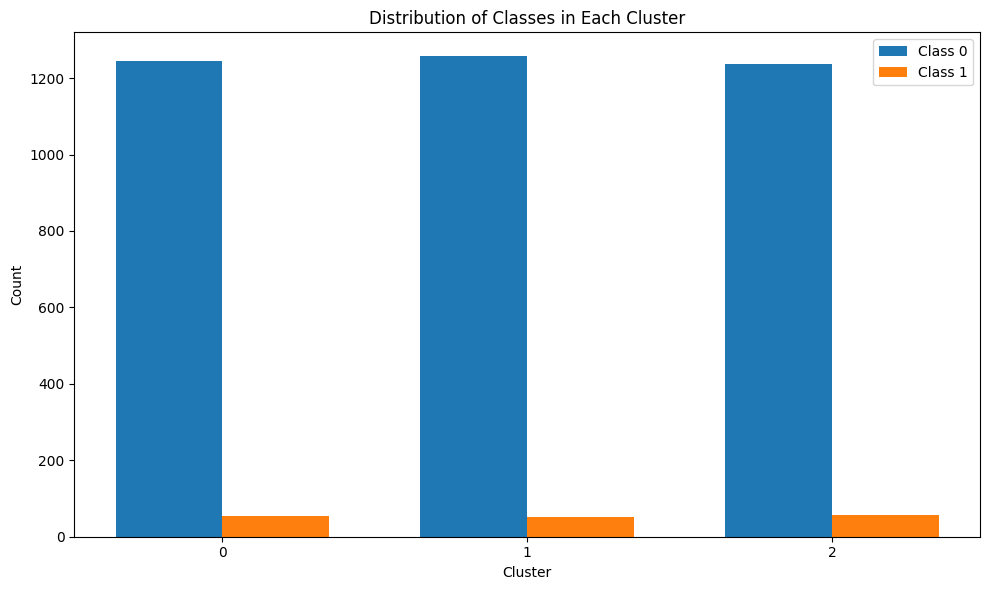

In [206]:
import numpy as np
import matplotlib.pyplot as plt

# Hitung jumlah data dalam setiap klaster
cluster_counts = np.bincount(labels)

# Hitung jumlah data dari setiap kelas di dalam setiap klaster
class_counts = np.zeros((len(np.unique(y)), len(cluster_counts)))
for i, cluster_label in enumerate(np.unique(labels)):
    for j, class_label in enumerate(np.unique(y)):
        class_counts[j, i] = np.sum((labels == cluster_label) & (y == class_label))

# Visualisasikan hasilnya menggunakan bar plot
plt.figure(figsize=(10, 6))
bar_width = 0.35
for i, class_label in enumerate(np.unique(y)):
    plt.bar(np.arange(len(cluster_counts)) + i * bar_width, class_counts[i], bar_width, label=f'Class {class_label}')

plt.xlabel('Cluster')
plt.ylabel('Count')
plt.title('Distribution of Classes in Each Cluster')
plt.xticks(np.arange(len(cluster_counts)) + bar_width / 2, np.arange(len(cluster_counts)))
plt.legend()
plt.tight_layout()
plt.show()


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


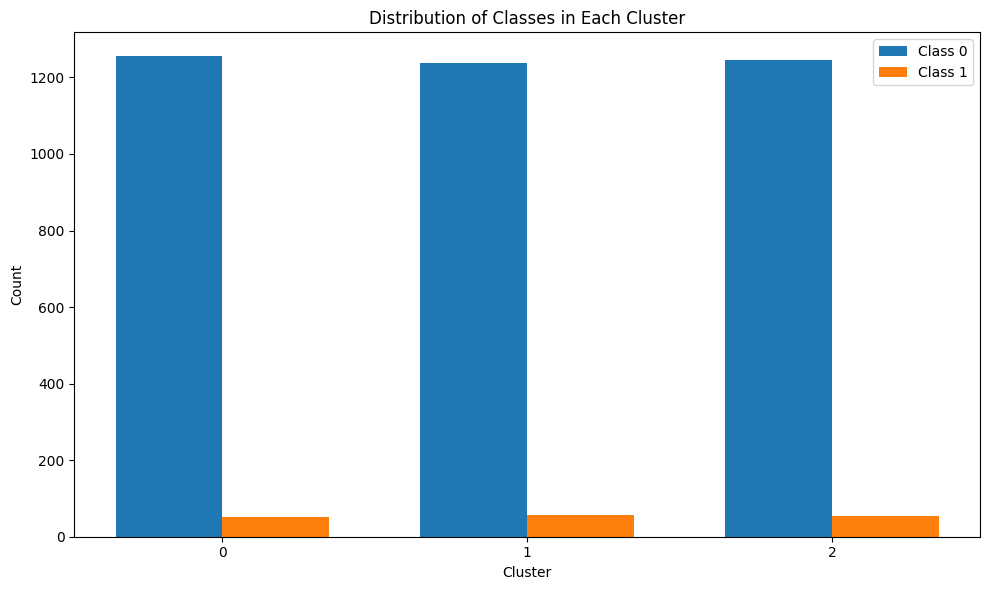

In [207]:
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2
from sklearn.cluster import KMeans
import numpy as np
import matplotlib.pyplot as plt

def chisqtestClust(X, y=None, id=None, p=None, variance='MoM'):
    # X: Matriks atau data frame yang berisi data yang akan dianalisis
    # y: Variabel target (opsional)
    # id: Variabel yang berisi identifikasi unik untuk setiap sampel
    # p: Jumlah fitur yang ingin dipilih (opsional)
    # variance: Metode untuk menghitung variasi (opsional)

    # Lakukan seleksi fitur menggunakan uji chi-square jika y diberikan
    if y is not None:
        chi2_selector = SelectKBest(chi2, k=p)
        X_selected = chi2_selector.fit_transform(X, y)
    else:
        X_selected = X

    # Lakukan clustering menggunakan KMeans
    kmeans = KMeans(n_clusters=3)  # Misalkan jumlah cluster adalah 3
    kmeans.fit(X_selected)
    labels = kmeans.labels_

    # Hitung jumlah data dalam setiap klaster
    cluster_counts = np.bincount(labels)

    # Hitung jumlah data dari setiap kelas di dalam setiap klaster jika y diberikan
    class_counts = None
    if y is not None:
        class_counts = np.zeros((len(np.unique(y)), len(cluster_counts)))
        for i, cluster_label in enumerate(np.unique(labels)):
            for j, class_label in enumerate(np.unique(y)):
                class_counts[j, i] = np.sum((labels == cluster_label) & (y == class_label))

    # Visualisasikan hasil clustering dengan bar plot jika y diberikan
    if y is not None:
        plt.figure(figsize=(10, 6))
        bar_width = 0.35
        for i, class_label in enumerate(np.unique(y)):
            plt.bar(np.arange(len(cluster_counts)) + i * bar_width, class_counts[i], bar_width, label=f'Class {class_label}')
        plt.xlabel('Cluster')
        plt.ylabel('Count')
        plt.title('Distribution of Classes in Each Cluster')
        plt.xticks(np.arange(len(cluster_counts)) + bar_width / 2, np.arange(len(cluster_counts)))
        plt.legend()
        plt.tight_layout()
        plt.show()

# Contoh penggunaan:
# Misalkan X adalah matriks fitur dan y adalah target kategorikal
# X harus berupa fitur-fitur numerik
# y adalah target kategorikal
# Anda juga dapat menyertakan id untuk identifikasi unik
# Variabel p menentukan jumlah fitur yang ingin dipilih (opsional)
chisqtestClust(X, y, id=None, p=4)


In [208]:
chi_data = encoded_df.copy()

In [209]:
chi_data.nunique()

Unnamed: 0                 3900
Customer ID                3900
Age                          53
Purchase Amount (USD)        81
Review Rating                26
                           ... 
Age_group_Teenage             2
Age_group_Younger_Adult       2
Generation_Gen X              2
Generation_Gen Z              2
Generation_Millenials         2
Length: 146, dtype: int64

In [212]:
all = list(chi_data.columns)
all.remove("Age")
all.remove("Purchase Amount (USD)")
all.remove("Previous Purchases")
all.remove("Customer ID")

In [213]:
chi_data.head()

,Unnamed: 0,Customer ID,Age,Purchase Amount (USD),Review Rating,Previous Purchases,Gender_Male,Item Purchased_Belt,Item Purchased_Blouse,Item Purchased_Boots,...,Region_Rocky Mountain,Region_Southeast,Region_Southwest,Age_group_Elder,Age_group_Older_Adult,Age_group_Teenage,Age_group_Younger_Adult,Generation_Gen X,Generation_Gen Z,Generation_Millenials
0,0,1,55,53,3.1,14,1,0,1,0,...,0,1,0,0,1,0,0,1,0,0
1,1,2,19,64,3.1,2,1,0,0,0,...,0,0,0,0,0,1,0,0,1,0
2,2,3,50,73,3.1,23,1,0,0,0,...,0,0,0,0,1,0,0,1,0,0
3,3,4,21,90,3.5,49,1,0,0,0,...,0,0,0,0,0,0,1,0,1,0
4,4,5,45,49,2.7,31,1,0,1,0,...,0,0,0,0,1,0,0,1,0,0


In [214]:
X = chi_data[all]
y = chi_data[["Purchase Amount (USD)"]]

In [215]:
from sklearn.model_selection import train_test_split

In [216]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state = 42)

In [217]:
f_score = chi2(X_train, y_train)

In [218]:
f_score

(array([4.85812595e+04, 1.01685470e+01, 2.02524030e+01, 8.69991532e+01,
        4.79684305e+01, 6.71160855e+01, 7.45644550e+01, 8.52206907e+01,
        7.72852223e+01, 1.11325427e+02, 5.86350206e+01, 7.11356538e+01,
        7.34223378e+01, 7.14871991e+01, 6.94380770e+01, 8.52418118e+01,
        5.20500997e+01, 8.01055470e+01, 6.40874071e+01, 1.00225596e+02,
        6.88763972e+01, 7.52168988e+01, 5.51405175e+01, 7.57171975e+01,
        7.06702731e+01, 6.84658245e+01, 6.59364345e+01, 4.14147014e+01,
        5.85508773e+01, 6.49657292e+01, 6.87070061e+01, 1.10907587e+02,
        6.79565205e+01, 7.24803917e+01, 7.69469437e+01, 7.94279534e+01,
        8.03107930e+01, 6.93161429e+01, 8.37367605e+01, 8.69637185e+01,
        8.96179952e+01, 7.09921611e+01, 7.84781022e+01, 6.69074341e+01,
        7.22142411e+01, 6.74794959e+01, 7.03637279e+01, 6.06580930e+01,
        1.15086758e+02, 8.51917100e+01, 8.86897948e+01, 6.46400113e+01,
        8.02997789e+01, 9.56649154e+01, 6.61825220e+01, 7.252496

In [219]:
pvalues = pd.Series(f_score[1])
pvalues.index = X_train.columns

In [220]:
pvalues = pvalues.sort_values(ascending=True)
pvalues

Unnamed: 0                0.000000
Location_Maryland         0.006222
Item Purchased_Handbag    0.011826
Location_Arizona          0.012671
Color_Magenta             0.051711
                            ...   
Generation_Gen X          0.999355
Size_M                    0.999880
Category_Clothing         0.999891
Gender_Male               1.000000
Review Rating             1.000000
Length: 142, dtype: float64

In [222]:
plt.figure(figsize=(100,100))
ax = pvalues.plot(kind='barh')

# Adding labels to each bar
for i, v in enumerate(pvalues):
    ax.text(v + 0.1, i, "{:.4f}".format(v), ha='left', va='center')

# Adding labels and title
plt.xlabel('Values')
plt.ylabel('Categories')
plt.title('Chi Square Feature Selection')

# Display the plot
plt.show()

# Modeling (All Preprocessing)

## Preparing

In [99]:
processed_data.head()

,Age,Gender,Category,Purchase Amount (USD),Size,Season,Review Rating,Subscription Status,Shipping Type,Discount Applied,...,New England,Plains,Rocky Mountain,Southeast,Southwest,Adult,Elder,Middle_Age,Teenager,Young_Adult
0,55,1,1,53,0,3,3.1,1,1,1,...,0,0,0,1,0,0,0,1,0,0
1,19,1,1,64,0,3,3.1,1,1,1,...,1,0,0,0,0,0,0,0,1,0
2,50,1,1,73,2,1,3.1,1,2,1,...,1,0,0,0,0,0,0,1,0,0
3,21,1,2,90,1,1,3.5,1,3,1,...,1,0,0,0,0,0,0,0,0,1
4,45,1,1,49,1,1,2.7,1,2,1,...,0,0,0,0,0,0,0,1,0,0


In [100]:
X = nan_encoding_data[["Age", "Purchase Amount (USD)"]]
X.head()

,Age,Purchase Amount (USD)
0,55,53
1,19,64
2,50,73
3,21,90
4,45,49


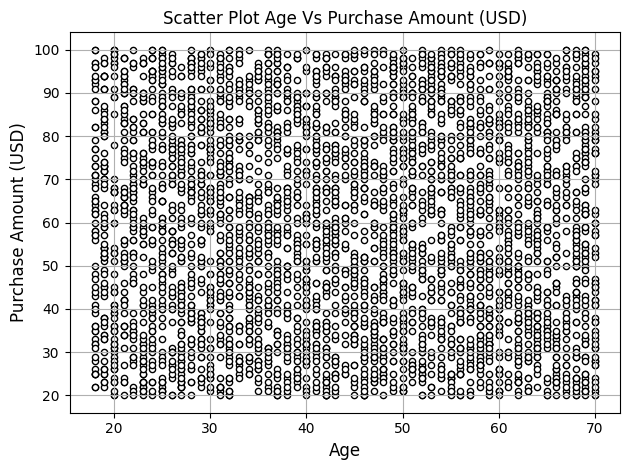

In [101]:
plt.scatter(processed_data[X_column],
            processed_data[y_column],
            c='white',
            marker='o',
            edgecolor='black',
            s=20)
plt.grid()
plt.title(f"Scatter Plot {X_column} Vs {y_column}")
plt.xlabel(X_column, fontsize=12)
plt.ylabel(y_column, fontsize=12)
plt.tight_layout()
plt.show()

## Scaling

In [102]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
scaler.fit(X)

X_scaled = scaler.transform(X)

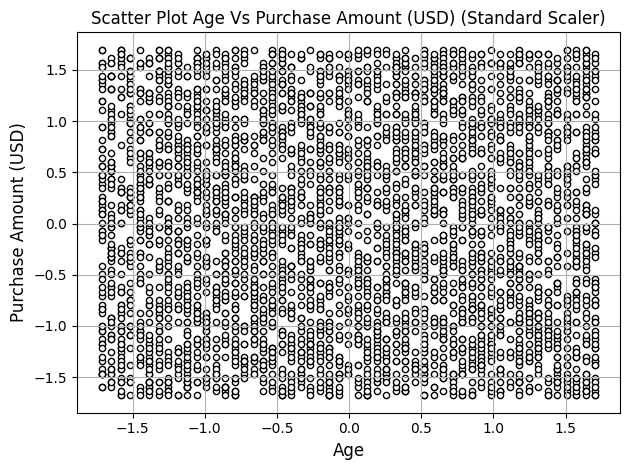

In [103]:
plt.scatter(X_scaled[:, 0],
            X_scaled[:, 1],
            c='white',
            marker='o',
            edgecolor='black',
            s=20)
plt.grid()
plt.title(f"Scatter Plot {X_column} Vs {y_column} (Standard Scaler)")
plt.xlabel(X_column, fontsize=12)
plt.ylabel(y_column, fontsize=12)
plt.tight_layout()
plt.show()

In [104]:
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()
scaler.fit(X)

X_scaled_mm = scaler.transform(X)

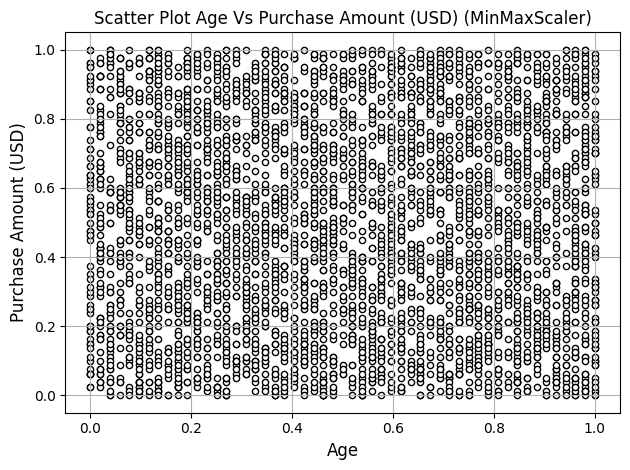

In [105]:
plt.scatter(X_scaled_mm[:, 0],
            X_scaled_mm[:, 1],
            c='white',
            marker='o',
            edgecolor='black',
            s=20)
plt.grid()
plt.title(f"Scatter Plot {X_column} Vs {y_column} (MinMaxScaler)")
plt.xlabel(X_column, fontsize=12)
plt.ylabel(y_column, fontsize=12)
plt.tight_layout()
plt.show()

## KMeans Clustering

In [106]:
from sklearn.cluster import KMeans

# n_init : cara inisilisasi
km = KMeans(n_clusters=4, random_state=0, n_init="auto")
km.fit(X_scaled)

y_km = km.predict(X_scaled)

In [107]:
# for i in range(2, 11):
#     kmeans = KMeans(n_clusters=i, init='k-means++', max_iter=300, n_init=10, random_state=0)
#     clusters = kmeans.fit_predict(X)
#     silhouette_avg = silhouette_score(X, clusters)
#     silhouette_scores.append(silhouette_avg)

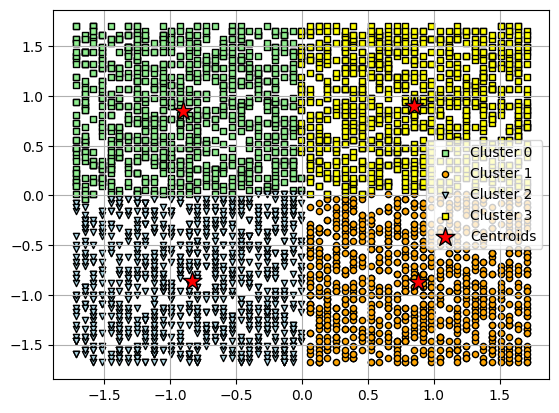

In [108]:
plt.scatter(X_scaled[y_km == 0, 0],
            X_scaled[y_km == 0, 1],
            s=20,
            c='lightgreen',
            marker='s',
            edgecolor='black',
            label='Cluster 0')

plt.scatter(X_scaled[y_km == 1, 0],
            X_scaled[y_km == 1, 1],
            s=20, c='orange',
            marker='o',
            edgecolor='black',
            label='Cluster 1')

plt.scatter(X_scaled[y_km == 2, 0],
            X_scaled[y_km == 2, 1],
            s=20, c='lightblue',
            marker='v',
            edgecolor='black',
            label='Cluster 2')

plt.scatter(X_scaled[y_km == 3, 0],
            X_scaled[y_km == 3, 1],
            s=20, c='yellow',
            marker='s',
            edgecolor='black',
            label='Cluster 3')

plt.scatter(km.cluster_centers_[:, 0],
            km.cluster_centers_[:, 1],
            s=200, marker='*',
            c='red',
            edgecolor='black',
            label='Centroids')

plt.legend(scatterpoints=1)
plt.grid()

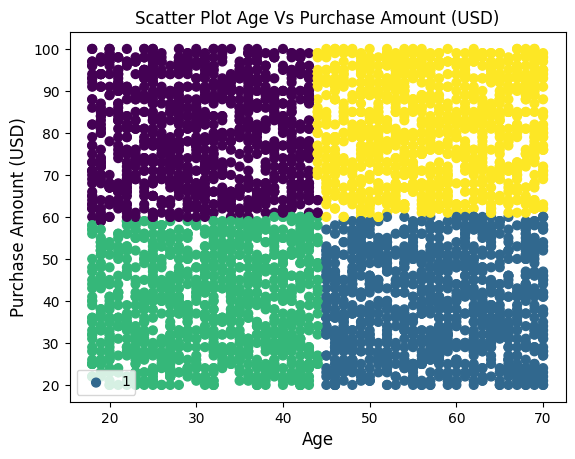

In [109]:
# Plot clusters
plt.scatter(X[X_column], X[y_column], c=y_km, s=40, cmap='viridis')
plt.title(f"Scatter Plot {X_column} Vs {y_column}")
plt.xlabel(X_column, fontsize=12)
plt.ylabel(y_column, fontsize=12)

plt.legend(y_km)
plt.show()

In [110]:
km_mm = KMeans(n_clusters=4, random_state=0, n_init="auto")
km_mm.fit(X_scaled_mm)

y_km_mm = km_mm.predict(X_scaled_mm)

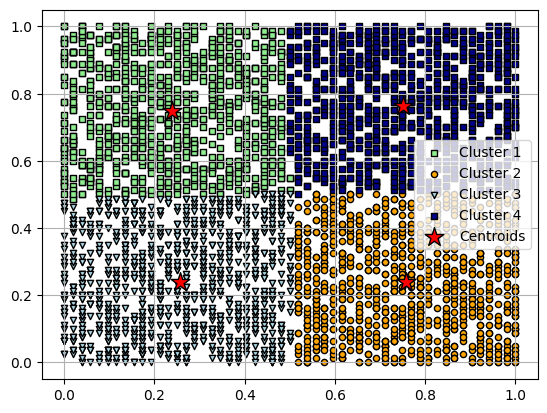

In [111]:
plt.scatter(X_scaled_mm[y_km_mm == 0, 0],
            X_scaled_mm[y_km_mm == 0, 1],
            s=20,
            c='lightgreen',
            marker='s',
            edgecolor='black',
            label='Cluster 1')

plt.scatter(X_scaled_mm[y_km_mm == 1, 0],
            X_scaled_mm[y_km_mm == 1, 1],
            s=20, c='orange',
            marker='o',
            edgecolor='black',
            label='Cluster 2')

plt.scatter(X_scaled_mm[y_km_mm == 2, 0],
            X_scaled_mm[y_km_mm == 2, 1],
            s=20, c='lightblue',
            marker='v',
            edgecolor='black',
            label='Cluster 3')

plt.scatter(X_scaled_mm[y_km_mm == 3, 0],
            X_scaled_mm[y_km_mm == 3, 1],
            s=20, c='darkblue',
            marker='s',
            edgecolor='black',
            label='Cluster 4')

plt.scatter(km_mm.cluster_centers_[:, 0],
            km_mm.cluster_centers_[:, 1],
            s=200, marker='*',
            c='red',
            edgecolor='black',
            label='Centroids')

plt.legend(scatterpoints=1)
plt.grid()

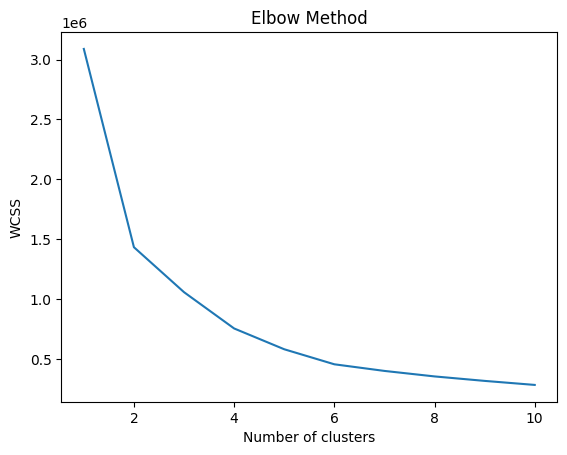

In [112]:
from sklearn.cluster import KMeans

features = process_data[[X_column, y_column]]

wcss = []
for i in range(1, 11):
    kmeans = KMeans(n_clusters=i, init='k-means++', max_iter=500, n_init=10, random_state=0)
    kmeans.fit(features)
    wcss.append(kmeans.inertia_)

plt.plot(range(1, 11), wcss)
plt.title('Elbow Method')
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')
plt.show()

In [113]:
from sklearn.metrics import silhouette_score

In [114]:
score = silhouette_score(X_scaled, y_km)

new_row = {"Model": f"K-Means {X_column} {y_column} SS", "Silhouette Score": score}
clus_score = pd.concat([clus_score, pd.DataFrame([new_row])], ignore_index=True)

clus_score.sort_values(by="Silhouette Score", ascending=False)

,Model,Silhouette Score
0,K-Means Age Purchase Amount (USD) SS,0.413719


In [115]:
score = silhouette_score(X_scaled_mm, y_km_mm)

new_row = {"Model": f"K-Means {X_column} {y_column} MM", "Silhouette Score": score}
clus_score = pd.concat([clus_score, pd.DataFrame([new_row])], ignore_index=True)

clus_score.sort_values(by="Silhouette Score", ascending=False)

,Model,Silhouette Score
0,K-Means Age Purchase Amount (USD) SS,0.413719
1,K-Means Age Purchase Amount (USD) MM,0.413657


In [116]:
pd.DataFrame(y_km).value_counts()

1    986
2    973
0    972
3    969
dtype: int64

In [117]:
kmeans = pd.DataFrame(y_km, columns=["KMeans Cluster"])
kmeans

,KMeans Cluster
0,1
1,0
2,3
3,0
4,1
...,...
3895,2
3896,1
3897,1
3898,3


## Agglomerative Clustering

In [118]:
from sklearn.cluster import AgglomerativeClustering

In [119]:
# Initiating the Agglomerative Clustering model
AC = AgglomerativeClustering(n_clusters=4)

# Fit model and predict clusters
y_pred = AC.fit_predict(X_scaled)

score = silhouette_score(X_scaled, y_pred)
print(f"Silhouette Score: {score}")

Silhouette Score: 0.3723963462947772


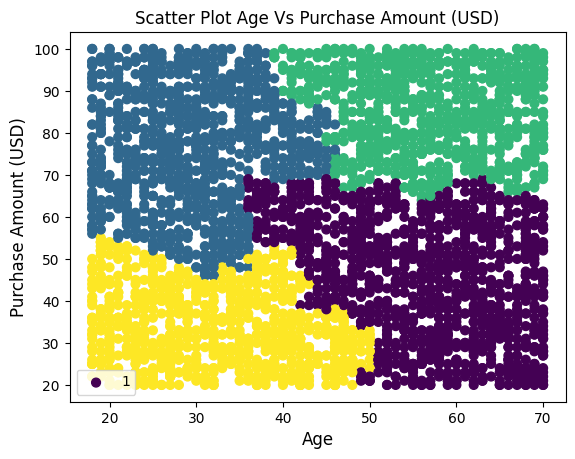

In [120]:
# Plot clusters
plt.scatter(X[X_column], X[y_column], c=y_pred, s=40, cmap='viridis')
plt.title(f"Scatter Plot {X_column} Vs {y_column}")
plt.xlabel(X_column, fontsize=12)
plt.ylabel(y_column, fontsize=12)

plt.legend(y_km)
plt.show()

In [121]:
# Initiating the Agglomerative Clustering model
AC = AgglomerativeClustering(n_clusters=4)

# Fit model and predict clusters
y_pred_mm = AC.fit_predict(X_scaled_mm)

score = silhouette_score(X_scaled_mm, y_pred_mm)
print(f"Silhouette Score: {score}")

Silhouette Score: 0.35009510587047377


In [122]:
np.unique(y_km_mm)

array([0, 1, 2, 3], dtype=int32)

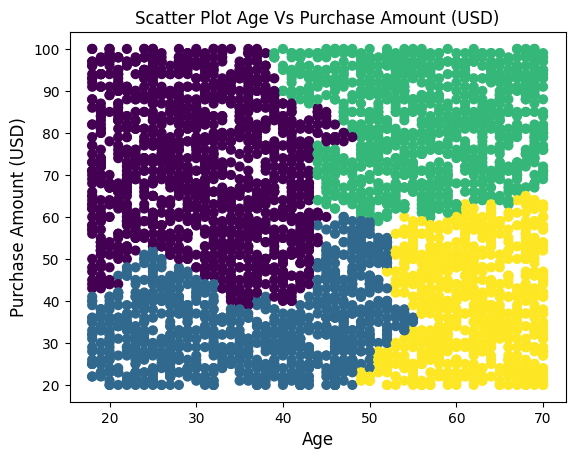

In [123]:
# Plot clusters
plt.scatter(X[X_column], X[y_column], c=y_pred_mm, s=40, cmap='viridis')
plt.title(f"Scatter Plot {X_column} Vs {y_column}")
plt.xlabel(X_column, fontsize=12)
plt.ylabel(y_column, fontsize=12)

plt.show()

In [124]:
ahc = pd.DataFrame(y_pred, columns=["AHC Cluster"])
ahc

,AHC Cluster
0,0
1,1
2,2
3,1
4,0
...,...
3895,3
3896,0
3897,3
3898,1


In [125]:
score = silhouette_score(X_scaled, y_pred)

new_row = {"Model": f"AHC {X_column} {y_column} SS", "Silhouette Score": score}
clus_score = pd.concat([clus_score, pd.DataFrame([new_row])], ignore_index=True)

clus_score.sort_values(by="Silhouette Score", ascending=False)

,Model,Silhouette Score
0,K-Means Age Purchase Amount (USD) SS,0.413719
1,K-Means Age Purchase Amount (USD) MM,0.413657
2,AHC Age Purchase Amount (USD) SS,0.372396


In [126]:
score = silhouette_score(X_scaled_mm, y_pred_mm)

new_row = {"Model": f"AHC {X_column} {y_column} MM", "Silhouette Score": score}
clus_score = pd.concat([clus_score, pd.DataFrame([new_row])], ignore_index=True)

clus_score.sort_values(by="Silhouette Score", ascending=False)

,Model,Silhouette Score
0,K-Means Age Purchase Amount (USD) SS,0.413719
1,K-Means Age Purchase Amount (USD) MM,0.413657
2,AHC Age Purchase Amount (USD) SS,0.372396
3,AHC Age Purchase Amount (USD) MM,0.350095


## Density Based Spatial Clustering of Applications with Noise (DBSCAN)

Tidak digunakan akibat persebaran data ini gak cocok dengan density based algorithm

In [490]:
# from sklearn.cluster import DBSCAN

In [491]:
# from sklearn.cluster import DBSCAN
# from sklearn.preprocessing import StandardScaler
# from sklearn.metrics import silhouette_score

# # Inisialisasi model DBSCAN
# DB = DBSCAN(eps=0.5, min_samples=5)

# # Melakukan prediksi klaster dengan DBSCAN
# y_pred_db = DB.fit_predict(X_scaled)

# # Menghitung Silhouette Score
# score_db = silhouette_score(X_scaled, y_pred_db)
# print(f"Silhouette Score: {score_db}")

In [492]:
# labels = DB.labels_

# n_clusters = len(set(labels)) - (1 if -1 in labels else 0)
# n_clusters

## Gaussian Mixture Model


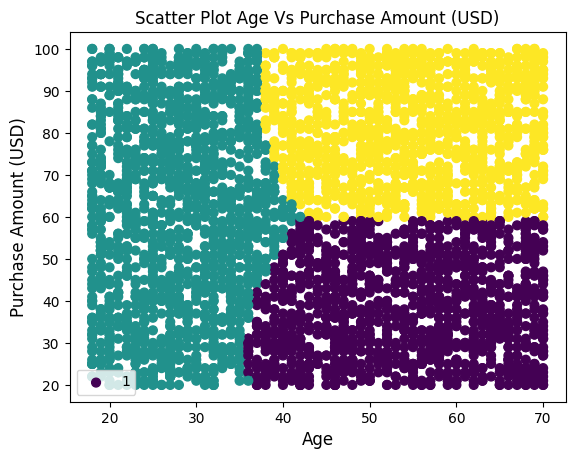

In [127]:
from sklearn.datasets import make_blobs
from sklearn.mixture import GaussianMixture

# Create an instance of Gaussian Mixture Model
gmm = GaussianMixture(n_components=3, random_state=42)

# Fit the model to the data
gmm.fit(X_scaled)

# Predict cluster labels
labels = gmm.predict(X_scaled)

# Plot clusters
plt.scatter(X[X_column], X[y_column], c=labels, s=40, cmap='viridis')
plt.title(f"Scatter Plot {X_column} Vs {y_column}")
plt.xlabel(X_column, fontsize=12)
plt.ylabel(y_column, fontsize=12)

plt.legend(y_km)
plt.show()

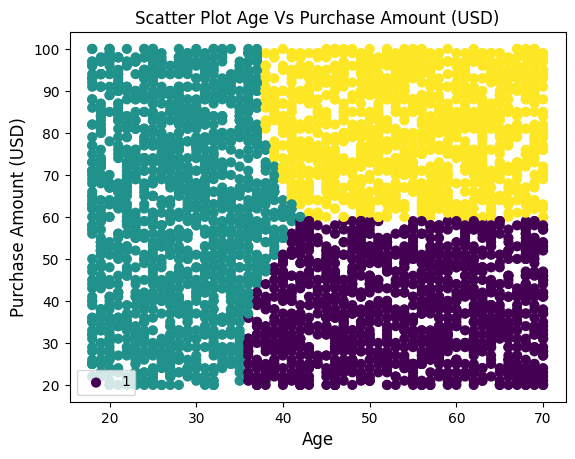

In [128]:
# Create an instance of Gaussian Mixture Model
gmm = GaussianMixture(n_components=3, random_state=42)

# Fit the model to the data
gmm.fit(X_scaled_mm)

# Predict cluster labels
labels_mm = gmm.predict(X_scaled_mm)

# Plot clusters
plt.scatter(X[X_column], X[y_column], c=labels_mm, s=40, cmap='viridis')
plt.title(f"Scatter Plot {X_column} Vs {y_column}")
plt.xlabel(X_column, fontsize=12)
plt.ylabel(y_column, fontsize=12)

plt.legend(y_km)
plt.show()

In [129]:
silhouette_avg = silhouette_score(X_scaled, labels)
print("Silhouette Score:", silhouette_avg)

Silhouette Score: 0.37705509043871194


In [130]:
silhouette_avg = silhouette_score(X_scaled_mm, labels_mm)
print("Silhouette Score:", silhouette_avg)

Silhouette Score: 0.37640444152690355


In [131]:
score = silhouette_score(X_scaled, labels)

new_row = {"Model": f"Gaussian {X_column} {y_column} SS 3 Cluster", "Silhouette Score": score}
clus_score = pd.concat([clus_score, pd.DataFrame([new_row])], ignore_index=True)

clus_score.sort_values(by="Silhouette Score", ascending=False)

,Model,Silhouette Score
0,K-Means Age Purchase Amount (USD) SS,0.413719
1,K-Means Age Purchase Amount (USD) MM,0.413657
4,Gaussian Age Purchase Amount (USD) SS 3 Cluster,0.377055
2,AHC Age Purchase Amount (USD) SS,0.372396
3,AHC Age Purchase Amount (USD) MM,0.350095


In [132]:
score = silhouette_score(X_scaled_mm, labels_mm)

new_row = {"Model": f"Gaussian {X_column} {y_column} MM 3 Cluster", "Silhouette Score": score}
clus_score = pd.concat([clus_score, pd.DataFrame([new_row])], ignore_index=True)

clus_score.sort_values(by="Silhouette Score", ascending=False)

,Model,Silhouette Score
0,K-Means Age Purchase Amount (USD) SS,0.413719
1,K-Means Age Purchase Amount (USD) MM,0.413657
4,Gaussian Age Purchase Amount (USD) SS 3 Cluster,0.377055
5,Gaussian Age Purchase Amount (USD) MM 3 Cluster,0.376404
2,AHC Age Purchase Amount (USD) SS,0.372396
3,AHC Age Purchase Amount (USD) MM,0.350095


In [133]:
gauss = pd.DataFrame(labels, columns=["Gaussian Cluster"])
gauss

,Gaussian Cluster
0,0
1,1
2,2
3,1
4,0
...,...
3895,0
3896,0
3897,0
3898,2


## Mean-Shift clustering algorithm

In [500]:
# from numpy import unique
# from numpy import where
# from matplotlib import pyplot
# from sklearn.datasets import make_classification
# from sklearn.cluster import MeanShift

# # define the model
# mean_model = MeanShift()

# # assign each data point to a cluster
# mean_result = mean_model.fit_predict(X_scaled)

# # get all of the unique clusters
# mean_clusters = unique(mean_result)

# # plot Mean-Shift the clusters
# for mean_cluster in mean_clusters:
#     # get data points that fall in this cluster
#     index = where(mean_result == mean_cluster)
#     # make the plot
#     pyplot.scatter(training_data[index, 0], training_data[index, 1])

# # show the Mean-Shift plot
# pyplot.show()

In [501]:
# from sklearn.metrics import silhouette_score

# # Menghitung Silhouette Score
# silhouette_avg = silhouette_score(training_data, mean_result)
# print("Silhouette Score:", silhouette_avg)

## K-Modes

Initialization method and algorithm are deterministic. Setting n_init to 1.
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 1, iteration: 1/100, moves: 707, cost: 39363.0
Run 1, iteration: 2/100, moves: 37, cost: 39363.0


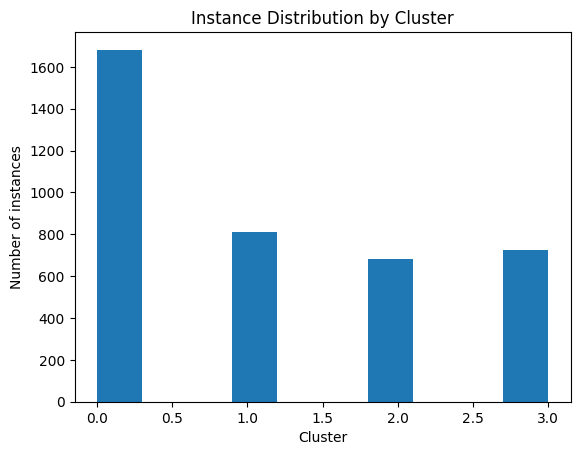

In [503]:
from kmodes.kmodes import KModes

# Misalkan data Anda disimpan dalam DataFrame `data`
km = KModes(n_clusters=4, init='Cao', verbose=1)  # inisialisasi model dengan 3 klaster
clusters = km.fit_predict(nan_encoding_data)

# Visualisasi hasil
# Jika Anda ingin melihat distribusi kelas di setiap klaster, Anda bisa melakukannya dengan membuat bar plot
import matplotlib.pyplot as plt

plt.hist(clusters)
plt.xlabel('Cluster')
plt.ylabel('Number of instances')
plt.title('Instance Distribution by Cluster')
plt.show()

In [504]:
# Hitung skor siluet
silhouette_avg = silhouette_score(nan_encoding_data, clusters, metric='hamming')

print("Silhouette Score:", silhouette_avg)

Silhouette Score: 0.030979090491432146


## K-Prototypes

In [506]:
from kmodes.kprototypes import KPrototypes
from sklearn.metrics import silhouette_score

Initialization method and algorithm are deterministic. Setting n_init to 1.
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run: 1, iteration: 1/20, moves: 837, ncost: 1902480.8828656254
Run: 1, iteration: 2/20, moves: 261, ncost: 1886279.2020490107
Run: 1, iteration: 3/20, moves: 142, ncost: 1881280.9710501523
Run: 1, iteration: 4/20, moves: 116, ncost: 1875868.9116759386
Run: 1, iteration: 5/20, moves: 181, ncost: 1859463.4345388082
Run: 1, iteration: 6/20, moves: 271, ncost: 1824479.1371974137
Run: 1, iteration: 7/20, moves: 271, ncost: 1796033.5683851328
Run: 1, iteration: 8/20, moves: 196, ncost: 1784780.042018289
Run: 1, iteration: 9/20, moves: 93, ncost: 1782024.275302097
Run: 1, iteration: 10/20, moves: 56, ncost: 1781361.7509253714
Run: 1, iteration: 11/20, moves: 27, ncost: 1781115.2149335989
Run: 1, iteration: 12/20, moves: 19, ncost: 1780991.5760516438
Run: 1, iteration: 13/20, moves: 11, ncost: 1780955.364739531
Run: 1, iteration: 14/20, mov

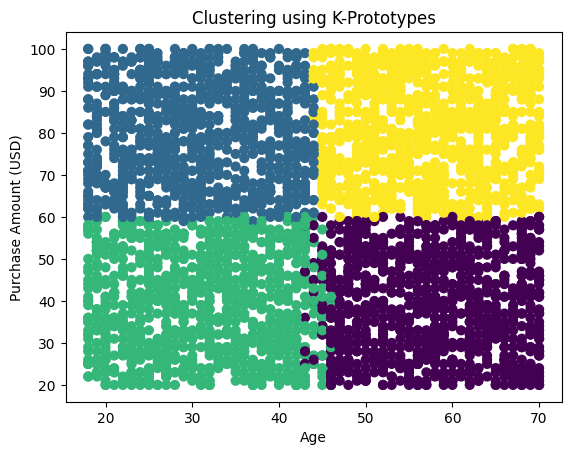

In [507]:
marketing_df = data.copy()

# Drop non-categorical columns
marketing_df = marketing_df.drop(['Customer ID', 'Item Purchased', 'Color', 'Location'], axis=1)
# marketing_df = X.copy

# Convert DataFrame to numpy array
mark_array = marketing_df.values

# Convert certain columns to float type
mark_array[:, 0] = mark_array[:, 0].astype(float)
mark_array[:, 3] = mark_array[:, 3].astype(float)
mark_array[:, 11] = mark_array[:, 11].astype(float)

# Perform clustering using K-Prototypes
kproto = KPrototypes(n_clusters=4, verbose=2, max_iter=20)
clusters = kproto.fit_predict(mark_array, categorical=[1, 2, 4, 5, 7, 8, 9, 10, 12, 13, 14, 15, 16])

# Print cluster centroids
print(kproto.cluster_centroids_)

# Assign clusters to dataframe
marketing_df['cluster'] = clusters

# Get cluster counts
cluster_counts = marketing_df["cluster"].value_counts()
print(cluster_counts)

# Plot clusters
plt.scatter(marketing_df["Age"], marketing_df["Purchase Amount (USD)"], c=marketing_df["cluster"], s=40, cmap='viridis')
plt.xlabel('Age')
plt.ylabel('Purchase Amount (USD)')
plt.title('Clustering using K-Prototypes')
plt.show()


In [508]:
# Calculate silhouette score
silhouette_avg = silhouette_score(nan_process_data, clusters)
print("Silhouette Score:", silhouette_avg)

Silhouette Score: 0.16147337178760213


In [509]:
# Calculate silhouette score
silhouette_avg = silhouette_score(nan_encoding_data, clusters)
print("Silhouette Score:", silhouette_avg)

Silhouette Score: 0.24309196129585744


In [510]:
# Calculate silhouette score
silhouette_avg = silhouette_score(processed_data, clusters)
print("Silhouette Score:", silhouette_avg)

Silhouette Score: 0.24801304993269205


## BIRCH (Balanced Iterative Reducing and Clustering using Hierarchies)

In [533]:
from sklearn.cluster import Birch
import numpy as np

# Sample data (replace this with your own data)
 # Generate random numerical data for demonstration

# Instantiate BIRCH clustering model
birch = Birch(n_clusters=4)  # Specify the number of clusters

# Fit the model to the data
birch.fit(X)

# Get cluster labels
labels = birch.labels_

# Print cluster labels
print("Cluster labels:", labels)

Cluster labels: [1 0 2 ... 3 2 2]


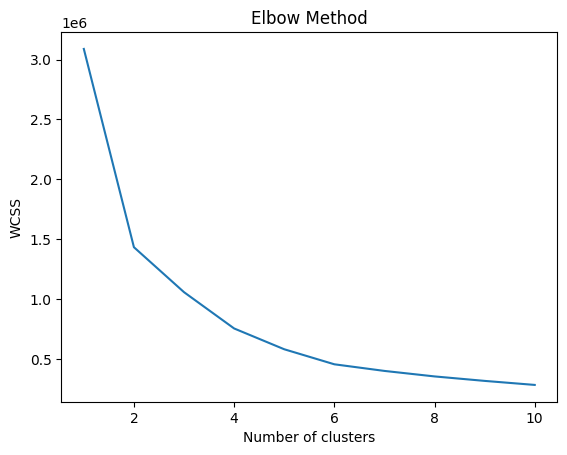

In [534]:
from sklearn.cluster import KMeans

features = processed_data[[X_column, y_column]]

wcss = []
for i in range(1, 11):
    kmeans = KMeans(n_clusters=i, init='k-means++', max_iter=500, n_init=10, random_state=0)
    kmeans.fit(features)
    wcss.append(kmeans.inertia_)

plt.plot(range(1, 11), wcss)
plt.title('Elbow Method')
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')
plt.show()

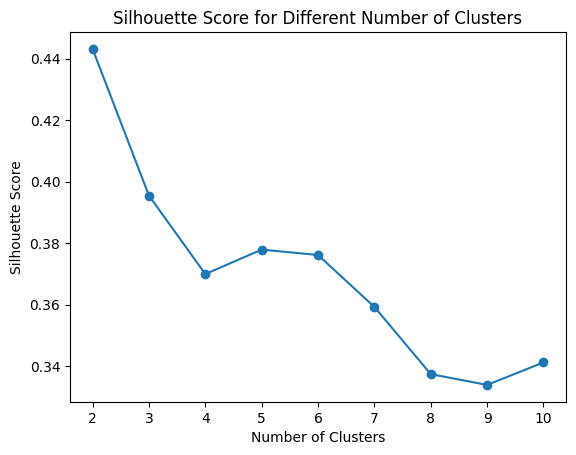

In [535]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt

# Ambil data yang ingin di-cluster
# X = processed_data  # Anda dapat menggunakan data yang sudah diproses sebelumnya

# Inisialisasi daftar untuk menyimpan nilai skor siluet
silhouette_scores = []

# Melakukan KMeans untuk jumlah klaster dari 2 hingga 10
for i in range(2, 11):
    kmeans = KMeans(n_clusters=i, init='k-means++', max_iter=300, n_init=10, random_state=0)
    clusters = kmeans.fit_predict(X)
    silhouette_avg = silhouette_score(X, clusters)
    silhouette_scores.append(silhouette_avg)

# Plot perubahan skor siluet
plt.plot(range(2, 11), silhouette_scores, marker='o')
plt.title('Silhouette Score for Different Number of Clusters')
plt.xlabel('Number of Clusters')
plt.ylabel('Silhouette Score')
plt.show()

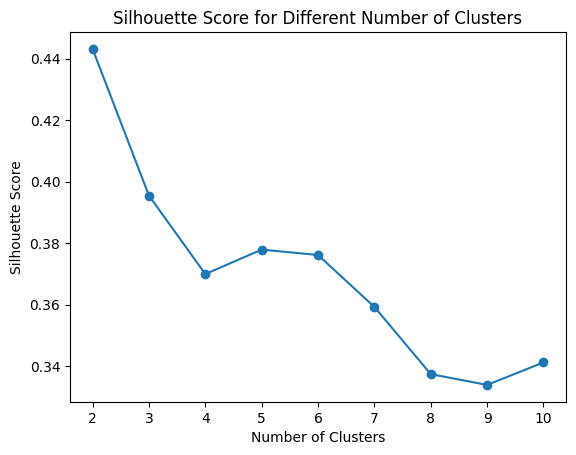

In [536]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt

# Ambil data yang ingin di-cluster
X = X  # Anda dapat menggunakan data yang sudah diproses sebelumnya

# Inisialisasi daftar untuk menyimpan nilai skor siluet
silhouette_scores = []

# Melakukan KMeans untuk jumlah klaster dari 2 hingga 10
for i in range(2, 11):
    kmeans = KMeans(n_clusters=i, init='k-means++', max_iter=300, n_init=10, random_state=0)
    clusters = kmeans.fit_predict(X)
    silhouette_avg = silhouette_score(X, clusters)
    silhouette_scores.append(silhouette_avg)

# Plot perubahan skor siluet
plt.plot(range(2, 11), silhouette_scores, marker='o')
plt.title('Silhouette Score for Different Number of Clusters')
plt.xlabel('Number of Clusters')
plt.ylabel('Silhouette Score')
plt.show()

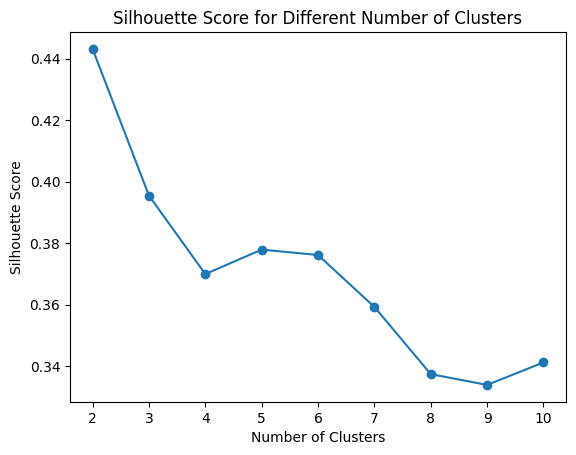

In [537]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt

# Ambil data yang ingin di-cluster
# X = nan_process_data # Anda dapat menggunakan data yang sudah diproses sebelumnya

# Inisialisasi daftar untuk menyimpan nilai skor siluet
silhouette_scores = []

# Melakukan KMeans untuk jumlah klaster dari 2 hingga 10
for i in range(2, 11):
    kmeans = KMeans(n_clusters=i, init='k-means++', max_iter=300, n_init=10, random_state=0)
    clusters = kmeans.fit_predict(X)
    silhouette_avg = silhouette_score(X, clusters)
    silhouette_scores.append(silhouette_avg)

# Plot perubahan skor siluet
plt.plot(range(2, 11), silhouette_scores, marker='o')
plt.title('Silhouette Score for Different Number of Clusters')
plt.xlabel('Number of Clusters')
plt.ylabel('Silhouette Score')
plt.show()

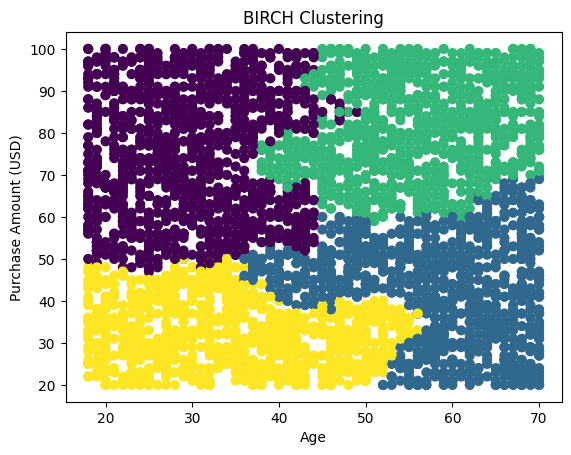

In [538]:
plt.scatter(processed_data['Age'], processed_data['Purchase Amount (USD)'], c=labels, cmap='viridis', s=40)
plt.xlabel('Age')
plt.ylabel('Purchase Amount (USD)')
plt.title('BIRCH Clustering')
plt.show()

In [539]:
silhouette_avg = silhouette_score(processed_data, labels)

print("Silhouette Score:", silhouette_avg)

Silhouette Score: 0.21814156997567088


## Evaluation

In [518]:
from sklearn import metrics

def evaluate_clustering(labels_pred, data):
    print("Silhouette Score:", metrics.silhouette_score(data, labels_pred))
    print("Davies-Bouldin Index:", metrics.davies_bouldin_score(data, labels_pred))
    print("Calinski-Harabasz Index:", metrics.calinski_harabasz_score(data, labels_pred))
    # print("Dunn Index:", metrics.dunn_index(data, labels_pred))

In [519]:
print("KMeans Clustering SS")
evaluate_clustering(y_km, X_scaled)

KMeans Clustering SS
Silhouette Score: 0.2757120090350988
Davies-Bouldin Index: 1.5130089121712342
Calinski-Harabasz Index: 1330.6677620610592


In [520]:
print("KMeans Clustering MM")
evaluate_clustering(y_km_mm, X_scaled_mm)

KMeans Clustering MM
Silhouette Score: 0.29190523364493004
Davies-Bouldin Index: 1.5278116864796494
Calinski-Harabasz Index: 1581.6984003660634


In [521]:
print("Agglomerative Clustering SS")
evaluate_clustering(y_pred, X_scaled)

Agglomerative Clustering SS
Silhouette Score: 0.27165476201896055
Davies-Bouldin Index: 1.54541731353338
Calinski-Harabasz Index: 1310.2794311479527


In [522]:
print("Agglomerative Clustering MM")
evaluate_clustering(y_pred_mm, X_scaled_mm)

Agglomerative Clustering MM
Silhouette Score: 0.295314515963383
Davies-Bouldin Index: 1.4593207214733266
Calinski-Harabasz Index: 1615.9645814274593


In [523]:
print("Gaussian Mixture Model SS")
evaluate_clustering(labels, X_scaled)

Gaussian Mixture Model SS
Silhouette Score: 0.09985798991513146
Davies-Bouldin Index: 2.210318895815127
Calinski-Harabasz Index: 587.7470171322084


In [524]:
print("Gaussian Mixture Model MM")
evaluate_clustering(labels_mm, X_scaled_mm)

Gaussian Mixture Model MM
Silhouette Score: 0.3600223596495711
Davies-Bouldin Index: 1.1691055607151097
Calinski-Harabasz Index: 1702.531315496501


# Visualization After

### Create File to Save

In [ ]:
figure = px.scatter_3d(processed_data,
                    color='clusters',
                    x="Age",
                    y="Purchase Amount (USD)",
                    z="Review Rating",
                    category_orders = {"clusters": ["0", "1", "2", "3"]}
                    )
figure.update_layout()
figure.show()

ValueError: Value of 'color' is not the name of a column in 'data_frame'. Expected one of ['Age', 'Gender', 'Category', 'Purchase Amount (USD)', 'Size', 'Season', 'Review Rating', 'Subscription Status', 'Shipping Type', 'Discount Applied', 'Promo Code Used', 'Previous Purchases', 'Payment Method', 'Annually', 'Bi-Weekly', 'Every 3 Months', 'Fortnightly', 'Monthly', 'Quarterly', 'Weekly', 'Far West', 'Great Lakes', 'Mideast', 'New England', 'Plains', 'Rocky Mountain', 'Southeast', 'Southwest', 'Adult', 'Elder', 'Middle_Age', 'Teenager', 'Young_Adult'] but received: clusters

In [ ]:
all_score = clus_score
all_score = all_score.sort_values(by="Silhouette Score", ascending=False)
all_score

,Model,Silhouette Score
10,(Nan Encoding Data) Gaussian Age Purchase Amou...,0.361019
11,(Nan Encoding Data) Gaussian Age Purchase Amou...,0.360399
6,(Nan Encoding Data) K-Means Age Purchase Amoun...,0.350848
7,(Nan Encoding Data) K-Means Age Purchase Amoun...,0.350477
8,(Nan Encoding Data) AHC Age Purchase Amount (U...,0.329177
9,(Nan Encoding Data) AHC Age Purchase Amount (U...,0.327325
5,Gaussian Age Purchase Amount (USD) MM,0.119157
1,K-Means Age Purchase Amount (USD) MM,0.118994
0,K-Means Age Purchase Amount (USD) SS,0.103666
4,Gaussian Age Purchase Amount (USD) SS,0.097904


In [ ]:
file_path = 'final2.xlsx'  # Tentukan lokasi dan nama file
all_score.to_excel(file_path, index=False)  # index=False untuk menghilangkan penulisan indeks baris

In [542]:
new_df = pd.concat([data, kmeans, ahc, gauss], axis=1)
new_df

TypeError: cannot concatenate object of type '<class 'sklearn.cluster._kmeans.KMeans'>'; only Series and DataFrame objs are valid

In [543]:
figure = px.scatter_3d(new_df,
                    color='KMeans Cluster',
                    x="Age",
                    y="Purchase Amount (USD)",
                    z="Review Rating",
                    category_orders = {"clusters": ["0", "1", "2", "3"]}
                    )
figure.update_layout()
figure.show()

NameError: name 'new_df' is not defined

In [ ]:
new_df["Age Group"] = le.fit_transform(new_df["Age Group"])
ayam = np.array(new_df["Age Group"])
ayam

array([2, 3, 2, ..., 2, 0, 2])

## Confusion Matrix fr some reason

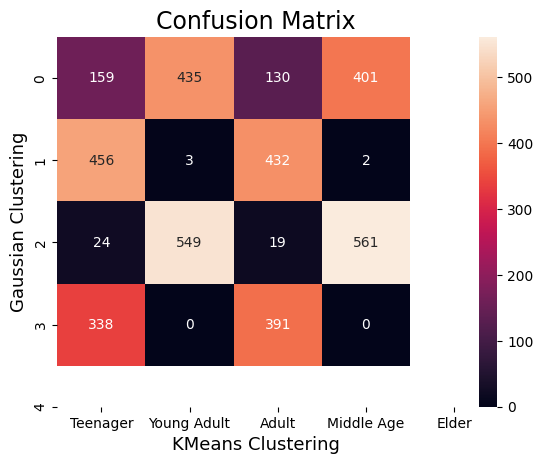

In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
import seaborn as sns

cm = confusion_matrix(y_pred, y_km)

sns.heatmap(cm,
            annot=True,
            fmt='g',
            xticklabels=['Teenager', 'Young Adult', 'Adult', 'Middle Age', 'Elder'],
            yticklabels=['0', '1', '2', '3', '4'])
plt.ylabel('Gaussian Clustering',fontsize=13)
plt.xlabel('KMeans Clustering',fontsize=13)
plt.title('Confusion Matrix',fontsize=17)
plt.show()

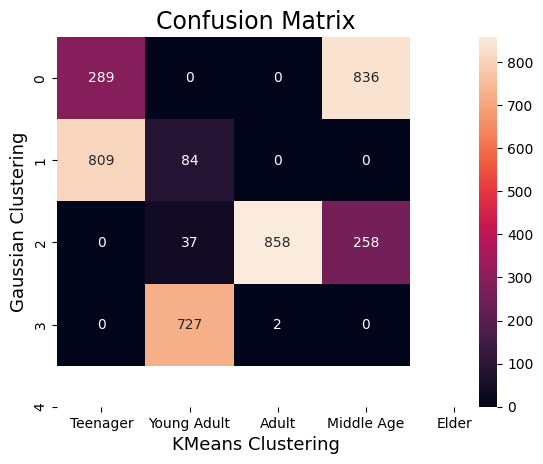

In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
import seaborn as sns

cm = confusion_matrix(y_pred, labels)

sns.heatmap(cm,
            annot=True,
            fmt='g',
            xticklabels=['Teenager', 'Young Adult', 'Adult', 'Middle Age', 'Elder'],
            yticklabels=['0', '1', '2', '3', '4'])
plt.ylabel('Gaussian Clustering',fontsize=13)
plt.xlabel('KMeans Clustering',fontsize=13)
plt.title('Confusion Matrix',fontsize=17)
plt.show()

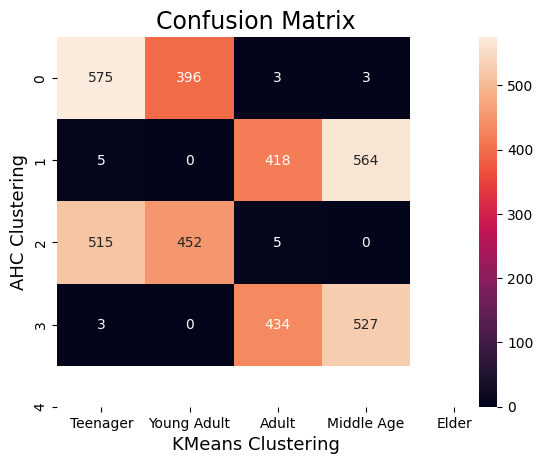

In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
import seaborn as sns

cm = confusion_matrix(y_km, labels)

sns.heatmap(cm,
            annot=True,
            fmt='g',
            xticklabels=['Teenager', 'Young Adult', 'Adult', 'Middle Age', 'Elder'],
            yticklabels=['0', '1', '2', '3', '4'])
plt.ylabel('AHC Clustering',fontsize=13)
plt.xlabel('KMeans Clustering',fontsize=13)
plt.title('Confusion Matrix',fontsize=17)
plt.show()

## PowerBI GO

In [ ]:
new_df = pd.concat([data, kmeans, ahc, gauss], axis=1)
new_df

In [ ]:
file_path = 'model1.xlsx'  # Tentukan lokasi dan nama file
new_df.to_excel(file_path, index=False)  # index=False untuk menghilangkan penulisan indeks baris

## Item Purchased, Region, Purchased Amout, Rating ETC

<ipython-input-1173-129ffd15b2d9>:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(new_df.corr(), annot=True);


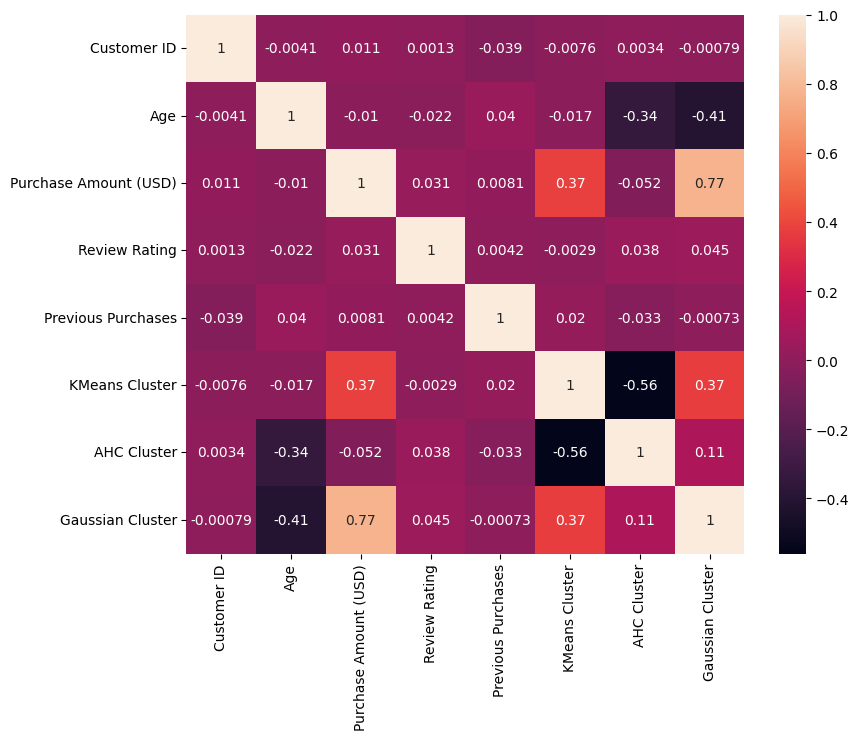

In [ ]:
plt.figure(figsize=(9,7))
sns.heatmap(new_df.corr(), annot=True);
plt.show()

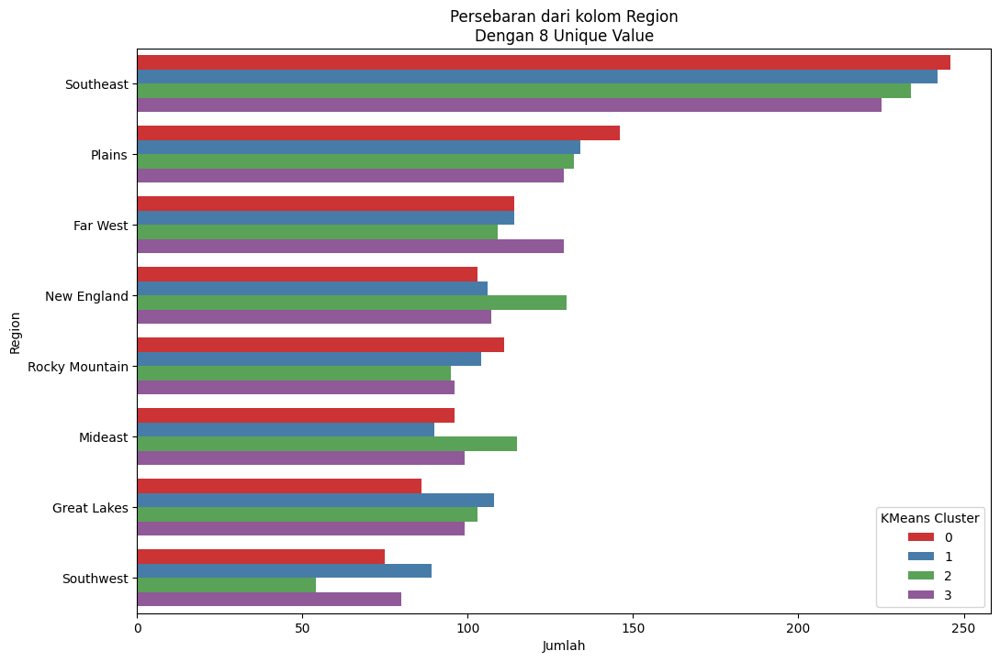

In [ ]:
column = "Region"

plt.figure(figsize=(12, 8))

# Sorting the data for the current column
sorted_data = new_df[column].value_counts().reset_index().rename(columns={'index': column, column: 'count'})
sorted_data = sorted_data.sort_values(by='count', ascending=False)

ax = sns.countplot(y=column, data=new_df, order=sorted_data[column], hue="KMeans Cluster", palette="Set1")

plt.title(f'Persebaran dari kolom {column}\nDengan {len(data[column].unique())} Unique Value')
plt.xlabel('Jumlah')
plt.ylabel(column)

plt.show()

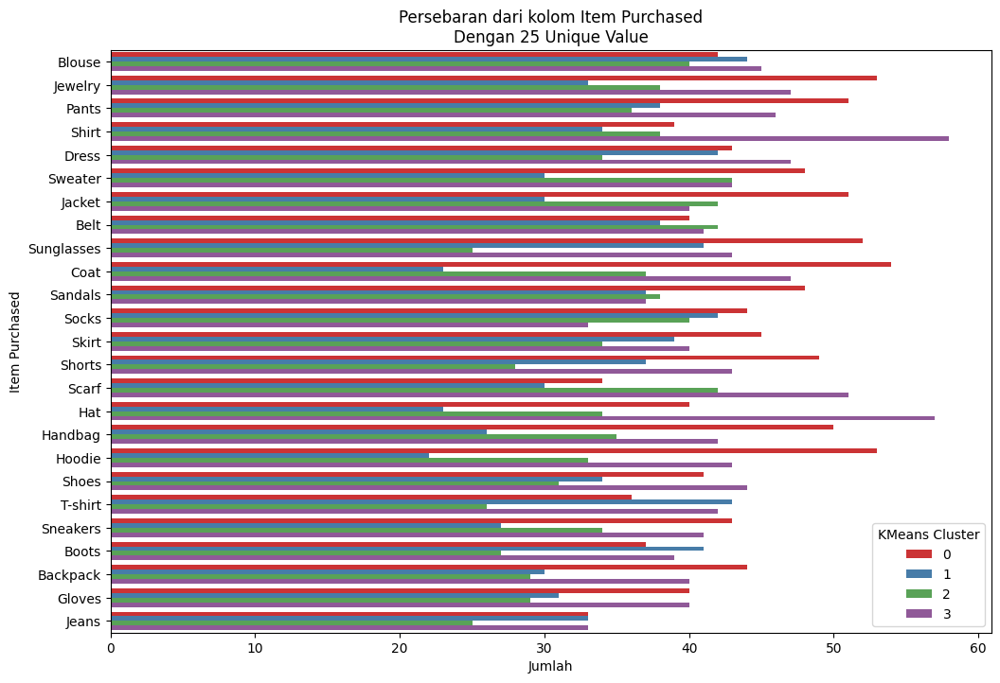

In [ ]:
column = "Item Purchased"

plt.figure(figsize=(12, 8))

# Sorting the data for the current column
sorted_data = new_df[column].value_counts().reset_index().rename(columns={'index': column, column: 'count'})
sorted_data = sorted_data.sort_values(by='count', ascending=False)

ax = sns.countplot(y=column, data=new_df, order=sorted_data[column], hue="KMeans Cluster", palette="Set1")

plt.title(f'Persebaran dari kolom {column}\nDengan {len(data[column].unique())} Unique Value')
plt.xlabel('Jumlah')
plt.ylabel(column)

plt.show()

KeyboardInterrupt: 

<Figure size 2000x800 with 0 Axes>

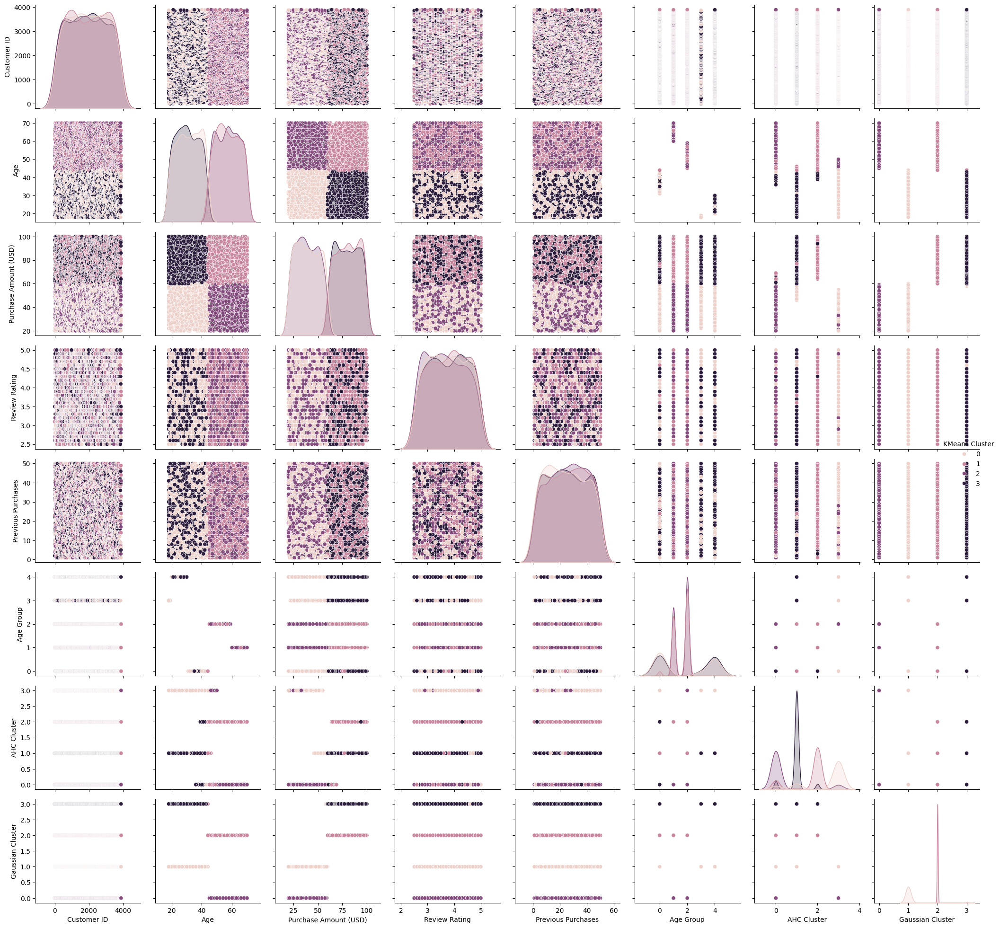

In [ ]:
for column in ["KMeans Cluster", "AHC Cluster", "Gaussian Cluster"]:
  plt.figure(figsize=(20,8))
  sns.pairplot(new_df, hue=column, diag_kind="kde")
  plt.show()